There is a lot more that you can do with outputs (such as including interactive outputs)
with your book. For more information about this, see [the Jupyter Book documentation](https://jupyterbook.org)

## Análisis Exploratorio de Datos - EDA

Para iniciar con nuestro estudio es importante identificar con que tipo de datos se trabajara.
Recordemos que los datos se pueden clasificar de la siguiente manera: 
 
*Datos transversales

*Datos de series temporales

*Datos de Panel

Para el estudio que se realizara se trabajara con datos de series temporales. 
Los datos de series temporales son aquellos que se registran en intervalos de tiempo específicos, como el precio de Bitcoin en este caso, que se mide a lo largo de diferentes días. Aquí las observaciones se hacen en momentos distintos, y el orden de los datos en el tiempo es crucial para el análisis.

Como recorderis:
*Datos transversales: Recogen información en un solo punto en el tiempo de múltiples individuos u observaciones. Por ejemplo, el ingreso de varias personas en un día específico.

*Datos de panel: Combinan características tanto de datos transversales como de series temporales. Se recogen observaciones para varios individuos (o entidades) a lo largo del tiempo.
Dado que estamos viendo cómo cambia el precio de Bitcoin a lo largo de varios días, estamos claramente en el contexto de una serie temporal.



In [1]:
import pandas as pd


# URL del dataset
url = "https://raw.githubusercontent.com/lihkir/Data/refs/heads/main/Bitcoin%20Historical%20Data.csv"
data = pd.read_csv(url)
data.head(20)



,Date,Price,Open,High,Low,Vol.,Change %
0,03/24/2024,"67,211.9","64,036.5","67,587.8","63,812.9",65.59K,4.96%
1,03/23/2024,"64,037.8","63,785.6","65,972.4","63,074.9",35.11K,0.40%
2,03/22/2024,"63,785.5","65,501.5","66,633.3","62,328.3",72.43K,-2.62%
3,03/21/2024,"65,503.8","67,860.0","68,161.7","64,616.1",75.26K,-3.46%
4,03/20/2024,"67,854.0","62,046.8","68,029.5","60,850.9",133.53K,9.35%
5,03/19/2024,"62,050.0","67,594.1","68,099.6","61,560.6",148.08K,-8.20%
6,03/18/2024,"67,594.1","68,389.7","68,920.1","66,601.4",78.07K,-1.17%
7,03/17/2024,"68,391.2","65,314.2","68,857.7","64,605.5",66.07K,4.71%
8,03/16/2024,"65,314.2","69,456.5","70,037.0","64,971.0",75.82K,-5.97%
9,03/15/2024,"69,463.7","71,387.1","72,398.1","65,765.6",148.59K,-2.69%


### Variables del conjunto de datos:

Date: Fechas de los datos.

Price: Precio de cierre.

Open: Precio de apertura.

High: Precio máximo alcanzado.

Low: Precio mínimo alcanzado.

Vol.: Volumen de transacciones.

Change %: Cambio porcentual en el precio respecto al día anterior.

In [2]:
print('No. of rows, columns:', data.shape)

No. of rows, columns: (4999, 7)


In [3]:
data.dtypes

Date        object
Price       object
Open        object
High        object
Low         object
Vol.        object
Change %    object
dtype: object

El tipo de datos (dtype) de cada columna que se indica como object en tu dataset sugiere que los valores en estas columnas están siendo tratados como cadenas de texto (strings) en lugar de su tipo de datos numérico o temporal correspondiente. 
Se realizara la siguiente accion para transformar nuestros datos:

Convertir la columna Date al formato datetime.

Convertir las columnas Price, Open, High, Low y Change % a formato numérico (float).

Limpiar la columna Vol. para convertir las notaciones como 'K' a su valor numérico y luego transformarla en float.

In [4]:
# Convertir la columna 'Date' al formato datetime
data['Date'] = pd.to_datetime(data['Date'], format='%m/%d/%Y')

# Solo aplicamos el reemplazo si las columnas son de tipo 'object'
for col in ['Price', 'Open', 'High', 'Low']:
    if data[col].dtype == 'object':
        data[col] = data[col].str.replace(',', '').astype(float)

# Solo si la columna 'Change %' es tipo 'object', removemos el símbolo '%' y convertimos a float
if data['Change %'].dtype == 'object':
    data['Change %'] = data['Change %'].str.replace('%', '').astype(float)

# Para la columna 'Vol.', aplicamos las conversiones si el valor es de tipo string
def convert_volume(value):
    if isinstance(value, str):
        if 'K' in value:
            return float(value.replace('K', '').replace(',', '')) * 1000
        elif 'M' in value:
            return float(value.replace('M', '').replace(',', '')) * 1000000
        elif 'B' in value:
            return float(value.replace('B', '').replace(',', '')) * 1000000000
        else:
            return float(value.replace(',', ''))
    else:
        return value

# Aplicamos la conversión a la columna 'Vol.'
data['Vol.'] = data['Vol.'].apply(convert_volume)

# Verificamos los tipos de datos después de la conversión
data.dtypes


Date        datetime64[ns]
Price              float64
Open               float64
High               float64
Low                float64
Vol.               float64
Change %           float64
dtype: object

La conversión de los datos se ha realizado con éxito, y ahora todas las columnas tienen los tipos de datos correctos:

Date: datetime64

Price, Open, High, Low, Vol., Change %: float64

Esto permitirá realizar cálculos y análisis sin problemas en cada una de las columnas

### Estadistica descriptiva de nuestra serie 

In [5]:
import plotly.graph_objects as go
import pandas as pd


# Generar estadísticas descriptivas
stats_all_columns = data.describe()

# Redondear los valores estadísticos a 2 decimales
stats_rounded = stats_all_columns.round(2)

# Crear la tabla de estadísticas con los valores generados
header_values = ['Statistic', 'Price', 'Open', 'High', 'Low', 'Vol.', 'Change %']
stat_values = [
    ['Count', 'Mean', 'Std', 'Min', '25%', '50%', '75%', 'Max'],
    stats_rounded['Price'].tolist(),
    stats_rounded['Open'].tolist(),
    stats_rounded['High'].tolist(),
    stats_rounded['Low'].tolist(),
    stats_rounded['Vol.'].tolist(),
    stats_rounded['Change %'].tolist()
]

# Crear la figura de la tabla usando Plotly
table = go.Figure(data=[go.Table(
    header=dict(values=header_values, fill_color='paleturquoise', align='center'),
    cells=dict(values=stat_values, fill_color='lavender', align='center')
)])

# Mostrar la tabla
table.show()



ModuleNotFoundError: No module named 'plotly'

### Validacion de datos faltantes

In [6]:
# Validación de datos faltantes en el dataset
missing_data = data.isnull().sum()
print(missing_data)


Date        0
Price       0
Open        0
High        0
Low         0
Vol.        6
Change %    0
dtype: int64


### Imputacion de datos faltantes 

Se puede identificar que tenemos 6 datos faltantes en la columna de volumen y por lo tanto completaremos nuesta serie a traves de la tecnica vista en clase, interpolacion cuadratica.

La interpolación cuadrática es una técnica que utiliza una función cuadrática (polinomio de segundo grado) para estimar valores faltantes en una serie de datos. Este método ajusta una curva a los puntos de datos conocidos alrededor de los valores faltantes, lo que permite estimar el valor faltante de manera suave y continua, basándose en los valores anteriores y posteriores al faltante.

In [7]:
# Imputamos los valores faltantes usando interpolación cuadrática
data['Vol.'] = data['Vol.'].interpolate(method='quadratic')
missing_data_after_interpolation = data.isnull().sum()
print(missing_data_after_interpolation)


Date        0
Price       0
Open        0
High        0
Low         0
Vol.        0
Change %    0
dtype: int64


En el contexto del volumen de transacciones de Bitcoin, los datos no suelen variar de manera lineal, ya que los volúmenes de transacciones suelen ser volátiles y a menudo experimentan subidas y bajadas significativas en períodos cortos de tiempo. Por lo tanto, usar una interpolación cuadrática para llenar los valores faltantes es una buena elección, ya que:

Captura la volatilidad: El volumen de transacciones de Bitcoin es muy variable. La interpolación cuadrática puede captar estos cambios mejor.

Preserva la tendencia: Al respetar los puntos de datos antes y después del valor faltante, mantiene las tendencias subyacentes de los datos.

### Grafica Serie de tiempo

#### Serie de tiempo para columna "Price" 

In [8]:
import plotly.graph_objs as go

# Crear un gráfico de la serie temporal del Precio de Bitcoin
fig = go.Figure()

# Añadir el trazo del precio
fig.add_trace(go.Scatter(x=data['Date'], y=data['Price'], mode='lines', name='Precio de Bitcoin'))

# Actualizar el diseño del gráfico
fig.update_layout(
    title="Precio de Bitcoin",
    xaxis_title="Fecha",
    yaxis_title="Precio de Bitcoin (USD)",
    height=600,
    width=1000
)

# Mostrar la gráfica
fig.show()


La gráfica te ofrece una vista histórica del comportamiento del precio de Bitcoin. Dada su volatilidad, los picos y valles pronunciados que se ven en la serie son indicativos de la naturaleza especulativa del Bitcoin.

In [9]:
import plotly.graph_objs as go
import pandas as pd

# Cargar los datos desde el archivo CSV
url = "https://raw.githubusercontent.com/lihkir/Data/refs/heads/main/Bitcoin%20Historical%20Data.csv"
data = pd.read_csv(url)

# Convertir la columna 'Date' al formato datetime
data['Date'] = pd.to_datetime(data['Date'], format='%m/%d/%Y')

# Crear gráfico de velas para la columna Price
candlestick = go.Candlestick(x=data['Date'],
                             open=data['Open'],
                             high=data['High'],
                             low=data['Low'],
                             close=data['Price'],
                             name='Precio de Bitcoin')

# Crear gráfico de velas usando Plotly
fig_candlestick = go.Figure(data=[candlestick])

# Actualizar layout del gráfico de velas
fig_candlestick.update_layout(
    title="Gráfico de Velas del Precio de Bitcoin",
    xaxis_title="Fecha",
    yaxis_title="Precio de Bitcoin (USD)",
    height=600,
    width=1000
)

# Crear histograma para la columna 'Vol.' (volumen de transacciones)
fig_histogram = go.Figure()

# Añadir histograma
fig_histogram.add_trace(go.Histogram(x=data['Vol.'], nbinsx=50, name="Volumen Tradeado Diario"))

# Actualizar layout del histograma
fig_histogram.update_layout(
    title="Histograma del Volumen de Transacciones Diarias de Bitcoin",
    xaxis_title="Volumen Tradeado",
    yaxis_title="Frecuencia",
    height=600,
    width=1000
)

# Mostrar las gráficas
fig_candlestick.show()
fig_histogram.show()


El gráfico de velas muestra la evolución del precio de Bitcoin utilizando datos de apertura, máximo, mínimo y cierre, lo que es útil para análisis financieros.

El histograma Muestra la distribución del volumen de transacciones diarias, permitiendo identificar patrones en la frecuencia de las transacciones.

Hasta ahora, no se observan patrones de estacionalidad evidentes en los gráficos de series de tiempo y boxplots del precio de Bitcoin. El comportamiento del mercado parece estar más influenciado por factores externos (especulación, demanda, regulación) que por factores estacionales regulares. Esto es consistente con un activo que ha sido extremadamente volátil y que ha pasado por fases de adopción y correcciones bruscas, características típicas de mercados emergentes.

### Graficos de subseries

#### Trimestral

In [10]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go

# Asegurarse de que 'Price' sea numérico, eliminando comas o caracteres no numéricos si es necesario
data['Price'] = pd.to_numeric(data['Price'].str.replace(',', ''), errors='coerce')

# Verificar si hay valores nulos en la columna 'Price'
print(f"Valores nulos en 'Price': {data['Price'].isnull().sum()}")

# Eliminar las filas con valores nulos en 'Price'
data = data.dropna(subset=['Price'])

# Convertir la columna 'Date' al formato datetime
data['Date'] = pd.to_datetime(data['Date'], format='%m/%d/%Y')

# Extraer el mes de la columna 'Date'
data['Month'] = data['Date'].dt.month

# Mapeo de meses a trimestres
month_quarter_map = {1: 'Q1', 2: 'Q1', 3: 'Q1',
                     4: 'Q2', 5: 'Q2', 6: 'Q2',
                     7: 'Q3', 8: 'Q3', 9: 'Q3',
                     10: 'Q4', 11: 'Q4', 12: 'Q4'}

# Mapear los meses a los trimestres usando el diccionario
data['Quarter'] = data['Month'].map(lambda m: month_quarter_map.get(m))

# Extraer el año
data['Year'] = data['Date'].dt.year

# Agrupar por Year y Quarter y calcular la media y la desviación estándar del precio
seasonal_sub_series_data = data.groupby(by=['Year', 'Quarter'])['Price'].aggregate([np.mean, np.std])

# Renombrar las columnas
seasonal_sub_series_data.columns = ['Quarterly Mean', 'Quarterly Standard Deviation']

# Crear un índice combinado de Year y Quarter
seasonal_sub_series_data.reset_index(inplace=True)
seasonal_sub_series_data['Year-Quarter'] = seasonal_sub_series_data['Year'].astype(str) + '-' + seasonal_sub_series_data['Quarter']

# Crear el gráfico de la media trimestral con Plotly
fig_mean = go.Figure()

# Agregar la línea de la media trimestral
fig_mean.add_trace(go.Scatter(
    x=seasonal_sub_series_data['Year-Quarter'],
    y=seasonal_sub_series_data['Quarterly Mean'],
    mode='lines',
    name='Quarterly Mean',
    line=dict(color='blue')
))

# Personalizar el diseño para la media trimestral
fig_mean.update_layout(
    title='Media Trimestral del Precio de Bitcoin (hasta 2024)',
    xaxis_title='Tiempo (Año-Trimestre)',
    yaxis_title='Precio de Bitcoin (USD)',
    xaxis=dict(tickangle=-45),
    height=600,
    width=1000,
    template="plotly_white"
)

# Mostrar el gráfico de la media
fig_mean.show()

# Crear el gráfico de la desviación estándar trimestral con Plotly
fig_std = go.Figure()

# Agregar la línea de la desviación estándar trimestral
fig_std.add_trace(go.Scatter(
    x=seasonal_sub_series_data['Year-Quarter'],
    y=seasonal_sub_series_data['Quarterly Standard Deviation'],
    mode='lines',
    name='Quarterly Standard Deviation',
    line=dict(color='red')
))

# Personalizar el diseño para la desviación estándar trimestral
fig_std.update_layout(
    title='Desviación Estándar Trimestral del Precio de Bitcoin (hasta 2024)',
    xaxis_title='Tiempo (Año-Trimestre)',
    yaxis_title='Desviación Estándar del Precio de Bitcoin (USD)',
    xaxis=dict(tickangle=-45),
    height=600,
    width=1000,
    template="plotly_white"
)

# Mostrar el gráfico de la desviación estándar
fig_std.show()



Valores nulos en 'Price': 0


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3037230570.py:33: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3037230570.py:33: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



In [11]:
import plotly.express as px

# Convertir la columna 'Date' al formato datetime si no lo está
data['Date'] = pd.to_datetime(data['Date'], format='%m/%d/%Y')

# Extraer el mes y el trimestre
data['Month'] = data['Date'].dt.month
month_quarter_map = {1: 'Q1', 2: 'Q1', 3: 'Q1',
                     4: 'Q2', 5: 'Q2', 6: 'Q2',
                     7: 'Q3', 8: 'Q3', 9: 'Q3',
                     10: 'Q4', 11: 'Q4', 12: 'Q4'}
data['Quarter'] = data['Month'].map(lambda m: month_quarter_map.get(m))

# Extraer el año
data['Year'] = data['Date'].dt.year

# Crear un gráfico de boxplots múltiples utilizando Plotly Express
fig = px.box(data, x='Quarter', y='Price', 
             title='Boxplots Trimestrales del Precio de Bitcoin',
             labels={'Price': 'Precio de Bitcoin (USD)', 'Quarter': 'Trimestre'})

# Mostrar el gráfico
fig.show()


#### Semanal

In [12]:
import plotly.express as px

# Convertir la columna 'Date' al formato datetime si no lo está
data['Date'] = pd.to_datetime(data['Date'], format='%m/%d/%Y')

# Extraer la semana del año (número de semana) y el año
data['Week'] = data['Date'].dt.isocalendar().week
data['Year'] = data['Date'].dt.year

# Agrupar los datos por semana y año
data['Year-Week'] = data['Year'].astype(str) + '-W' + data['Week'].astype(str)

# Crear un gráfico de boxplots semanales utilizando Plotly Express
fig = px.box(data, x='Year-Week', y='Price', 
             title='Boxplots Semanales del Precio de Bitcoin',
             labels={'Price': 'Precio de Bitcoin (USD)', 'Year-Week': 'Semana del Año'},
             )

# Mejorar la legibilidad del eje X, invirtiendo el orden de menor a mayor
fig.update_layout(
    xaxis_title='Semana del Año',
    yaxis_title='Precio de Bitcoin (USD)',
    xaxis=dict(tickangle=-45, tickvals=data['Year-Week'][::50], autorange="reversed"),  # Mostrar cada 50 semanas y autorange invertido
    yaxis=dict(type='log'),  # Aplicar escala logarítmica para mejorar la visualización
    height=600,
    width=1000,
    template="plotly_white"
)

# Mostrar el gráfico
fig.show()


In [13]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Convertir la columna 'Date' al formato datetime
data['Date'] = pd.to_datetime(data['Date'], format='%m/%d/%Y')

# Extraer la semana del año y el año
data['Week'] = data['Date'].dt.isocalendar().week
data['Year'] = data['Date'].dt.year

# Agrupar por Year y Week y calcular la media y la desviación estándar del precio
seasonal_sub_series_data = data.groupby(by=['Year', 'Week'])['Price'].aggregate([np.mean, np.std])

# Renombrar las columnas
seasonal_sub_series_data.columns = ['Weekly Mean', 'Weekly Standard Deviation']

# Crear un índice combinado de Year y Week para facilitar la visualización
seasonal_sub_series_data.reset_index(inplace=True)
seasonal_sub_series_data['Year-Week'] = seasonal_sub_series_data['Year'].astype(str) + '-W' + seasonal_sub_series_data['Week'].astype(str)

# Crear el gráfico para la media semanal usando Plotly
fig_mean = go.Figure()

# Agregar la línea de la media semanal
fig_mean.add_trace(go.Scatter(
    x=seasonal_sub_series_data['Year-Week'],
    y=seasonal_sub_series_data['Weekly Mean'],
    mode='lines',
    name='Weekly Mean',
    line=dict(color='blue')
))

# Personalizar el gráfico para la media semanal
fig_mean.update_layout(
    title='Media Semanal del Precio de Bitcoin',
    xaxis_title='Semana del Año',
    yaxis_title='Precio de Bitcoin (USD)',
    xaxis=dict(tickangle=-45, tickvals=seasonal_sub_series_data['Year-Week'][::50]),
    height=600,
    width=1000,
    template="plotly_white"
)

# Mostrar el gráfico de la media semanal
fig_mean.show()

# Crear el gráfico para la desviación estándar semanal usando Plotly
fig_std = go.Figure()

# Agregar la línea de la desviación estándar semanal
fig_std.add_trace(go.Scatter(
    x=seasonal_sub_series_data['Year-Week'],
    y=seasonal_sub_series_data['Weekly Standard Deviation'],
    mode='lines',
    name='Weekly Standard Deviation',
    line=dict(color='red')
))

# Personalizar el gráfico para la desviación estándar semanal
fig_std.update_layout(
    title='Desviación Estándar Semanal del Precio de Bitcoin',
    xaxis_title='Semana del Año',
    yaxis_title='Desviación Estándar del Precio de Bitcoin (USD)',
    xaxis=dict(tickangle=-45, tickvals=seasonal_sub_series_data['Year-Week'][::50]),
    height=600,
    width=1000,
    template="plotly_white"
)

# Mostrar el gráfico de la desviación estándar semanal
fig_std.show()


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\143671187.py:14: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\143671187.py:14: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



#### Mensual

In [14]:

import pandas as pd
import numpy as np
import plotly.graph_objs as go
import plotly.express as px

# Convertir la columna 'Date' al formato datetime
data['Date'] = pd.to_datetime(data['Date'], format='%m/%d/%Y')

# Verificar si 'Price' es numérico, y si no lo es, convertirlo
if not pd.api.types.is_numeric_dtype(data['Price']):
    data['Price'] = pd.to_numeric(data['Price'], errors='coerce')

# Eliminar las filas con valores nulos en 'Price'
data = data.dropna(subset=['Price'])

# Extraer el mes y el año de la columna 'Date'
data['Month'] = data['Date'].dt.month
data['Year'] = data['Date'].dt.year

# Agrupar por Year y Month y calcular la media y la desviación estándar del precio
monthly_data = data.groupby(by=['Year', 'Month'])['Price'].aggregate([np.mean, np.std])

# Renombrar las columnas
monthly_data.columns = ['Monthly Mean', 'Monthly Standard Deviation']

# Crear un índice combinado de Year y Month
monthly_data.reset_index(inplace=True)
monthly_data['Year-Month'] = monthly_data['Year'].astype(str) + '-' + monthly_data['Month'].astype(str).str.zfill(2)

### Gráfico 1: Media mensual

fig_mean = go.Figure()

# Agregar la línea de la media mensual
fig_mean.add_trace(go.Scatter(
    x=monthly_data['Year-Month'],
    y=monthly_data['Monthly Mean'],
    mode='lines',
    name='Monthly Mean',
    line=dict(color='blue')
))

# Personalizar el gráfico para la media mensual
fig_mean.update_layout(
    title='Media Mensual del Precio de Bitcoin',
    xaxis_title='Mes (Año-Mes)',
    yaxis_title='Precio de Bitcoin (USD)',
    xaxis=dict(tickangle=-45),
    height=600,
    width=1000,
    template="plotly_white"
)

# Mostrar el gráfico de la media mensual
fig_mean.show()

### Gráfico 2: Desviación estándar mensual

fig_std = go.Figure()

# Agregar la línea de la desviación estándar mensual
fig_std.add_trace(go.Scatter(
    x=monthly_data['Year-Month'],
    y=monthly_data['Monthly Standard Deviation'],
    mode='lines',
    name='Monthly Standard Deviation',
    line=dict(color='red')
))

# Personalizar el gráfico para la desviación estándar mensual
fig_std.update_layout(
    title='Desviación Estándar Mensual del Precio de Bitcoin',
    xaxis_title='Mes (Año-Mes)',
    yaxis_title='Desviación Estándar del Precio de Bitcoin (USD)',
    xaxis=dict(tickangle=-45),
    height=600,
    width=1000,
    template="plotly_white"
)

# Mostrar el gráfico de la desviación estándar mensual
fig_std.show()

### Gráfico 3: Boxplots mensuales

# Crear un gráfico de boxplots mensuales utilizando Plotly Express
fig_boxplot = px.box(data, x='Month', y='Price', 
                     title='Boxplot Mensual del Precio de Bitcoin',
                     labels={'Price': 'Precio de Bitcoin (USD)', 'Month': 'Mes'},
                     )

# Personalizar el diseño del boxplot mensual
fig_boxplot.update_layout(
    xaxis_title='Mes',
    yaxis_title='Precio de Bitcoin (USD)',
    xaxis=dict(tickangle=-45),
    height=600,
    width=1000,
    template="plotly_white"
)

# Mostrar el gráfico del boxplot mensual
fig_boxplot.show()


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3952248715.py:21: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3952248715.py:21: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



#### Anual

In [15]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
import plotly.express as px

# Convertir la columna 'Date' al formato datetime si no lo está
data['Date'] = pd.to_datetime(data['Date'], format='%m/%d/%Y')

# Asegurarse de que 'Price' sea numérico
if not pd.api.types.is_numeric_dtype(data['Price']):
    data['Price'] = pd.to_numeric(data['Price'], errors='coerce')

# Eliminar las filas con valores nulos en 'Price'
data = data.dropna(subset=['Price'])

# Extraer el año de la columna 'Date'
data['Year'] = data['Date'].dt.year

# Agrupar por Year y calcular la media y la desviación estándar del precio
annual_data = data.groupby(by=['Year'])['Price'].aggregate([np.mean, np.std])

# Renombrar las columnas
annual_data.columns = ['Annual Mean', 'Annual Standard Deviation']

# Crear un índice de Year para facilitar la visualización
annual_data.reset_index(inplace=True)

### Gráfico 1: Media Anual

fig_mean = go.Figure()

# Agregar la línea de la media anual
fig_mean.add_trace(go.Scatter(
    x=annual_data['Year'],
    y=annual_data['Annual Mean'],
    mode='lines',
    name='Annual Mean',
    line=dict(color='blue')
))

# Personalizar el gráfico para la media anual
fig_mean.update_layout(
    title='Media Anual del Precio de Bitcoin',
    xaxis_title='Año',
    yaxis_title='Precio de Bitcoin (USD)',
    height=600,
    width=1000,
    template="plotly_white"
)

# Mostrar el gráfico de la media anual
fig_mean.show()

### Gráfico 2: Desviación Estándar Anual

fig_std = go.Figure()

# Agregar la línea de la desviación estándar anual
fig_std.add_trace(go.Scatter(
    x=annual_data['Year'],
    y=annual_data['Annual Standard Deviation'],
    mode='lines',
    name='Annual Standard Deviation',
    line=dict(color='red')
))

# Personalizar el gráfico para la desviación estándar anual
fig_std.update_layout(
    title='Desviación Estándar Anual del Precio de Bitcoin',
    xaxis_title='Año',
    yaxis_title='Desviación Estándar del Precio de Bitcoin (USD)',
    height=600,
    width=1000,
    template="plotly_white"
)

# Mostrar el gráfico de la desviación estándar anual
fig_std.show()

### Gráfico 3: Boxplots Anuales

# Crear un gráfico de boxplots anuales utilizando Plotly Express
fig_boxplot = px.box(data, x='Year', y='Price', 
                     title='Boxplot Anual del Precio de Bitcoin',
                     labels={'Price': 'Precio de Bitcoin (USD)', 'Year': 'Año'},
                     )

# Personalizar el diseño del boxplot anual
fig_boxplot.update_layout(
    xaxis_title='Año',
    yaxis_title='Precio de Bitcoin (USD)',
    height=600,
    width=1000,
    template="plotly_white"
)

# Mostrar el gráfico del boxplot anual
fig_boxplot.show()


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3839645131.py:20: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3839645131.py:20: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



### Estudio de Estacionalidad 

#### AFC

In [16]:

import pandas as pd
import numpy as np
import plotly.graph_objs as go
from statsmodels.tsa.stattools import acf

# Asegurarse de que 'Price' sea numérico
if not pd.api.types.is_numeric_dtype(data['Price']):
    data['Price'] = pd.to_numeric(data['Price'], errors='coerce')

# Eliminar las filas con valores nulos en 'Price'
data = data.dropna(subset=['Price'])

# Calcular la ACF utilizando statsmodels
acf_values = acf(data['Price'], nlags=40)

# Crear los lags (retardos)
lags = np.arange(len(acf_values))

# Graficar la ACF usando Plotly
fig = go.Figure()

# Agregar los puntos de la ACF
fig.add_trace(go.Scatter(
    x=lags,
    y=acf_values,
    mode='lines+markers',
    name='ACF',
    marker=dict(color='blue')
))

# Personalizar el diseño del gráfico
fig.update_layout(
    title='Función de Autocorrelación (ACF) del Precio de Bitcoin',
    xaxis_title='Lag (retardo)',
    yaxis_title='Autocorrelación',
    height=600,
    width=1000,
    template="plotly_white"
)

# Mostrar el gráfico
fig.show()



Las autocorrelaciones no bajan rápidamente a cero, y están persistentemente fuera del intervalo de confianza, lo que sugiere que la serie tiene una fuerte correlación temporal en varios lags.
Esta autocorrelación prolongada indica que los valores del pasado aún influyen fuertemente en los valores futuros, lo que podría ser indicativo de una tendencia.
La serie de tiempo original no es estacionaria. La ACF muestra una lenta disminución, lo que refleja la presencia de una tendencia o memoria larga en los datos.

In [17]:

import pandas as pd
import numpy as np
import plotly.graph_objs as go
from statsmodels.tsa.stattools import acf

# Asegurarse de que 'Price' sea numérico
if not pd.api.types.is_numeric_dtype(data['Price']):
    data['Price'] = pd.to_numeric(data['Price'], errors='coerce')

# Eliminar las filas con valores nulos en 'Price'
data = data.dropna(subset=['Price'])

# Diferenciar la serie de precios para eliminar tendencia
data['Price_diff'] = data['Price'].diff().dropna()

# Calcular la ACF de la serie diferenciada
acf_values, confint = acf(data['Price_diff'].dropna(), nlags=31, alpha=0.05)

# Crear los lags
lags = np.arange(len(acf_values))

# Extraer los límites inferior y superior de los intervalos de confianza
confint_lower = confint[:, 0] - acf_values
confint_upper = confint[:, 1] - acf_values

# Crear la gráfica ACF usando Plotly
fig = go.Figure()

# Agregar los puntos de la ACF
fig.add_trace(go.Scatter(
    x=lags,
    y=acf_values,
    mode='lines+markers',
    name='ACF',
    marker=dict(color='blue')
))

# Agregar los intervalos de confianza como un área sombreada
fig.add_trace(go.Scatter(
    x=np.concatenate([lags, lags[::-1]]),
    y=np.concatenate([confint_upper, confint_lower[::-1]]),
    fill='toself',
    fillcolor='rgba(0, 0, 255, 0.1)',  # Sombreado en azul claro
    line=dict(color='rgba(255,255,255,0)'),
    hoverinfo="skip",
    showlegend=False
))

# Personalizar el diseño del gráfico y ajustar el título
fig.update_layout(
    title={
        'text': 'Función de Autocorrelación (ACF) del Precio Diferenciado de Bitcoin',
        'y':0.9,  # Ajuste de la posición del título
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    xaxis_title='Lag (retardo)',
    yaxis_title='Autocorrelación',
    height=600,  # Aumentar el alto del gráfico
    width=700,   # Aumentar el ancho del gráfico
    template="plotly_white"
)

# Mostrar el gráfico interactivo
fig.show()


Primer lag (lag 0): En el lag 0, la autocorrelación es 1, lo cual es esperado, ya que los datos están perfectamente correlacionados consigo mismos.

Lags subsiguientes: Los valores de autocorrelación bajan rápidamente después del primer lag y se mantienen cercanos a cero para los lags siguientes.
Las fluctuaciones que se ven en los lags restantes alrededor del cero indican que no hay una fuerte correlación de los precios diferenciados con sus valores anteriores.

Intervalos de confianza:El área sombreada representa los intervalos de confianza del 95%. Cualquier valor de autocorrelación que caiga fuera de este intervalo es estadísticamente significativo.
En este caso, observamos que las autocorrelaciones para casi todos los lags están dentro de los intervalos de confianza, lo que sugiere que las correlaciones observadas podrían ser producto del ruido aleatorio y no indican relaciones temporales significativas en la serie diferenciada.

In [18]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from statsmodels.tsa.stattools import pacf

# Asegurarse de que 'Price' sea numérico
if not pd.api.types.is_numeric_dtype(data['Price']):
    data['Price'] = pd.to_numeric(data['Price'], errors='coerce')

# Eliminar las filas con valores nulos en 'Price'
data = data.dropna(subset=['Price'])

# Calcular la PACF y los intervalos de confianza utilizando statsmodels (con 31 lags)
pacf_values, confint = pacf(data['Price'], nlags=31, alpha=0.05)

# Crear los lags
lags = np.arange(len(pacf_values))

# Extraer los límites inferior y superior de los intervalos de confianza
confint_lower = confint[:, 0] - pacf_values
confint_upper = confint[:, 1] - pacf_values

# Crear la gráfica PACF usando Plotly
fig = go.Figure()

# Agregar los puntos de la PACF
fig.add_trace(go.Scatter(
    x=lags,
    y=pacf_values,
    mode='lines+markers',
    name='PACF',
    marker=dict(color='blue')
))

# Agregar los intervalos de confianza como un área sombreada
fig.add_trace(go.Scatter(
    x=np.concatenate([lags, lags[::-1]]),
    y=np.concatenate([confint_upper, confint_lower[::-1]]),
    fill='toself',
    fillcolor='rgba(0, 0, 255, 0.1)',  # Sombreado en azul claro
    line=dict(color='rgba(255,255,255,0)'),
    hoverinfo="skip",
    showlegend=False
))

# Personalizar el diseño del gráfico y ajustar el título
fig.update_layout(
    title={
        'text': 'Función de Autocorrelación Parcial (PACF) del Precio de Bitcoin con Intervalos de Confianza',
        'y':0.95,  # Mover el título hacia arriba
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    xaxis_title='Lag (retardo)',
    yaxis_title='Autocorrelación Parcial',
    height=700,  # Aumentar el alto del gráfico
    width=900,   # Aumentar el ancho del gráfico
    template="plotly_white"
)

# Mostrar el gráfico interactivo
fig.show()


Lag 0: La autocorrelación parcial en el lag 0 es 1, lo cual es esperado, ya que un valor de la serie siempre estará perfectamente correlacionado consigo mismo.

Lag 1: Vemos una fuerte correlación en el lag 1, lo que indica que hay una relación significativa entre el precio actual de Bitcoin y su valor en el lag inmediato anterior.
Esta correlación cae fuera de los intervalos de confianza, lo que sugiere que es estadísticamente significativa.

Lags 2 a 4: A partir del lag 2, las autocorrelaciones parciales disminuyen drásticamente y caen dentro de los intervalos de confianza, lo que sugiere que no son estadísticamente significativas en estos lags.
No hay indicios de correlaciones fuertes más allá del lag 1.

Lags 5 en adelante: Aunque hay fluctuaciones menores, todas las autocorrelaciones parciales en los lags más allá del lag 1 tienden a estar cerca de cero y caen dentro del área sombreada (intervalo de confianza). Esto indica que no hay autocorrelaciones parciales significativas más allá del primer lag.

#### Dickey-Fuller

In [19]:
import pandas as pd
from statsmodels.tsa.stattools import adfuller

# Realizar el test ADF (Dickey-Fuller Aumentado) en la serie de precios
adf_result = adfuller(data['Price'], autolag='AIC')

# Mostrar los resultados del test ADF
print(f"ADF Statistic: {adf_result[0]}")
print(f"p-value: {adf_result[1]}")
print("Critical Values:")
for key, value in adf_result[4].items():
    print(f'   {key}: {value}')


ADF Statistic: -2.6857979502572547
p-value: 0.07652825121387345
Critical Values:
   1%: -3.4316674956516784
   5%: -2.8621221897344484
   10%: -2.567079900452355


El ADF Statistic de -2.6858 es el valor calculado para evaluar la hipótesis nula de que la serie tiene una raíz unitaria, lo que significa que no es estacionaria. Cuanto más negativo sea este valor, más fuerte es la evidencia contra la hipótesis nula.

El p-value de 0.0765 es mayor que el umbral común de 0.05. Esto significa que no hay suficiente evidencia para rechazar la hipótesis nula al nivel de significancia del 5%. En otras palabras, no podemos rechazar la hipótesis de que la serie tiene una raíz unitaria y, por tanto, no es estacionaria.

No rechazo de la hipótesis nula: Dado que el p-value es mayor que 0.05, no podemos rechazar la hipótesis nula de que la serie tiene una raíz unitaria. Esto sugiere que la serie de precios de Bitcoin no es estacionaria al nivel de significancia del 5%.

 La serie de precios de Bitcoin no parece ser completamente estacionaria según este test, ya que no hay suficiente evidencia para rechazar la hipótesis

#### Ljung-Box 

In [20]:
import pandas as pd
from statsmodels.stats.diagnostic import acorr_ljungbox

# Realizar el test de Ljung-Box para varios lags
ljung_box_result = acorr_ljungbox(data['Price'], lags=[10, 20, 30], return_df=True)

# Mostrar los resultados del test
print(ljung_box_result)


          lb_stat  lb_pvalue
10   48871.328172        0.0
20   95467.786357        0.0
30  139983.968010        0.0


El estadístico de Ljung-Box (lb_stat) es extremadamente alto para los 3 lags analizados (10, 20, y 30)
El p-value es 0.0 para todos los lags considerados. Esto significa que podemos rechazar la hipótesis nula con una alta certeza. La hipótesis nula del test de Ljung-Box es que no hay autocorrelación en la serie para los lags considerados. Dado que el p-value es extremadamente bajo, esto indica que hay una autocorrelación significativa en la serie de precios de Bitcoin.

La ACF mide la autocorrelación individual en cada lag de forma independiente. Esto significa que analiza qué tan correlacionado está un punto de datos con sus valores en los lags pasados, sin considerar la acumulación de autocorrelación en múltiples lags.
En nuestro gráfico de ACF, observamos que, más allá del lag 1, las autocorrelaciones estaban cerca de cero y caían dentro de los intervalos de confianza, lo que sugería que no había una autocorrelación fuerte individualmente en esos lags.
El Test de Ljung-Box es diferente porque evalúa la suma acumulada de autocorrelaciones hasta un número determinado de lags. Este test verifica si, al considerar varios lags juntos (por ejemplo, 10, 20 o 30), la serie todavía presenta autocorrelaciones significativas en conjunto.
Este test suma la autocorrelación de los lags seleccionados y evalúa si, de manera conjunta, la autocorrelación es significativamente diferente de cero.

Autocorrelación acumulada: Aunque la ACF mostraba que no había autocorrelación significativa en los lags individuales, la prueba de Ljung-Box detecta la autocorrelación acumulada en varios lags. Esto significa que, aunque no se observe una autocorrelación fuerte en lags específicos, las correlaciones más pequeñas en múltiples lags pueden sumarse para generar un patrón significativo en conjunto.

Ruido en lags específicos: El ACF puede estar mostrando que no hay correlación en lags individuales significativos, pero esto no significa que los residuos de la serie sean completamente independientes. La prueba de Ljung-Box está captando alguna estructura autocorrelacionada más compleja que la ACF no puede detectar.


#### Diferenciacion de primer orden

In [21]:
import pandas as pd
import plotly.graph_objs as go
from statsmodels.tsa.stattools import adfuller

# Aplicar la diferenciación de primer orden
data['Price_diff'] = data['Price'].diff(1)

# Eliminar las filas con valores nulos generados por la diferenciación
data = data.dropna(subset=['Price_diff'])

# Graficar la serie original con Plotly
fig = go.Figure()

# Gráfico de la serie original
fig.add_trace(go.Scatter(
    x=data.index,
    y=data['Price'],
    mode='lines',
    name='Precio Original',
    line=dict(color='blue')
))

# Gráfico de la serie diferenciada
fig.add_trace(go.Scatter(
    x=data.index,
    y=data['Price_diff'],
    mode='lines',
    name='Diferencia de Primer Orden',
    line=dict(color='red')
))

# Personalizar el diseño
fig.update_layout(
    title="Precio Original y Diferencia de Primer Orden del Precio de Bitcoin",
    xaxis_title="Tiempo",
    yaxis_title="Precio (USD)",
    legend_title="Series",
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar el gráfico interactivo
fig.show()

# Realizar el test ADF sobre la serie diferenciada para verificar si es estacionaria
adf_result_diff = adfuller(data['Price_diff'], autolag='AIC')

# Mostrar los resultados del test ADF para la serie diferenciada
print(f"ADF Statistic (diferenciada): {adf_result_diff[0]}")
print(f"p-value (diferenciada): {adf_result_diff[1]}")
print("Critical Values (diferenciada):")
for key, value in adf_result_diff[4].items():
    print(f'   {key}: {value}')


ADF Statistic (diferenciada): -10.472194066907864
p-value (diferenciada): 1.2757808100482247e-18
Critical Values (diferenciada):
   1%: -3.431667761145687
   5%: -2.8621223070279247
   10%: -2.5670799628923104


El ADF Statistic de -10.4573 es mucho más negativo que los valores críticos a todos los niveles de confianza (1%, 5% y 10%). Esto indica que hay evidencia fuerte para rechazar la hipótesis nula de que la serie tiene una raíz unitaria o lo que es lo mismo no estacionaria.

El p-value de 1.3883e-18 es mucho menor que el umbral típico de 0.05. Esto confirma que podemos rechazar la hipótesis nula con una certeza extremadamente alta y concluir que la serie diferenciada es estacionaria.

La diferenciación de primer orden aplicada a la serie de precios de Bitcoin fue efectiva para eliminar cualquier tendencia y convertir la serie en estacionaria

In [22]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from statsmodels.tsa.stattools import acf
from statsmodels.stats.diagnostic import acorr_ljungbox

# Asegurarse de que 'Price' sea numérico
if not pd.api.types.is_numeric_dtype(data['Price']):
    data['Price'] = pd.to_numeric(data['Price'], errors='coerce')

# Eliminar las filas con valores nulos en 'Price'
data = data.dropna(subset=['Price'])

# Aplicar la diferenciación de primer orden
data['Price_diff'] = data['Price'].diff(1)

# Eliminar las filas con valores nulos generados por la diferenciación
data = data.dropna(subset=['Price_diff'])

# Calcular la ACF para la serie original
acf_original = acf(data['Price'], nlags=30)

# Calcular la ACF para la serie diferenciada
acf_diff = acf(data['Price_diff'], nlags=30)

# Crear el gráfico interactivo para la ACF
fig = go.Figure()

# ACF de la serie original
fig.add_trace(go.Scatter(
    x=np.arange(len(acf_original)),
    y=acf_original,
    mode='lines+markers',
    name='ACF de Precio Original',
    line=dict(color='blue')
))

# ACF de la serie diferenciada
fig.add_trace(go.Scatter(
    x=np.arange(len(acf_diff)),
    y=acf_diff,
    mode='lines+markers',
    name='ACF de Diferencia de Primer Orden',
    line=dict(color='red')
))

# Personalizar el diseño del gráfico
fig.update_layout(
    title='ACF de los Precios Originales y las Diferencias de Primer Orden de Bitcoin',
    xaxis_title='Rezago (lag)',
    yaxis_title='Autocorrelación',
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar el gráfico interactivo
fig.show()

# Realizar la prueba de Ljung-Box para la serie diferenciada
ljung_box_result_diff = acorr_ljungbox(data['Price_diff'], lags=[10, 20, 30], return_df=True)

# Mostrar los resultados de la prueba de Ljung-Box
print("Resultados de la prueba de Ljung-Box para la serie diferenciada:")
print(ljung_box_result_diff)


Resultados de la prueba de Ljung-Box para la serie diferenciada:
       lb_stat     lb_pvalue
10   74.708342  5.422002e-12
20  106.742456  7.682374e-14
30  164.766667  1.521772e-20


In [23]:
import pandas as pd
import numpy as np
from statsmodels.tsa.stattools import acf


# Calcular la ACF, intervalos de confianza, Q-stats y p-valores con 20 rezagos
acf_values, confint_values, qstat_values, pvalues = acf(data['Price'], nlags=20, qstat=True, alpha=0.05)

# Definir el nivel de significancia
alpha = 0.05

# Revisar los p-valores y determinar si se rechaza o acepta la hipótesis nula
for lag, p_val in enumerate(pvalues):
    if p_val > alpha:
        print(f'Hipótesis nula aceptada en el rezago {lag} con p-valor = {p_val}')
    else:
        print(f'Hipótesis nula rechazada en el rezago {lag} con p-valor = {p_val}')


Hipótesis nula rechazada en el rezago 0 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 1 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 2 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 3 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 4 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 5 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 6 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 7 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 8 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 9 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 10 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 11 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 12 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 13 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 14 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 15 con p-valor = 0.0
Hipótesis nula rechazada en el rezago 16 con p-valor = 0.0
Hipótes

En la prueba de Ljung-Box que realizamos, los resultados indican que la hipótesis nula fue rechazada en todos los rezagos (0 a 19), con p-valores extremadamente bajos (todos iguales a 0.0)
El hecho de que la hipótesis nula sea rechazada para cada uno de los lags (0 a 19) con un p-valor de 0.0 significa que hay una autocorrelación significativa en la serie de tiempo de los precios de Bitcoin.
Esto indica que los valores de la serie actual están altamente correlacionados con sus valores en los rezagos anteriores, lo que sugiere una fuerte dependencia temporal en la serie.
El hecho de que haya autocorrelación significativa en todos los lags indica que la serie no es independiente a lo largo del tiempo, y existe una dependencia temporal que no se desvanece fácilmente.
Esto sugiere que los valores de precios pasados están influyendo fuertemente en los valores futuros a lo largo de varios periodos.

In [24]:
import pandas as pd
from statsmodels.tsa.stattools import acf


# Aplicar la diferenciación de primer orden
data['Price_diff'] = data['Price'].diff(1)

# Eliminar las filas con valores nulos generados por la diferenciación
data = data.dropna(subset=['Price_diff'])

# Calcular la ACF, intervalos de confianza, Q-stats y p-valores para la serie diferenciada
acf_first_diff, confint_first_diff, qstat_first_diff, pvalues_first_diff = acf(
    data['Price_diff'], nlags=20, qstat=True, alpha=0.05
)

# Nivel de significancia
alpha = 0.05

# Revisar los p-valores y determinar si se rechaza o acepta la hipótesis nula
for lag, p_val in enumerate(pvalues_first_diff):
    if p_val > alpha:
        print(f'Hipótesis nula aceptada en el rezago {lag} con p-valor = {p_val}')
    else:
        print(f'Hipótesis nula rechazada en el rezago {lag} con p-valor = {p_val}')


Hipótesis nula rechazada en el rezago 0 con p-valor = 0.00010550040892665028
Hipótesis nula rechazada en el rezago 1 con p-valor = 0.0002986983531186975
Hipótesis nula rechazada en el rezago 2 con p-valor = 9.783150288809483e-06
Hipótesis nula rechazada en el rezago 3 con p-valor = 8.748084976060664e-06
Hipótesis nula rechazada en el rezago 4 con p-valor = 8.090664866131399e-06
Hipótesis nula rechazada en el rezago 5 con p-valor = 1.8919549236015053e-05
Hipótesis nula rechazada en el rezago 6 con p-valor = 3.1251678103420254e-05
Hipótesis nula rechazada en el rezago 7 con p-valor = 1.3113309693395936e-06
Hipótesis nula rechazada en el rezago 8 con p-valor = 3.363789346908842e-12
Hipótesis nula rechazada en el rezago 9 con p-valor = 6.034291762051806e-12
Hipótesis nula rechazada en el rezago 10 con p-valor = 1.712674931110604e-11
Hipótesis nula rechazada en el rezago 11 con p-valor = 2.0670641272074982e-13
Hipótesis nula rechazada en el rezago 12 con p-valor = 5.3434001936918635e-14
Hip

El hecho de que la hipótesis nula haya sido rechazada para todos los lags sugiere que la serie diferenciada todavía tiene una fuerte autocorrelación.
Esto indica que, incluso después de aplicar la diferenciación de primer orden, no se ha eliminado completamente la dependencia temporal en los datos.

#### Diferenciacion de segundo Orden

In [25]:
# Aplicar la diferenciación de primer orden
data['Price_diff_1'] = data['Price'].diff(1)

# Aplicar la diferenciación de segundo orden (diferencia de la diferencia)
data['Price_diff_2'] = data['Price_diff_1'].diff(1)

# Eliminar las filas con valores nulos generados por la diferenciación
data = data.dropna(subset=['Price_diff_2'])

# Verificar los primeros datos después de la diferenciación de segundo orden
print(data[['Price', 'Price_diff_1', 'Price_diff_2']].head())


     Price  Price_diff_1  Price_diff_2
5  62050.0       -5804.0       -8154.2
6  67594.1        5544.1       11348.1
7  68391.2         797.1       -4747.0
8  65314.2       -3077.0       -3874.1
9  69463.7        4149.5        7226.5


La serie resultante de la diferenciación de segundo orden parece haber eliminado algunas estructuras temporales de tendencia y cambios regulares que podrían haber estado presentes en los datos originales. Esto es útil para asegurar que la serie sea más estacionaria 

In [26]:
import plotly.graph_objs as go

# Crear el gráfico interactivo para las tres series
fig = go.Figure()

# Serie original
fig.add_trace(go.Scatter(
    x=data.index,
    y=data['Price'],
    mode='lines',
    name='Precio Original',
    line=dict(color='blue')
))

# Serie diferenciada de primer orden
fig.add_trace(go.Scatter(
    x=data.index,
    y=data['Price_diff_1'],
    mode='lines',
    name='Diferenciación de Primer Orden',
    line=dict(color='green')
))

# Serie diferenciada de segundo orden
fig.add_trace(go.Scatter(
    x=data.index,
    y=data['Price_diff_2'],
    mode='lines',
    name='Diferenciación de Segundo Orden',
    line=dict(color='red')
))

# Personalizar el diseño del gráfico
fig.update_layout(
    title='Precio Original y Diferenciaciones de Primer y Segundo Orden',
    xaxis_title='Tiempo',
    yaxis_title='Valores',
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar el gráfico interactivo
fig.show()


In [27]:
from statsmodels.tsa.stattools import acf

data['Price_diff_1'] = data['Price'].diff(1)
data['Price_diff_2'] = data['Price'].diff(2)

# Eliminar las filas con valores nulos generados por la diferenciación
data = data.dropna(subset=['Price_diff_2'])

# Calcular la ACF para la serie diferenciada de segundo orden
acf_diff_2, confint_diff_2, qstat_diff_2, pvalues_diff_2 = acf(data['Price_diff_2'], nlags=20, qstat=True, alpha=0.05)

# Revisar los p-valores y determinar si se rechaza o acepta la hipótesis nula
alpha = 0.05
for lag, p_val in enumerate(pvalues_diff_2):
    if p_val > alpha:
        print(f'Hipótesis nula aceptada en el rezago {lag} con p-valor = {p_val}')
    else:
        print(f'Hipótesis nula rechazada en el rezago {lag} con p-valor = {p_val}')

Hipótesis nula rechazada en el rezago 0 con p-valor = 9.940461896127421e-257
Hipótesis nula rechazada en el rezago 1 con p-valor = 2.0623288872763404e-255
Hipótesis nula rechazada en el rezago 2 con p-valor = 6.229991112426311e-258
Hipótesis nula rechazada en el rezago 3 con p-valor = 1.0550325964758927e-260
Hipótesis nula rechazada en el rezago 4 con p-valor = 1.023319804284511e-261
Hipótesis nula rechazada en el rezago 5 con p-valor = 1.2904417672007642e-260
Hipótesis nula rechazada en el rezago 6 con p-valor = 4.279329339146128e-261
Hipótesis nula rechazada en el rezago 7 con p-valor = 3.629915082220625e-260
Hipótesis nula rechazada en el rezago 8 con p-valor = 5.084591996793578e-264
Hipótesis nula rechazada en el rezago 9 con p-valor = 1.4103429833746008e-266
Hipótesis nula rechazada en el rezago 10 con p-valor = 9.804875548048823e-266
Hipótesis nula rechazada en el rezago 11 con p-valor = 5.8666478710516155e-266
Hipótesis nula rechazada en el rezago 12 con p-valor = 3.281174573521

La serie diferenciada de segundo orden aún presenta una fuerte autocorrelación residual. Esto significa que, aunque hemos eliminado la tendencia y alguna dependencia temporal, todavía quedan patrones de autocorrelación que no han sido eliminados por la diferenciación de segundo orden.
El hecho de que todos los p-valores sean extremadamente bajos sugiere que la autocorrelación está presente en toda la serie y en todos los lags analizados. Esto podría indicar que la estructura de la serie es más compleja de lo que inicialmente parece, y que los valores pasados siguen afectando a los actuales de manera significativa.

In [28]:
    from statsmodels.tsa.stattools import acf, adfuller
    
    # Realizar el test ADF sobre la serie diferenciada de segundo orden
    adf_result_diff_2 = adfuller(data['Price_diff_2'], autolag='AIC')

    # Mostrar los resultados del test ADF
    print(f"ADF Statistic (diferenciada 2): {adf_result_diff_2[0]}")
    print(f"p-value (diferenciada 2): {adf_result_diff_2[1]}")
    print("Critical Values (diferenciada 2):")
    for key, value in adf_result_diff_2[4].items():
        print(f'   {key}: {value}')


ADF Statistic (diferenciada 2): -10.119181162072312
p-value (diferenciada 2): 9.544969394629239e-18
Critical Values (diferenciada 2):
   1%: -3.4316693563594916
   5%: -2.862123011782489
   10%: -2.5670803380610705


El p-value menor significativamente que 0.05 indica que existe una certeza extremadamente alta de que la serie no tiene una raíz unitaria. Este p-valor tan bajo  confirma que podemos rechazar la hipótesis nula de no estacionariedad.


El Test ADF muestra que la serie diferenciada de segundo orden es estacionaria (no hay tendencia o componente no estacionario).

La Prueba de Ljung-Box indica que, a pesar de que la serie es estacionaria, existe autocorrelación significativa en los rezagos. Esto significa que, aunque la serie no tiene una tendencia sistemática, todavía muestra una dependencia temporal entre observaciones de diferentes rezagos.

La serie es estacionaria tras la diferenciación de segundo orden. Sin embargo, la serie diferenciada aún presenta autocorrelación significativa. Esto sugiere que sería apropiado considerar un modelo que tenga en cuenta la estructura de autocorrelación, como un ARIMA (p, d, q), donde p y q capturen la autocorrelación en la serie.


#### Comportamiento de la media y desviación estándar agrupando por semanas, días, meses

In [29]:
import pandas as pd
import numpy as np

# Asegúrate de que la columna 'Date' esté en formato datetime
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')  # Ajusta el formato según sea necesario

# Establecer la columna 'Date' como índice
data.set_index('Date', inplace=True)

# Agrupar por semanas y calcular la media, mediana y desviación estándar
weekly_stats = data.groupby(pd.Grouper(freq='W'))['Price'].agg([np.mean, np.median, np.std]).dropna()

# Visualizar las primeras filas
print(weekly_stats.head(500))




                    mean   median         std
Date                                         
2010-07-25      0.100000      0.1    0.000000
2010-08-01      0.100000      0.1    0.000000
2010-08-08      0.100000      0.1    0.000000
2010-08-15      0.100000      0.1    0.000000
2010-08-22      0.100000      0.1    0.000000
...                  ...      ...         ...
2020-01-19   8717.342857   8818.3  279.282240
2020-01-26   8549.628571   8607.8  151.761367
2020-02-02   9302.242857   9349.1  202.911112
2020-02-09   9677.128571   9772.0  337.715056
2020-02-16  10115.628571  10229.5  208.392328

[500 rows x 3 columns]


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3428373046.py:11: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3428373046.py:11: FutureWarning:

The provided callable <function median at 0x00000204961420D0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3428373046.py:11: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



In [30]:
# Agrupar por días y calcular la media, mediana y desviación estándar
daily_stats = data.groupby(pd.Grouper(freq='D'))['Price'].agg([np.mean, np.median, np.std]).dropna()

# Visualizar las primeras filas
print(daily_stats.head())

Empty DataFrame
Columns: [mean, median, std]
Index: []


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1394557852.py:2: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1394557852.py:2: FutureWarning:

The provided callable <function median at 0x00000204961420D0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1394557852.py:2: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



In [31]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go


# Agrupar por meses y calcular la media, mediana y desviación estándar
monthly_stats = data.groupby(pd.Grouper(freq='M'))['Price'].agg([np.mean, np.median, np.std]).dropna()

# Calcular las estadísticas móviles con una ventana de 3 meses
monthly_stats['mean_moving_avg'] = monthly_stats['mean'].rolling(window=3).mean()
monthly_stats['std_moving_avg'] = monthly_stats['std'].rolling(window=3).mean()

# Crear la gráfica con Plotly
fig = go.Figure()

# Agregar la serie de la media mensual
fig.add_trace(go.Scatter(
    x=monthly_stats.index,
    y=monthly_stats['mean'],
    mode='lines',
    name='Media mensual',
    line=dict(color='blue')
))

# Agregar la serie de desviación estándar mensual
fig.add_trace(go.Scatter(
    x=monthly_stats.index,
    y=monthly_stats['std'],
    mode='lines',
    name='Desviación Estándar mensual',
    line=dict(color='red')
))

# Agregar la media móvil de 3 meses
fig.add_trace(go.Scatter(
    x=monthly_stats.index,
    y=monthly_stats['mean_moving_avg'],
    mode='lines',
    name='Media móvil 3 meses',
    line=dict(color='cyan', dash='dash')
))

# Agregar la desviación estándar móvil de 3 meses
fig.add_trace(go.Scatter(
    x=monthly_stats.index,
    y=monthly_stats['std_moving_avg'],
    mode='lines',
    name='Desviación Estándar móvil 3 meses',
    line=dict(color='orange', dash='dash')
))

# Personalizar el diseño
fig.update_layout(
    title="Estadísticas Mensuales del Precio de Bitcoin",
    xaxis_title="Fecha",
    yaxis_title="Precio (USD)",
    legend_title="Estadísticas",
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar la gráfica
fig.show()



C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\2894756369.py:7: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\2894756369.py:7: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\2894756369.py:7: FutureWarning:

The provided callable <function median at 0x00000204961420D0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\2894756369.py:7: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future ve

In [32]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go


# Agrupar por semanas y calcular la media, mediana y desviación estándar
weekly_stats = data.groupby(pd.Grouper(freq='W'))['Price'].agg([np.mean, np.median, np.std]).dropna()

# Calcular las estadísticas móviles con una ventana de 4 semanas (aproximadamente un mes)
weekly_stats['mean_moving_avg'] = weekly_stats['mean'].rolling(window=4).mean()
weekly_stats['std_moving_avg'] = weekly_stats['std'].rolling(window=4).mean()

# Crear la gráfica con Plotly
fig = go.Figure()

# Agregar la serie de la media semanal
fig.add_trace(go.Scatter(
    x=weekly_stats.index,
    y=weekly_stats['mean'],
    mode='lines',
    name='Media semanal',
    line=dict(color='blue')
))

# Agregar la serie de desviación estándar semanal
fig.add_trace(go.Scatter(
    x=weekly_stats.index,
    y=weekly_stats['std'],
    mode='lines',
    name='Desviación Estándar semanal',
    line=dict(color='red')
))

# Agregar la media móvil de 4 semanas
fig.add_trace(go.Scatter(
    x=weekly_stats.index,
    y=weekly_stats['mean_moving_avg'],
    mode='lines',
    name='Media móvil 4 semanas',
    line=dict(color='cyan', dash='dash')
))

# Agregar la desviación estándar móvil de 4 semanas
fig.add_trace(go.Scatter(
    x=weekly_stats.index,
    y=weekly_stats['std_moving_avg'],
    mode='lines',
    name='Desviación Estándar móvil 4 semanas',
    line=dict(color='orange', dash='dash')
))

# Personalizar el diseño
fig.update_layout(
    title="Estadísticas Semanales del Precio de Bitcoin",
    xaxis_title="Fecha",
    yaxis_title="Precio (USD)",
    legend_title="Estadísticas",
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar la gráfica
fig.show()


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3536445189.py:7: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3536445189.py:7: FutureWarning:

The provided callable <function median at 0x00000204961420D0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3536445189.py:7: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



### Medias Moviles

In [33]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots



# Calcular la media móvil semanal (7 días) y mensual (30 días)
weekly_moving_average = data['Price'].rolling(window=7).mean()
monthly_moving_average = data['Price'].rolling(window=30).mean()

# Crear subplots con 3 filas
fig = make_subplots(rows=3, cols=1, shared_xaxes=True, vertical_spacing=0.1, 
                    subplot_titles=("Precio Diario de Bitcoin", "Media Móvil Semanal de Bitcoin", "Media Móvil Mensual de Bitcoin"))

# Agregar el gráfico de Precio Diario
fig.add_trace(go.Scatter(
    x=data.index, y=data['Price'], mode='lines', line=dict(color='blue'), name='Precio Diario'),
    row=1, col=1)

# Agregar el gráfico de Media Móvil Semanal
fig.add_trace(go.Scatter(
    x=data.index, y=weekly_moving_average, mode='lines', line=dict(color='red'), name='Media Móvil Semanal'),
    row=2, col=1)

# Agregar el gráfico de Media Móvil Mensual
fig.add_trace(go.Scatter(
    x=data.index, y=monthly_moving_average, mode='lines', line=dict(color='green'), name='Media Móvil Mensual'),
    row=3, col=1)

# Personalizar el diseño del gráfico
fig.update_layout(
    height=800, width=900, title_text="Precio de Bitcoin con Medias Móviles Semanales y Mensuales",
    showlegend=False,  # Deshabilitar leyenda individual
    template="plotly_white"
)

# Etiquetas para los ejes
fig.update_yaxes(title_text="Precio (USD)", row=1, col=1)
fig.update_yaxes(title_text="Precio (USD)", row=2, col=1)
fig.update_yaxes(title_text="Precio (USD)", row=3, col=1)
fig.update_xaxes(title_text="Fecha", row=3, col=1)

# Mostrar la gráfica
fig.show()


Precio Diario (en azul): Representa la serie temporal de los precios de Bitcoin.

Media Móvil Semanal (en rojo): Una serie suavizada que utiliza una ventana de 7 días.

Media Móvil Mensual (en verde): Una serie suavizada que utiliza una ventana de 30 días.

In [34]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots



# Calcular la media móvil semanal (7 días) y mensual (30 días)
weekly_moving_average = data['Price'].rolling(window=15).mean()
monthly_moving_average = data['Price'].rolling(window=45).mean()

# Crear subplots con 3 filas
fig = make_subplots(rows=3, cols=1, shared_xaxes=True, vertical_spacing=0.1, 
                    subplot_titles=("Precio Diario de Bitcoin", "Media Móvil Semanal de Bitcoin", "Media Móvil Mensual de Bitcoin"))

# Agregar el gráfico de Precio Diario
fig.add_trace(go.Scatter(
    x=data.index, y=data['Price'], mode='lines', line=dict(color='blue'), name='Precio Diario'),
    row=1, col=1)

# Agregar el gráfico de Media Móvil Semanal
fig.add_trace(go.Scatter(
    x=data.index, y=weekly_moving_average, mode='lines', line=dict(color='red'), name='Media Móvil Semanal'),
    row=2, col=1)

# Agregar el gráfico de Media Móvil Mensual
fig.add_trace(go.Scatter(
    x=data.index, y=monthly_moving_average, mode='lines', line=dict(color='green'), name='Media Móvil Mensual'),
    row=3, col=1)

# Personalizar el diseño del gráfico
fig.update_layout(
    height=800, width=900, title_text="Precio de Bitcoin con Medias Móviles Semanales y Mensuales",
    showlegend=False,  # Deshabilitar leyenda individual
    template="plotly_white"
)

# Etiquetas para los ejes
fig.update_yaxes(title_text="Precio (USD)", row=1, col=1)
fig.update_yaxes(title_text="Precio (USD)", row=2, col=1)
fig.update_yaxes(title_text="Precio (USD)", row=3, col=1)
fig.update_xaxes(title_text="Fecha", row=3, col=1)

# Mostrar la gráfica
fig.show()


Precio Diario (en azul): Representa la serie temporal de los precios de Bitcoin.

Media Móvil Semanal (en rojo): Una serie suavizada que utiliza una ventana de 15 días.

Media Móvil Mensual (en verde): Una serie suavizada que utiliza una ventana de 45 días.

##### Medias Moviles

In [35]:
import pandas as pd

# Calcular medias móviles
MA2 = data['Price'].rolling(window=2).mean().dropna()
TwoXMA2 = MA2.rolling(window=2).mean().dropna()

MA4 = data['Price'].rolling(window=4).mean().dropna()
TwoXMA4 = MA4.rolling(window=2).mean().dropna()

MA3 = data['Price'].rolling(window=3).mean().dropna()
ThreeXMA3 = MA3.rolling(window=3).mean().dropna()

# Imprimir los valores de las medias móviles
print("MA2 (2-day moving average):")
print(MA2.head())
print("\nTwoXMA2 (2x2-day moving average):")
print(TwoXMA2.head())

print("\nMA4 (4-day moving average):")
print(MA4.head())
print("\nTwoXMA4 (2x4-day moving average):")
print(TwoXMA4.head())

print("\nMA3 (3-day moving average):")
print(MA3.head())
print("\nThreeXMA3 (3x3-day moving average):")
print(ThreeXMA3.head())



MA2 (2-day moving average):
Date
2024-03-16    66852.70
2024-03-15    67388.95
2024-03-14    70425.60
2024-03-13    72226.90
2024-03-12    72268.25
Name: Price, dtype: float64

TwoXMA2 (2x2-day moving average):
Date
2024-03-15    67120.825
2024-03-14    68907.275
2024-03-13    71326.250
2024-03-12    72247.575
2024-03-11    72026.450
Name: Price, dtype: float64

MA4 (4-day moving average):
Date
2024-03-14    68639.150
2024-03-13    69807.925
2024-03-12    71346.925
2024-03-11    72005.775
2024-03-10    71400.100
Name: Price, dtype: float64

TwoXMA4 (2x4-day moving average):
Date
2024-03-13    69223.5375
2024-03-12    70577.4250
2024-03-11    71676.3500
2024-03-10    71702.9375
2024-03-09    70812.6250
Name: Price, dtype: float64

MA3 (3-day moving average):
Date
2024-03-15    67723.033333
2024-03-14    68721.800000
2024-03-13    71305.833333
2024-03-12    71974.666667
2024-03-11    72211.866667
Name: Price, dtype: float64

ThreeXMA3 (3x3-day moving average):
Date
2024-03-13    69250.22

La media móvil de 2 días (MA2) toma el promedio de los precios de cierre de los dos días anteriores para cada fecha. Esto ayuda a suavizar las fluctuaciones diarias y da una idea del valor promedio de Bitcoin a muy corto plazo.
La media móvil 2XMA2 es la media móvil aplicada nuevamente sobre el resultado de la primera media móvil (MA2), es decir, es un suavizado adicional sobre la media móvil de 2 días. Esto produce un suavizado más fuerte que elimina aún más las fluctuaciones a corto plazo. Como resultado, los precios tienden a converger, lo que proporciona una visión más estable de la tendencia a corto plazo.

La media móvil de 4 días (MA4) suaviza aún más las fluctuaciones al calcular el promedio de los precios de los últimos cuatro días. Esto nos da una visión más "limpia" de la tendencia de los precios a corto plazo. Como podemos ver, las fluctuaciones se ven más contenidas y los valores convergen más que en MA2, lo que sugiere que estamos suavizando mejor las variaciones diarias extremas.

La media móvil de 3 días (MA3) proporciona una visión intermedia entre la media móvil de 2 días (MA2) y la de 4 días (MA4). El cálculo promedio de los precios de los últimos tres días nos ofrece una mayor suavidad que MA2, pero aún refleja las tendencias a corto plazo. Vemos una ligera estabilización de los valores.
La media móvil aplicada dos veces (ThreeXMA3) suaviza aún más la tendencia al aplicar nuevamente el promedio sobre MA3. Esto proporciona un nivel de suavidad adicional que elimina cualquier pequeña variación o fluctuación de corto plazo, dando como resultado valores que son más consistentes y cercanos entre sí.



In [36]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Crear subplots
fig = make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=(
    'Media Móvil 2 días y 2X2 días', 
    'Media Móvil 4 días y 2X4 días', 
    'Media Móvil 3 días y 3X3 días'))

# Graficar los datos originales y medias móviles de 2 días y 2X2 días
fig.add_trace(go.Scatter(x=data.index[:45], y=data['Price'][:45], mode='lines', name='Precio Original', line=dict(color='blue')), row=1, col=1)
fig.add_trace(go.Scatter(x=MA2.index[:45], y=MA2[:45], mode='lines', name='MA2 (2 días)', line=dict(color='red', dash='dash')), row=1, col=1)
fig.add_trace(go.Scatter(x=TwoXMA2.index[:45], y=TwoXMA2[:45], mode='lines', name='2XMA2 (2x2 días)', line=dict(color='green', dash='dash')), row=1, col=1)

# Graficar los datos originales y medias móviles de 4 días y 2X4 días
fig.add_trace(go.Scatter(x=data.index[:45], y=data['Price'][:45], mode='lines', name='Precio Original', line=dict(color='blue')), row=2, col=1)
fig.add_trace(go.Scatter(x=MA4.index[:45], y=MA4[:45], mode='lines', name='MA4 (4 días)', line=dict(color='red', dash='dash')), row=2, col=1)
fig.add_trace(go.Scatter(x=TwoXMA4.index[:45], y=TwoXMA4[:45], mode='lines', name='2XMA4 (2x4 días)', line=dict(color='green', dash='dash')), row=2, col=1)

# Graficar los datos originales y medias móviles de 3 días y 3X3 días
fig.add_trace(go.Scatter(x=data.index[:45], y=data['Price'][:45], mode='lines', name='Precio Original', line=dict(color='blue')), row=3, col=1)
fig.add_trace(go.Scatter(x=MA3.index[:45], y=MA3[:45], mode='lines', name='MA3 (3 días)', line=dict(color='red', dash='dash')), row=3, col=1)
fig.add_trace(go.Scatter(x=ThreeXMA3.index[:45], y=ThreeXMA3[:45], mode='lines', name='3XMA3 (3x3 días)', line=dict(color='green', dash='dash')), row=3, col=1)

# Ajustar el layout
fig.update_layout(height=900, width=800, title_text="Medias Móviles de Diferentes Intervalos", template="plotly_white")
fig.update_xaxes(title_text="Fecha")
fig.update_yaxes(title_text="Precio (USD)")

# Mostrar la gráfica
fig.show()


MA2 y MA3: Ofrecen una visión clara de las tendencias a corto plazo, pero aún muestran algo de volatilidad.

MA4: Suaviza aún más la serie, pero sigue siendo más sensible que las versiones suavizadas como TwoXMA4.

ThreeXMA3: Es la más estable de todas las series, eliminando la mayoría de las fluctuaciones de corto plazo y proporcionando una visión clara de la tendencia general.

Estas medias móviles permiten observar cómo se comporta el precio de Bitcoin

##### Ajuste estacional mediante media móvil y Residuos resultantes 

In [37]:
import pandas as pd
import plotly.graph_objs as go

# Calcular la media móvil de 4 días y eliminar la tendencia
MA4 = data['Price'].rolling(window=4).mean()
TwoXMA4 = MA4.rolling(window=2).mean()
TwoXMA4 = TwoXMA4.dropna()

# Eliminar la tendencia (calcular los residuos)
residuals = data['Price'] - TwoXMA4
residuals = residuals.dropna()  # Eliminar valores NaN generados

# Crear el gráfico de los residuos resultantes
fig = go.Figure()

# Graficar los residuos
fig.add_trace(go.Scatter(
    x=residuals.index,
    y=residuals,
    mode='lines',
    name='Residuos',
    line=dict(color='blue')
))

# Personalizar el layout
fig.update_layout(
    title='Residuos de la Serie de Precios de Bitcoin tras Eliminar la Tendencia',
    xaxis_title='Fecha',
    yaxis_title='Residuos (USD)',
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar la gráfica interactiva
fig.show()



#### Comprobar aleatoriedad/independencia de la ACF de los residuos

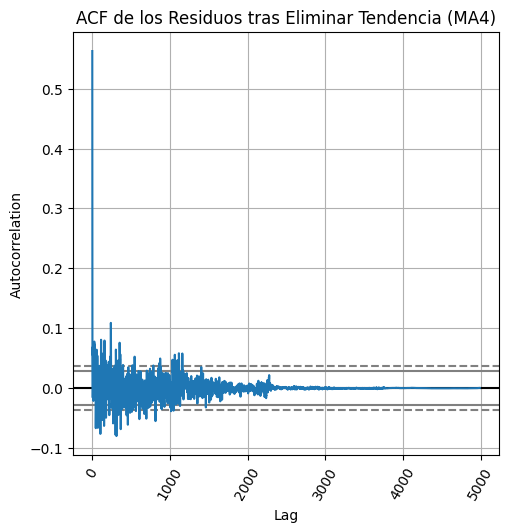

In [38]:
import matplotlib.pyplot as plt
from pandas.plotting import autocorrelation_plot

# Usamos los residuos tras eliminar la tendencia con MA4
residuals_MA4 = data['Price'] - MA4
residuals_MA4 = residuals_MA4.dropna()  # Eliminar valores NaN

# Graficar la ACF de los residuos con autocorrelation_plot
fig = plt.figure(figsize=(5.5, 5.5))
ax = fig.add_subplot(1, 1, 1)

# Generar el gráfico de autocorrelación
autocorrelation_plot(residuals_MA4, ax=ax)

# Añadir título y ajustes
ax.set_title('ACF de los Residuos tras Eliminar Tendencia (MA4)')
plt.xticks(rotation=60)
plt.show()


Tras eliminar la tendencia utilizando la media móvil de 4 días (MA4), la mayor parte de los residuos parecen ser independientes (sin correlación significativa), ya que los coeficientes de autocorrelación caen dentro de los intervalos de confianza después de los primeros rezagos.
La disminución de la autocorrelación a medida que aumenta el lag sugiere que los residuos no presentan patrones evidentes, lo que puede ser una buena señal de que el componente de tendencia ha sido eliminado adecuadamente.

In [39]:
import numpy as np
from statsmodels.tsa import stattools

acf_values, confint, qstat, pval_residuals = stattools.acf(residuals_MA4, nlags=10, qstat=True, alpha=0.05)

# Verificando en qué rezagos se rechaza la hipótesis nula
significant_lags = np.where(pval_residuals <= 0.05)

print('Null hypothesis is rejected for lags:', significant_lags)


Null hypothesis is rejected for lags: (array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=int64),)


#### Prueba ADF - Ljung Box

In [40]:
import pandas as pd
from statsmodels.tsa.stattools import adfuller, acf
from statsmodels.stats.diagnostic import acorr_ljungbox

# Prueba de Dickey-Fuller sobre los residuos
print("Prueba Dickey-Fuller sobre los residuos:")
adf_test = adfuller(residuals_MA4.dropna(), autolag='AIC')
print(f"ADF Statistic: {adf_test[0]}")
print(f"p-value: {adf_test[1]}")
print("Critical Values:")
for key, value in adf_test[4].items():
    print(f"   {key}: {value}")

# Prueba de Ljung-Box para autocorrelación en los residuos
print("\nPrueba de Ljung-Box sobre los residuos:")
lb_test = acorr_ljungbox(residuals_MA4.dropna(), lags=[10], return_df=True)
print(lb_test)


Prueba Dickey-Fuller sobre los residuos:
ADF Statistic: -10.10447340466422
p-value: 1.0386447783060211e-17
Critical Values:
   1%: -3.4316701554155844
   5%: -2.8621233647998716
   10%: -2.567080525986225

Prueba de Ljung-Box sobre los residuos:
        lb_stat  lb_pvalue
10  1965.408002        0.0


Aunque la serie es estacionaria (según el test de Dickey-Fuller), la prueba de Ljung-Box indica que hay autocorrelación en los residuos, lo que sugiere que no son completamente independientes.
Esto significa que aunque hemos logrado remover la tendencia y convertir los residuos en estacionarios, aún existe dependencia entre algunos valores de los residuos (autocorrelación)

#### Descomposición de la serie temporal del precio de cierre de BTC-USD usando medias Moviles 

##### Calcular la tendencia utilizando la media móvil 2x12.

In [41]:
# Calcular la media móvil de 12 periodos para la tendencia
MA12 = data['Price'].rolling(window=12).mean()

# Aplicar una segunda media móvil para suavizar más la tendencia
trendComp = MA12.rolling(window=2).mean()

# Eliminar los valores NaN
trendComp_clean = trendComp.dropna()

# Mostrar los valores no nulos de la tendencia
print(trendComp_clean.head(10))

Date
2024-03-05    68944.325000
2024-03-04    68875.879167
2024-03-03    68735.379167
2024-03-02    68080.341667
2024-03-01    67244.441667
2024-02-29    66370.712500
2024-02-28    65540.195833
2024-02-27    64642.691667
2024-02-26    63568.525000
2024-02-25    62305.162500
Name: Price, dtype: float64


En este caso, aplicamos una media móvil con una ventana de 12 periodos para suavizar las fluctuaciones. Posteriormente, se aplica una segunda media móvil con ventana de 2 para suavizar aún más los datos resultantes.

Los valores representan la estimación de la tendencia a partir de los precios de cierre de Bitcoin. Estos valores han sido suavizados para mostrar el comportamiento subyacente del precio sin las fluctuaciones a corto plazo.
La tendencia refleja la dirección general del precio en un rango más amplio de tiempo y es útil para entender el comportamiento a largo plazo.


##### Estimar el componente estacional

In [42]:
# Calcular los residuos restando la tendencia de la serie original
residuals = data['Price'] - trendComp

# Agrupar los residuos por mes para calcular la estacionalidad
data['Month'] = data.index.month.astype(str).str.zfill(2)
monthwise_avg = residuals.groupby(data['Month']).mean()

# Expandir el componente estacional a todo el conjunto de datos
nb_years = len(data) // 12
seasonalComp = pd.Series([monthwise_avg.values] * nb_years).explode().reset_index(drop=True)

# Mostrar el componente estacional
print(seasonalComp.head(10))


0     -0.906231
1   -529.321917
2   -246.016942
3     53.827821
4    387.345554
5    109.112179
6   -172.919684
7    -12.789583
8     -7.167302
9   -383.133045
dtype: object


Se Calculan los residuos restando la tendencia de la serie original, posteriormente se agrupan estos residuos por mes para encontrar la media mensual que representan el componente estacional.
Se Replica el componente estacional para todos los años presentes en la serie.

Estimar el componente estacional nos permitiría observar si existe algún comportamiento repetitivo en ciertas épocas del año, como fluctuaciones hacia arriba o hacia abajo en determinados meses. Esto nos permitiría hacer una desestacionalización de la serie y enfocarnos en la tendencia de largo plazo y las variaciones irregulares.

En conclusion al separar la estacionalidad de la serie original, podemos trabajar con la serie desestacionalizada, lo cual permite aplicar modelos predictivos más eficaces. Si no se elimina la estacionalidad, el comportamiento cíclico puede interferir en la identificación de la verdadera tendencia y en la modelización de los componentes de largo plazo.

##### Calcular las variaciones irregulares (residuos)

In [43]:
import numpy as np
import pandas as pd

# Suponiendo que ya has restado la tendencia
residuals = data['Price'] - trendComp_clean  # Restar la tendencia para obtener los residuos

# Extraer el mes de la serie original (suponiendo que 'Date' es el índice de tipo datetime)
data['Month'] = data.index.month

# Calcular las medias mensuales de los residuos
monthwise_avg = residuals.groupby(data['Month']).mean()

# Ajustar la longitud del componente estacional
nb_months = len(data)  # Número total de meses en los datos
seasonalComp = np.tile(monthwise_avg.values, nb_months // 12 + 1)[:nb_months]  # Ajustar la longitud

# Alinear el componente estacional con el índice de la serie original
seasonalComp_aligned = pd.Series(seasonalComp, index=data.index)

# Calcular las variaciones irregulares
irr_var = data['Price'] - trendComp_clean - seasonalComp_aligned

# Eliminar los NaN que puedan quedar
irr_var_clean = irr_var.dropna()

# Verificar los primeros valores
print(irr_var_clean.head())





Date
2010-07-18    184.783948
2010-07-19    -11.990655
2010-07-20    383.133045
2010-07-21      7.167302
2010-07-22     12.789583
Freq: D, dtype: float64


##### Grafica de las diferentes series

In [44]:

import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Graficar la serie original
fig_original = go.Figure()
fig_original.add_trace(go.Scatter(x=data.index, y=data['Price'], mode='lines', name='Serie Original', line=dict(color='blue')))
fig_original.update_layout(title='Serie Original del Precio de Bitcoin', xaxis_title='Fecha', yaxis_title='Precio (USD)', template="plotly_white")
fig_original.show()







In [45]:

# Graficar el componente de tendencia
fig_trend = go.Figure()
fig_trend.add_trace(go.Scatter(x=data.index, y=trendComp_clean, mode='lines', name='Tendencia', line=dict(color='red')))
fig_trend.update_layout(title='Componente de Tendencia del Precio de Bitcoin', xaxis_title='Fecha', yaxis_title='Precio (USD)', template="plotly_white")
fig_trend.show()


In [46]:
import plotly.graph_objs as go

# Crear un gráfico para visualizar las variaciones irregulares
fig = go.Figure()

# Añadir la serie de variaciones irregulares
fig.add_trace(go.Scatter(x=irr_var.index, y=irr_var, mode='lines', name='Variaciones Irregulares', line=dict(color='black')))

# Personalizar el diseño del gráfico
fig.update_layout(title="Variaciones Irregulares del Precio de Bitcoin", xaxis_title="Fecha", yaxis_title="Variaciones Irregulares (USD)")

# Mostrar el gráfico
fig.show()


##### Validacion de estacionalidad con ADF

In [47]:
from statsmodels.tsa.stattools import adfuller
import pandas as pd


adf_result_irr_var = adfuller(irr_var.dropna(), autolag='AIC')

# Mostrar el p-valor del test ADF para validar no estacionalidad
print('p-val of the ADF test on irregular variations in Bitcoin price:', adf_result_irr_var[1])

print(f'ADF Statistic: {adf_result_irr_var[0]}')
print('Critical Values:')
for key, value in adf_result_irr_var[4].items():
    print(f'   {key}: {value}')


p-val of the ADF test on irregular variations in Bitcoin price: 1.9452652406870675e-12
ADF Statistic: -8.032160308685516
Critical Values:
   1%: -3.4316725584017265
   5%: -2.8621244264217403
   10%: -2.5670810911297512


El p-valor es extremadamente bajo (2.25e-15), lo que significa que hay una evidencia muy fuerte en contra de la hipótesis nula de que la serie tiene una raíz unitaria. En otras palabras, podemos rechazar la hipótesis nula y concluir que las variaciones irregulares son estacionarias.

##### Validacion de independiencia de residuos con L-Jung

In [48]:
from statsmodels.stats.diagnostic import acorr_ljungbox

# Realizar la prueba de Ljung-Box sobre los residuos
ljung_box_test = acorr_ljungbox(irr_var.dropna(), lags=[10, 20, 30], return_df=True)

# Mostrar los resultados de la prueba
print(ljung_box_test)


         lb_stat  lb_pvalue
10  12498.112254        0.0
20  12553.100167        0.0
30  13178.982594        0.0


Los residuos de las variaciones irregulares del precio de Bitcoin no son independientes, es decir, hay evidencia de autocorrelación. Esto sugiere que a pesar de remover la tendencia y la estacionalidad, todavía existe algún patrón de dependencia en los residuos

##### Ajustes Mediante Modelo Multiplicativo

In [49]:

import pandas as pd
import numpy as np

# Asegurarse de que el índice de la serie sea de tipo datetime
data.index = pd.to_datetime(data.index)

# Calcular la media móvil para la tendencia (2X12 media móvil mensual)
MA12 = data['Price'].rolling(window=12).mean()
trendComp = MA12.rolling(window=2).mean()

# Eliminar valores NaN de la tendencia
trendComp_clean = trendComp.dropna()

# Calcular los residuos multiplicativos dividiendo la serie original entre la tendencia limpia
residuals_multiplicativo = data['Price'].loc[trendComp_clean.index] / trendComp_clean

# Agrupar los residuos por mes para calcular el componente estacional
data['Month'] = data.index.month.astype(str).str.zfill(2)
monthwise_avg_multiplicativo = residuals_multiplicativo.groupby(data['Month']).mean()

# Expandir el componente estacional a todo el conjunto de datos
nb_years = len(data) // 12

# Ajustar la longitud del componente estacional para que coincida con la longitud de la serie original
seasonalComp_multiplicativo = pd.Series(np.tile(monthwise_avg_multiplicativo.values, nb_years + 1)[:len(trendComp_clean)], index=trendComp_clean.index)

# Calcular las variaciones irregulares dividiendo la serie original entre la tendencia y la estacionalidad
irr_var_multiplicativo = data['Price'].loc[trendComp_clean.index] / (trendComp_clean * seasonalComp_multiplicativo)

# Eliminar valores NaN del componente de tendencia, estacionalidad y residuos multiplicativos para evitar inconsistencias
irr_var_multiplicativo_clean = irr_var_multiplicativo.dropna()

# Mostrar los primeros valores corregidos
print("Residuos multiplicativos:\n", residuals_multiplicativo.head())
print("Componente estacional multiplicativo:\n", seasonalComp_multiplicativo.head())
print("Variaciones irregulares multiplicativas:\n", irr_var_multiplicativo_clean.head())


Residuos multiplicativos:
 Date
2024-03-05    0.925277
2024-03-04    0.991205
2024-03-03    0.918534
2024-03-02    0.910608
2024-03-01    0.927924
Name: Price, dtype: float64
Componente estacional multiplicativo:
 Date
2024-03-05    0.991197
2024-03-04    0.983568
2024-03-03    0.992385
2024-03-02    0.971253
2024-03-01    0.970803
dtype: float64
Variaciones irregulares multiplicativas:
 Date
2024-03-05    0.933495
2024-03-04    1.007764
2024-03-03    0.925583
2024-03-02    0.937560
2024-03-01    0.955831
dtype: float64


##### Prueba L-Jung modelo multiplicativo

In [50]:
from statsmodels.stats.diagnostic import acorr_ljungbox

irr_var_multiplicativo_clean = irr_var_multiplicativo.dropna()

# Realizar la prueba de Ljung-Box
ljung_box_result = acorr_ljungbox(irr_var_multiplicativo_clean, lags=[10, 20, 30], return_df=True)

# Mostrar los resultados
print("Prueba de Ljung-Box sobre los residuos multiplicativos:")
print(ljung_box_result)


Prueba de Ljung-Box sobre los residuos multiplicativos:
         lb_stat  lb_pvalue
10  12338.671448        0.0
20  12610.744660        0.0
30  12769.820892        0.0


Dado que los p-valores son 0 en todos los rezagos, hay evidencia de que los residuos no son independientes, lo que sugiere que el modelo multiplicativo no ha logrado capturar completamente la estructura de autocorrelación en la serie de tiempo.

##### Descomposición de series temporales mediante statsmodels.tsa

##### Modelo Aditivo

In [51]:
import pandas as pd
import numpy as np
from statsmodels.tsa.seasonal import seasonal_decompose
import plotly.graph_objs as go
import plotly.subplots as sp

# Descomponer la serie temporal usando un modelo aditivo
decompose_model = seasonal_decompose(data['Price'], period=30, model='additive')

# Extraer los componentes de tendencia, estacionalidad y residuos
trend_component = decompose_model.trend
seasonal_component = decompose_model.seasonal
residual_component = decompose_model.resid



In [52]:

# Crear un subplot con cuatro gráficos para mostrar la serie original y los componentes
fig = sp.make_subplots(rows=4, cols=1, shared_xaxes=True, vertical_spacing=0.05,
                       subplot_titles=("Precio Original", "Componente de Tendencia", 
                                       "Componente Estacional", "Variaciones Irregulares"))

# Graficar la serie original
fig.add_trace(go.Scatter(x=data.index, y=data['Price'], mode='lines', name='Precio Original', line=dict(color='blue')), row=1, col=1)

# Graficar el componente de tendencia
fig.add_trace(go.Scatter(x=data.index, y=trend_component, mode='lines', name='Tendencia', line=dict(color='red')), row=2, col=1)

# Graficar el componente estacional
fig.add_trace(go.Scatter(x=data.index, y=seasonal_component, mode='lines', name='Estacionalidad', line=dict(color='green')), row=3, col=1)

# Graficar las variaciones irregulares (residuos)
fig.add_trace(go.Scatter(x=data.index, y=residual_component, mode='lines', name='Residuos', line=dict(color='black')), row=4, col=1)

# Personalizar el diseño de la gráfica
fig.update_layout(height=800, width=900, title_text="Descomposición de la Serie Temporal del Precio de BTC-USD",
                  showlegend=False)

# Mostrar la gráfica
fig.show()


##### Prueba de ADF 

In [53]:
import numpy as np
from statsmodels.tsa.stattools import adfuller

# Extraer los residuos de la descomposición
residuals = decompose_model.resid

# Remover los NaN en los residuos
residuals_clean = residuals[~np.isnan(residuals)]

# Aplicar la prueba ADF (Augmented Dickey-Fuller) en los residuos limpios
adf_result = adfuller(residuals_clean, autolag='AIC')

# Mostrar los resultados de la prueba ADF
print(f"ADF Statistic: {adf_result[0]}")
print(f"p-value: {adf_result[1]}")
print("Critical Values:")
for key, value in adf_result[4].items():
    print(f'   {key}: {value}')


ADF Statistic: -15.742918018495553
p-value: 1.2496087028009517e-28
Critical Values:
   1%: -3.4316773907138267
   5%: -2.862126561299623
   10%: -2.5670822276105647


El p-valor es extremadamente bajo, mucho menor que 0.05. Esto nos lleva a rechazar la hipótesis nula de no estacionariedad. Es decir, podemos afirmar con confianza que los residuos son estacionarios.

##### Prueba de L-Jung

In [54]:
from statsmodels.stats.diagnostic import acorr_ljungbox
import numpy as np

# Obtener los residuos que no son NaN del modelo multiplicativo
residuals_no_nan = decompose_model.resid[~np.isnan(decompose_model.resid)]

# Realizar la prueba de Ljung-Box con rezagos de 10, 20, y 30
ljung_box_test = acorr_ljungbox(residuals_no_nan, lags=[10, 20, 30], return_df=True)

# Mostrar los resultados
print(ljung_box_test)


         lb_stat  lb_pvalue
10   7955.929415        0.0
20  11784.347896        0.0
30  12056.157181        0.0


Los resultados de la prueba de Ljung-Box sobre los residuos del modelo multiplicativo muestran valores muy pequeños para el p-valor (0.0) en los rezagos de 10, 20 y 30, lo que implica que la hipótesis nula de independencia de los residuos se rechaza en todos los casos. Esto sugiere que los residuos no son independientes, lo que significa que aún hay autocorrelación presente en los residuo

##### Modelo Multiplicativo

In [55]:
import pandas as pd
import numpy as np
from statsmodels.tsa.seasonal import seasonal_decompose
import plotly.graph_objs as go
import plotly.subplots as sp

# Descomponer la serie temporal usando un modelo aditivo
decompose_model = seasonal_decompose(data['Price'], period=30, model='multiplicative')

# Extraer los componentes de tendencia, estacionalidad y residuos
trend_component = decompose_model.trend
seasonal_component = decompose_model.seasonal
residual_component = decompose_model.resid


In [56]:

# Crear el gráfico en subplots
fig = sp.make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=("Trend Component", "Seasonal Component", "Residuals"))

# Tendencia
fig.add_trace(go.Scatter(x=data.index, y=trend_component, mode='lines', name='Tendencia', line=dict(color='blue')), row=1, col=1)

# Estacionalidad
fig.add_trace(go.Scatter(x=data.index, y=seasonal_component, mode='lines', name='Estacionalidad', line=dict(color='green')), row=2, col=1)

# Residuos
fig.add_trace(go.Scatter(x=data.index, y=residual_component, mode='lines', name='Residuos', line=dict(color='black')), row=3, col=1)

# Actualizar el layout del gráfico
fig.update_layout(height=900, width=1000, title_text="Descomposición de la Serie Temporal del Precio de Cierre de Bitcoin (Modelo Multiplicativo)", showlegend=False)

# Mostrar el gráfico
fig.show()


##### Prueba ADF 

In [57]:
from statsmodels.tsa.stattools import adfuller

# Aplicar la prueba ADF a los residuos del modelo multiplicativo
adf_result_multiplicativo = adfuller(residual_component.dropna(), autolag='AIC')

# Mostrar los resultados de la prueba ADF
print("ADF Statistic (Multiplicativo):", adf_result_multiplicativo[0])
print("p-value (Multiplicativo):", adf_result_multiplicativo[1])
print("Critical Values (Multiplicativo):")
for key, value in adf_result_multiplicativo[4].items():
    print(f'   {key}: {value}')


ADF Statistic (Multiplicativo): -15.661199599616856
p-value (Multiplicativo): 1.5532138984137325e-28
Critical Values (Multiplicativo):
   1%: -3.43167712132583
   5%: -2.862126442286194
   10%: -2.5670821642549444


El p-value es extremadamente bajo, lo que indica que podemos rechazar la hipótesis nula de que la serie de residuos tiene una raíz unitaria. Esto sugiere que los residuos del modelo multiplicativo son estacionarios, es decir, no presentan tendencia o estacionalidad significativa, lo cual es un buen resultado para los residuos

##### Prueba Ljung-Box

In [58]:
from statsmodels.stats.diagnostic import acorr_ljungbox

# Aplicar la prueba de Ljung-Box a los residuos del modelo multiplicativo
ljung_box_result_multiplicativo = acorr_ljungbox(residual_component.dropna(), lags=[10, 20, 30], return_df=True)

# Mostrar los resultados de la prueba Ljung-Box
print("Prueba de Ljung-Box sobre los residuos multiplicativos:")
print(ljung_box_result_multiplicativo)


Prueba de Ljung-Box sobre los residuos multiplicativos:
        lb_stat  lb_pvalue
10  6945.652331        0.0
20  8864.708071        0.0
30  8919.364364        0.0


Esto indica que podemos rechazar la hipótesis nula de que los residuos son independientes en los rezagos examinados. En otras palabras, los residuos muestran autocorrelación, lo que significa que el modelo multiplicativo no capturó toda la dependencia en los datos, y aún queda información estructurada en los residuos.

### II Repita el análisis anterior para las series de tiempo de: retorno acumulado diario y volatilidad, para diferentes ventanas. Para esto tenga en cuenta las siguientes definiciones e implemente manualmente las funciones que definen cada serie de tiempo

In [59]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go

# URL del dataset
url = "https://raw.githubusercontent.com/lihkir/Data/refs/heads/main/Bitcoin%20Historical%20Data.csv"

# Leyendo el dataset
data = pd.read_csv(url)

# Asegurarse de que los datos de precios sean numéricos
if data['Price'].dtype == 'object':
    data['Price'] = pd.to_numeric(data['Price'].str.replace(',', ''), errors='coerce')

# Asegurarse de que la columna 'Date' esté en formato datetime
data['Date'] = pd.to_datetime(data['Date'])

In [60]:
import pandas as pd
import numpy as np

# Calcular el retorno acumulado diario
data['Retorno Acumulado Diario'] = ((data['Price'] - data['Price'].shift(1)) / data['Price'].shift(1)).cumsum()

# Mostrar los primeros resultados
print(data[['Price', 'Retorno Acumulado Diario']].head())



     Price  Retorno Acumulado Diario
0  67211.9                       NaN
1  64037.8                 -0.047225
2  63785.5                 -0.051165
3  65503.8                 -0.024226
4  67854.0                  0.011652


#### Grafica de series de tiempo para Retorno Acumulado Diario y Volatilidad

In [61]:

# Calcular el retorno acumulado diario
data['Retorno Acumulado Diario'] = ((data['Price'] - data['Price'].shift(1)) / data['Price'].shift(1)).cumsum()

# Mostrar los primeros resultados
print(data[['Date', 'Price', 'Retorno Acumulado Diario']].head())

# Graficar el Retorno Acumulado Diario
fig = go.Figure()

fig.add_trace(go.Scatter(x=data['Date'], y=data['Retorno Acumulado Diario'], mode='lines', name='Retorno Acumulado Diario', line=dict(color='blue')))

# Personalizar el diseño del gráfico
fig.update_layout(
    title="Retorno Acumulado Diario de Bitcoin",
    xaxis_title="Fecha",
    yaxis_title="Retorno Acumulado Diario",
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar la gráfica
fig.show()




        Date    Price  Retorno Acumulado Diario
0 2024-03-24  67211.9                       NaN
1 2024-03-23  64037.8                 -0.047225
2 2024-03-22  63785.5                 -0.051165
3 2024-03-21  65503.8                 -0.024226
4 2024-03-20  67854.0                  0.011652


El retorno acumulado diario indica la suma de los rendimientos diarios a lo largo del tiempo. Esto nos da una idea de cómo ha evolucionado el precio de Bitcoin en términos de ganancias o pérdidas acumuladas. En el gráfico, se observa que hubo periodos de caídas pronunciadas seguidas de incrementos significativos, lo que refleja la naturaleza volátil del mercado.

Volatilidad: A lo largo del gráfico, podemos notar múltiples picos hacia arriba y hacia abajo, lo que indica una alta volatilidad. Este comportamiento es típico de activos como Bitcoin, que son propensos a grandes fluctuaciones de precio en cortos periodos de tiempo.

In [62]:
# Calcular el retorno diario
data['Retorno Diario'] = (data['Price'] - data['Price'].shift(1)) / data['Price'].shift(1)

# Definir diferentes ventanas (7, 14, 21, 28 días)
ventanas = [7, 14, 21, 28]

# Calcular la volatilidad (desviación estándar) para cada ventana
for ventana in ventanas:
    data[f'Volatilidad {ventana} días'] = data['Retorno Diario'].rolling(window=ventana).std()
    


# Graficar la volatilidad para cada ventana
fig = go.Figure()

# Añadir trazas para cada ventana
for ventana in ventanas:
    fig.add_trace(go.Scatter(x=data['Date'], y=data[f'Volatilidad {ventana} días'], mode='lines', name=f'Volatilidad {ventana} días'))

# Personalizar el diseño del gráfico
fig.update_layout(
    title="Volatilidad (Desviación Estándar) del Retorno Diario de Bitcoin",
    xaxis_title="Fecha",
    yaxis_title="Volatilidad",
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar la gráfica
fig.show()


Esta grafica muestra el comportamiento de la volatilidad en diferentes ventanas.
Se realiza en la libreria Ploty para que de manera interactiva se pueda ir analizando su comportamiento en el tiempo.

##### Grafica de velas

In [63]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Asegurarte de que las gráficas se muestren en la misma página del notebook
import plotly.io as pio
pio.renderers.default = 'notebook'

# Cargar los datos desde el archivo CSV
url = "https://raw.githubusercontent.com/lihkir/Data/refs/heads/main/Bitcoin%20Historical%20Data.csv"
data = pd.read_csv(url)

# Convertir la columna 'Date' al formato datetime
data['Date'] = pd.to_datetime(data['Date'], format='%m/%d/%Y')

# Asegurarse de que los datos de precios sean numéricos
data['Price'] = pd.to_numeric(data['Price'].str.replace(',', ''), errors='coerce')

# Paso 1: Calcular el retorno acumulado diario
data['Retorno Diario'] = (data['Price'] - data['Price'].shift(1)) / data['Price'].shift(1)
data['Retorno Acumulado Diario'] = data['Retorno Diario'].cumsum()

# Paso 2: Calcular la volatilidad para diferentes ventanas
def calcular_volatilidad(data, ventana):
    return data['Retorno Diario'].rolling(window=ventana).std()

data['Volatilidad_7_dias'] = calcular_volatilidad(data, 7)
data['Volatilidad_14_dias'] = calcular_volatilidad(data, 14)
data['Volatilidad_21_dias'] = calcular_volatilidad(data, 21)
data['Volatilidad_28_dias'] = calcular_volatilidad(data, 28)



# Crear un gráfico con subplots para mostrar todas las gráficas juntas
fig = make_subplots(rows=5, cols=1, shared_xaxes=True,
                    vertical_spacing=0.1, subplot_titles=("Retorno Acumulado Diario", 
                                                         "Volatilidad 7 días", 
                                                         "Volatilidad 14 días", 
                                                         "Volatilidad 21 días", 
                                                         "Volatilidad 28 días"))

# Paso 3: Gráfico de velas para Retorno Acumulado Diario
fig.add_trace(go.Candlestick(x=data['Date'],
                             open=data['Retorno Acumulado Diario'],
                             high=data['Retorno Acumulado Diario'],
                             low=data['Retorno Acumulado Diario'],
                             close=data['Retorno Acumulado Diario'],
                             name='Retorno Acumulado Diario'), row=1, col=1)

# Paso 4: Gráficos de velas para Volatilidades de diferentes ventanas
fig.add_trace(go.Candlestick(x=data['Date'],
                             open=data['Volatilidad_7_dias'],
                             high=data['Volatilidad_7_dias'],
                             low=data['Volatilidad_7_dias'],
                             close=data['Volatilidad_7_dias'],
                             name='Volatilidad 7 días'), row=2, col=1)

fig.add_trace(go.Candlestick(x=data['Date'],
                             open=data['Volatilidad_14_dias'],
                             high=data['Volatilidad_14_dias'],
                             low=data['Volatilidad_14_dias'],
                             close=data['Volatilidad_14_dias'],
                             name='Volatilidad 14 días'), row=3, col=1)

fig.add_trace(go.Candlestick(x=data['Date'],
                             open=data['Volatilidad_21_dias'],
                             high=data['Volatilidad_21_dias'],
                             low=data['Volatilidad_21_dias'],
                             close=data['Volatilidad_21_dias'],
                             name='Volatilidad 21 días'), row=4, col=1)

fig.add_trace(go.Candlestick(x=data['Date'],
                             open=data['Volatilidad_28_dias'],
                             high=data['Volatilidad_28_dias'],
                             low=data['Volatilidad_28_dias'],
                             close=data['Volatilidad_28_dias'],
                             name='Volatilidad 28 días'), row=5, col=1)

# Actualizar layout
fig.update_layout(height=1200, width=1000, title_text="Gráficos de Velas para Retorno Acumulado Diario y Volatilidades")

# Mostrar las gráficas en el notebook
fig.show()



#### Subseries

##### Subserie semanal

In [64]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go

# Verificar que la columna 'Date' esté en formato datetime
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d', errors='coerce')

# Extraer el año y la semana si no están presentes
if 'Year' not in data.columns:
    data['Year'] = data['Date'].dt.year
if 'Week' not in data.columns:
    data['Week'] = data['Date'].dt.isocalendar().week

# Asegúrate de que tienes las columnas correctas antes de continuar
print(data[['Date', 'Year', 'Week']].head())

# Agrupar por Year y Week y calcular la media y la desviación estándar del Retorno Acumulado Diario
weekly_data = data.groupby(by=['Year', 'Week'])['Retorno Acumulado Diario'].aggregate([np.mean, np.std])

# Renombrar las columnas
weekly_data.columns = ['Weekly Mean', 'Weekly Standard Deviation']

# Crear un índice combinado de Year y Week
weekly_data.reset_index(inplace=True)
weekly_data['Year-Week'] = weekly_data['Year'].astype(str) + '-W' + weekly_data['Week'].astype(str)

# Crear el gráfico de la media semanal con Plotly
fig_week_mean = go.Figure()
fig_week_mean.add_trace(go.Scatter(
    x=weekly_data['Year-Week'],
    y=weekly_data['Weekly Mean'],
    mode='lines',
    name='Weekly Mean',
    line=dict(color='blue')
))

fig_week_mean.update_layout(
    title='Media Semanal del Retorno Acumulado Diario',
    xaxis_title='Tiempo (Año-Semana)',
    yaxis_title='Retorno Acumulado Diario',
    xaxis=dict(tickangle=-45),
    height=600,
    width=1000,
    template="plotly_white"
)

fig_week_mean.show()

# Crear el gráfico de la desviación estándar semanal con Plotly
fig_week_std = go.Figure()
fig_week_std.add_trace(go.Scatter(
    x=weekly_data['Year-Week'],
    y=weekly_data['Weekly Standard Deviation'],
    mode='lines',
    name='Weekly Standard Deviation',
    line=dict(color='red')
))

fig_week_std.update_layout(
    title='Desviación Estándar Semanal del Retorno Acumulado Diario',
    xaxis_title='Tiempo (Año-Semana)',
    yaxis_title='Desviación Estándar del Retorno Acumulado Diario',
    xaxis=dict(tickangle=-45),
    height=600,
    width=1000,
    template="plotly_white"
)

fig_week_std.show()


        Date  Year  Week
0 2024-03-24  2024    12
1 2024-03-23  2024    12
2 2024-03-22  2024    12
3 2024-03-21  2024    12
4 2024-03-20  2024    12


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1748045482.py:18: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1748045482.py:18: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



Media Semanal
Este gráfico muestra cómo se comporta la media del retorno acumulado diario a lo largo del tiempo, agrupado por semanas.
Puedes observar fluctuaciones claras, donde hay periodos de mayor aumento o disminución.
Los picos más altos en la curva sugieren momentos de alta volatilidad o cambios significativos en el mercado de Bitcoin. Los tramos descendentes marcan períodos de caída en el precio de Bitcoin acumulado.

Desviacion Estandar Semanal
Este gráfico refleja la volatilidad semanal del retorno acumulado diario.
Los picos en la desviación estándar indican semanas donde hubo una mayor dispersión o variabilidad en los datos del retorno acumulado. En otras palabras, refleja la incertidumbre o volatilidad en esos momentos.
La desviación estándar es más baja en periodos estables, y más alta en periodos volátiles, lo cual es coherente con el comportamiento de un activo volátil como Bitcoin.

##### Volatilidad para diferentes ventanas

In [65]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go

# Función para calcular la volatilidad sobre una ventana móvil
def calcular_volatilidad(data, ventana):
    retorno_diario = (data['Price'] - data['Price'].shift(1)) / data['Price'].shift(1)
    data[f'Volatilidad_{ventana}_dias'] = retorno_diario.rolling(window=ventana).std()
    return data

# Función para graficar la media y desviación estándar de la volatilidad
def graficar_volatilidad(data, columna_volatilidad, nombre_ventana):
    # Asegurarse de que 'Date' sea datetime
    if not pd.api.types.is_datetime64_any_dtype(data['Date']):
        data['Date'] = pd.to_datetime(data['Date'])

    # Extraer la semana del año
    data['Year'] = data['Date'].dt.year
    data['Week'] = data['Date'].dt.isocalendar().week

    # Agrupar por Year y Week y calcular la media y la desviación estándar de la volatilidad
    weekly_data = data.groupby(by=['Year', 'Week'])[columna_volatilidad].aggregate([np.mean, np.std])

    # Renombrar las columnas
    weekly_data.columns = ['Weekly Mean', 'Weekly Standard Deviation']

    # Crear un índice combinado de Year y Week para el eje x
    weekly_data.reset_index(inplace=True)
    weekly_data['Year-Week'] = weekly_data['Year'].astype(str) + '-' + weekly_data['Week'].astype(str)

    # Crear el gráfico de la media semanal con Plotly
    fig_mean = go.Figure()

    # Agregar la línea de la media semanal
    fig_mean.add_trace(go.Scatter(
        x=weekly_data['Year-Week'],
        y=weekly_data['Weekly Mean'],
        mode='lines',
        name=f'Media Semanal ({nombre_ventana})',
        line=dict(color='blue')
    ))

    # Personalizar el diseño para la media semanal
    fig_mean.update_layout(
        title=f'Media Semanal de la Volatilidad ({nombre_ventana})',
        xaxis_title='Tiempo (Año-Semana)',
        yaxis_title='Volatilidad',
        xaxis=dict(tickangle=-45),
        height=600,
        width=1000,
        template="plotly_white"
    )

    # Mostrar el gráfico de la media
    fig_mean.show()

    # Crear el gráfico de la desviación estándar semanal con Plotly
    fig_std = go.Figure()

    # Agregar la línea de la desviación estándar semanal
    fig_std.add_trace(go.Scatter(
        x=weekly_data['Year-Week'],
        y=weekly_data['Weekly Standard Deviation'],
        mode='lines',
        name=f'Desviación Estándar Semanal ({nombre_ventana})',
        line=dict(color='red')
    ))

    # Personalizar el diseño para la desviación estándar semanal
    fig_std.update_layout(
        title=f'Desviación Estándar Semanal de la Volatilidad ({nombre_ventana})',
        xaxis_title='Tiempo (Año-Semana)',
        yaxis_title='Desviación Estándar de la Volatilidad',
        xaxis=dict(tickangle=-45),
        height=600,
        width=1000,
        template="plotly_white"
    )

    # Mostrar el gráfico de la desviación estándar
    fig_std.show()

# Aplicar el cálculo de volatilidad para las diferentes ventanas y graficar
ventanas = [7, 14, 21, 28]

for ventana in ventanas:
    data = calcular_volatilidad(data, ventana)
    graficar_volatilidad(data, f'Volatilidad_{ventana}_dias', f'{ventana} días')


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3626168241.py:22: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3626168241.py:22: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3626168241.py:22: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3626168241.py:22: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3626168241.py:22: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3626168241.py:22: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3626168241.py:22: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\3626168241.py:22: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



##### Subserie Mensual

In [66]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go

# Verificar que la columna 'Date' esté en formato datetime
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d', errors='coerce')

# Extraer el año y el mes si no están presentes
if 'Year' not in data.columns:
    data['Year'] = data['Date'].dt.year
if 'Month' not in data.columns:
    data['Month'] = data['Date'].dt.month

# Agrupar por Year y Month y calcular la media y la desviación estándar del Retorno Acumulado Diario
monthly_data = data.groupby(by=['Year', 'Month'])['Retorno Acumulado Diario'].aggregate([np.mean, np.std])

# Renombrar las columnas
monthly_data.columns = ['Monthly Mean', 'Monthly Standard Deviation']

# Crear un índice combinado de Year y Month
monthly_data.reset_index(inplace=True)
monthly_data['Year-Month'] = monthly_data['Year'].astype(str) + '-' + monthly_data['Month'].astype(str)

# Crear el gráfico de la media mensual con Plotly
fig_month_mean = go.Figure()
fig_month_mean.add_trace(go.Scatter(
    x=monthly_data['Year-Month'],
    y=monthly_data['Monthly Mean'],
    mode='lines',
    name='Monthly Mean',
    line=dict(color='blue')
))

fig_month_mean.update_layout(
    title='Media Mensual del Retorno Acumulado Diario',
    xaxis_title='Tiempo (Año-Mes)',
    yaxis_title='Retorno Acumulado Diario',
    xaxis=dict(tickangle=-45),
    height=600,
    width=1000,
    template="plotly_white"
)

fig_month_mean.show()

# Crear el gráfico de la desviación estándar mensual con Plotly
fig_month_std = go.Figure()
fig_month_std.add_trace(go.Scatter(
    x=monthly_data['Year-Month'],
    y=monthly_data['Monthly Standard Deviation'],
    mode='lines',
    name='Monthly Standard Deviation',
    line=dict(color='red')
))

fig_month_std.update_layout(
    title='Desviación Estándar Mensual del Retorno Acumulado Diario',
    xaxis_title='Tiempo (Año-Mes)',
    yaxis_title='Desviación Estándar del Retorno Acumulado Diario',
    xaxis=dict(tickangle=-45),
    height=600,
    width=1000,
    template="plotly_white"
)

fig_month_std.show()


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1559503084.py:15: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1559503084.py:15: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



In [67]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go

# Función para calcular la volatilidad sobre una ventana móvil
def calcular_volatilidad(data, ventana):
    retorno_diario = (data['Price'] - data['Price'].shift(1)) / data['Price'].shift(1)
    data[f'Volatilidad_{ventana}_dias'] = retorno_diario.rolling(window=ventana).std()
    return data

# Función para graficar la media y desviación estándar de la volatilidad mensual
def graficar_volatilidad_mensual(data, columna_volatilidad, nombre_ventana):
    # Asegurarse de que 'Date' sea datetime
    if not pd.api.types.is_datetime64_any_dtype(data['Date']):
        data['Date'] = pd.to_datetime(data['Date'])

    # Extraer el mes y año del DateTime
    data['Year'] = data['Date'].dt.year
    data['Month'] = data['Date'].dt.month

    # Agrupar por Year y Month y calcular la media y la desviación estándar de la volatilidad
    monthly_data = data.groupby(by=['Year', 'Month'])[columna_volatilidad].aggregate([np.mean, np.std])

    # Renombrar las columnas
    monthly_data.columns = ['Monthly Mean', 'Monthly Standard Deviation']

    # Crear un índice combinado de Year y Month para el eje x
    monthly_data.reset_index(inplace=True)
    monthly_data['Year-Month'] = monthly_data['Year'].astype(str) + '-' + monthly_data['Month'].astype(str)

    # Crear el gráfico de la media mensual con Plotly
    fig_mean = go.Figure()

    # Agregar la línea de la media mensual
    fig_mean.add_trace(go.Scatter(
        x=monthly_data['Year-Month'],
        y=monthly_data['Monthly Mean'],
        mode='lines',
        name=f'Media Mensual ({nombre_ventana})',
        line=dict(color='blue')
    ))

    # Personalizar el diseño para la media mensual
    fig_mean.update_layout(
        title=f'Media Mensual de la Volatilidad ({nombre_ventana})',
        xaxis_title='Tiempo (Año-Mes)',
        yaxis_title='Volatilidad',
        xaxis=dict(tickangle=-45),
        height=600,
        width=1000,
        template="plotly_white"
    )

    # Mostrar el gráfico de la media
    fig_mean.show()

    # Crear el gráfico de la desviación estándar mensual con Plotly
    fig_std = go.Figure()

    # Agregar la línea de la desviación estándar mensual
    fig_std.add_trace(go.Scatter(
        x=monthly_data['Year-Month'],
        y=monthly_data['Monthly Standard Deviation'],
        mode='lines',
        name=f'Desviación Estándar Mensual ({nombre_ventana})',
        line=dict(color='red')
    ))

    # Personalizar el diseño para la desviación estándar mensual
    fig_std.update_layout(
        title=f'Desviación Estándar Mensual de la Volatilidad ({nombre_ventana})',
        xaxis_title='Tiempo (Año-Mes)',
        yaxis_title='Desviación Estándar de la Volatilidad',
        xaxis=dict(tickangle=-45),
        height=600,
        width=1000,
        template="plotly_white"
    )

    # Mostrar el gráfico de la desviación estándar
    fig_std.show()

# Aplicar el cálculo de volatilidad para las diferentes ventanas y graficar
ventanas = [7, 14, 21, 28]

for ventana in ventanas:
    data = calcular_volatilidad(data, ventana)
    graficar_volatilidad_mensual(data, f'Volatilidad_{ventana}_dias', f'{ventana} días')



C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\2447624729.py:22: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\2447624729.py:22: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\2447624729.py:22: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\2447624729.py:22: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\2447624729.py:22: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\2447624729.py:22: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\2447624729.py:22: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\2447624729.py:22: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



##### Subserie Anual

In [68]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go

# Verificar que la columna 'Date' esté en formato datetime
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d', errors='coerce')

# Extraer el año si no está presente
if 'Year' not in data.columns:
    data['Year'] = data['Date'].dt.year

# Agrupar por Year y calcular la media y la desviación estándar del Retorno Acumulado Diario
annual_data = data.groupby(by=['Year'])['Retorno Acumulado Diario'].aggregate([np.mean, np.std])

# Renombrar las columnas
annual_data.columns = ['Annual Mean', 'Annual Standard Deviation']

# Crear el gráfico de la media anual con Plotly
fig_year_mean = go.Figure()
fig_year_mean.add_trace(go.Scatter(
    x=annual_data.index,
    y=annual_data['Annual Mean'],
    mode='lines',
    name='Annual Mean',
    line=dict(color='blue')
))

fig_year_mean.update_layout(
    title='Media Anual del Retorno Acumulado Diario',
    xaxis_title='Año',
    yaxis_title='Retorno Acumulado Diario',
    height=600,
    width=1000,
    template="plotly_white"
)

fig_year_mean.show()

# Crear el gráfico de la desviación estándar anual con Plotly
fig_year_std = go.Figure()
fig_year_std.add_trace(go.Scatter(
    x=annual_data.index,
    y=annual_data['Annual Standard Deviation'],
    mode='lines',
    name='Annual Standard Deviation',
    line=dict(color='red')
))

fig_year_std.update_layout(
    title='Desviación Estándar Anual del Retorno Acumulado Diario',
    xaxis_title='Año',
    yaxis_title='Desviación Estándar del Retorno Acumulado Diario',
    height=600,
    width=1000,
    template="plotly_white"
)

fig_year_std.show()


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\4288266595.py:13: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\4288266595.py:13: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



In [69]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go

# Función para calcular la volatilidad sobre una ventana móvil
def calcular_volatilidad(data, ventana):
    retorno_diario = (data['Price'] - data['Price'].shift(1)) / data['Price'].shift(1)
    data[f'Volatilidad_{ventana}_dias'] = retorno_diario.rolling(window=ventana).std()
    return data

# Función para graficar la media y desviación estándar de la volatilidad anual
def graficar_volatilidad_anual(data, columna_volatilidad, nombre_ventana):
    # Asegurarse de que 'Date' sea datetime
    if not pd.api.types.is_datetime64_any_dtype(data['Date']):
        data['Date'] = pd.to_datetime(data['Date'])

    # Extraer el año del DateTime
    data['Year'] = data['Date'].dt.year

    # Agrupar por Year y calcular la media y la desviación estándar de la volatilidad
    yearly_data = data.groupby(by=['Year'])[columna_volatilidad].aggregate([np.mean, np.std])

    # Renombrar las columnas
    yearly_data.columns = ['Yearly Mean', 'Yearly Standard Deviation']

    # Crear un índice de Year para el eje x
    yearly_data.reset_index(inplace=True)

    # Crear el gráfico de la media anual con Plotly
    fig_mean = go.Figure()

    # Agregar la línea de la media anual
    fig_mean.add_trace(go.Scatter(
        x=yearly_data['Year'],
        y=yearly_data['Yearly Mean'],
        mode='lines',
        name=f'Media Anual ({nombre_ventana})',
        line=dict(color='blue')
    ))

    # Personalizar el diseño para la media anual
    fig_mean.update_layout(
        title=f'Media Anual de la Volatilidad ({nombre_ventana})',
        xaxis_title='Tiempo (Año)',
        yaxis_title='Volatilidad',
        xaxis=dict(tickangle=-45),
        height=600,
        width=1000,
        template="plotly_white"
    )

    # Mostrar el gráfico de la media
    fig_mean.show()

    # Crear el gráfico de la desviación estándar anual con Plotly
    fig_std = go.Figure()

    # Agregar la línea de la desviación estándar anual
    fig_std.add_trace(go.Scatter(
        x=yearly_data['Year'],
        y=yearly_data['Yearly Standard Deviation'],
        mode='lines',
        name=f'Desviación Estándar Anual ({nombre_ventana})',
        line=dict(color='red')
    ))

    # Personalizar el diseño para la desviación estándar anual
    fig_std.update_layout(
        title=f'Desviación Estándar Anual de la Volatilidad ({nombre_ventana})',
        xaxis_title='Tiempo (Año)',
        yaxis_title='Desviación Estándar de la Volatilidad',
        xaxis=dict(tickangle=-45),
        height=600,
        width=1000,
        template="plotly_white"
    )

    # Mostrar el gráfico de la desviación estándar
    fig_std.show()

# Aplicar el cálculo de volatilidad para las diferentes ventanas y graficar
ventanas = [7, 14, 21, 28]

for ventana in ventanas:
    data = calcular_volatilidad(data, ventana)
    graficar_volatilidad_anual(data, f'Volatilidad_{ventana}_dias', f'{ventana} días')


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1965929649.py:21: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1965929649.py:21: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1965929649.py:21: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1965929649.py:21: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1965929649.py:21: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1965929649.py:21: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1965929649.py:21: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1965929649.py:21: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



#### Estudio de Estacionalidad Series Retorno acumulado y Volatilidad 

##### AFC

In [70]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from statsmodels.tsa.stattools import acf

# Función para calcular y graficar la ACF
def graficar_acf(data, columna, titulo, nlags=40):
    # Asegurarse de que los datos sean numéricos
    if not pd.api.types.is_numeric_dtype(data[columna]):
        data[columna] = pd.to_numeric(data[columna], errors='coerce')
    
    # Eliminar filas con valores nulos en la columna
    data = data.dropna(subset=[columna])
    
    # Calcular la ACF usando statsmodels
    acf_values = acf(data[columna], nlags=nlags)
    
    # Crear los lags (retardos)
    lags = np.arange(len(acf_values))
    
    # Graficar la ACF usando Plotly
    fig = go.Figure()
    
    # Añadir los puntos de la ACF
    fig.add_trace(go.Scatter(
        x=lags,
        y=acf_values,
        mode='lines+markers',
        name='ACF',
        marker=dict(color='blue')
    ))
    
    # Personalizar el diseño del gráfico
    fig.update_layout(
        title=f'Función de Autocorrelación (ACF) de {titulo}',
        xaxis_title='Lag (retardo)',
        yaxis_title='Autocorrelación',
        height=600,
        width=1000,
        template="plotly_white"
    )
    
    # Mostrar el gráfico
    fig.show()

# Calcular y graficar la ACF para Retorno Acumulado Diario
graficar_acf(data, 'Retorno Acumulado Diario', 'Retorno Acumulado Diario')

# Calcular y graficar la ACF para las diferentes ventanas de volatilidad
ventanas = [7, 14, 21, 28]
for ventana in ventanas:
    graficar_acf(data, f'Volatilidad_{ventana}_dias', f'Volatilidad ({ventana} días)')


Autocorrelación del Retorno Acumulado Diario:

En esta gráfica, puedes observar que la autocorrelación disminuye de manera muy suave y casi lineal conforme aumenta el lag. Este comportamiento sugiere que el retorno acumulado diario tiene una fuerte dependencia de sus valores anteriores, pero esta dependencia decrece de manera constante.
Aunque hay una ligera disminución, la autocorrelación sigue siendo bastante alta incluso en valores de lag grandes, lo que puede indicar que la serie de retorno acumulado tiene una tendencia o que puede ser no estacionaria.

Autocorrelación de la Volatilidad (7, 14, 21, 28 días):

La volatilidad muestra un comportamiento diferente. En todas las ventanas, la autocorrelación cae bruscamente al inicio y luego se estabiliza.

Volatilidad 7 días: Aquí, la autocorrelación disminuye rápidamente y se estabiliza cerca de un valor bajo a partir de lag 10. Esto indica que la volatilidad a corto plazo tiene menor dependencia de sus valores pasados a medida que el retardo aumenta.

Volatilidad 14 días: Se observa un comportamiento similar al de los 7 días, pero la autocorrelación decrece más lentamente, manteniéndose algo más alta en los primeros lags y disminuyendo progresivamente.

Volatilidad 21 y 28 días: A medida que la ventana de la volatilidad aumenta, la autocorrelación disminuye más lentamente, aunque sigue el patrón de disminuir rápidamente al principio y estabilizarse a valores bajos en lags más altos.

In [71]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from statsmodels.tsa.stattools import pacf

# Asegurarse de que 'Retorno Acumulado Diario' sea numérico
data['Retorno Acumulado Diario'] = pd.to_numeric(data['Retorno Acumulado Diario'], errors='coerce')

# Eliminar las filas con valores nulos en 'Retorno Acumulado Diario'
data = data.dropna(subset=['Retorno Acumulado Diario'])

# Calcular la PACF y los intervalos de confianza utilizando statsmodels (con 31 lags)
pacf_values, confint = pacf(data['Retorno Acumulado Diario'], nlags=31, alpha=0.05)

# Crear los lags
lags = np.arange(len(pacf_values))

# Extraer los límites inferior y superior de los intervalos de confianza
confint_lower = confint[:, 0] - pacf_values
confint_upper = confint[:, 1] - pacf_values

# Crear la gráfica PACF usando Plotly
fig = go.Figure()

# Agregar los puntos de la PACF
fig.add_trace(go.Scatter(
    x=lags,
    y=pacf_values,
    mode='lines+markers',
    name='PACF',
    marker=dict(color='blue')
))

# Agregar los intervalos de confianza como un área sombreada
fig.add_trace(go.Scatter(
    x=np.concatenate([lags, lags[::-1]]),
    y=np.concatenate([confint_upper, confint_lower[::-1]]),
    fill='toself',
    fillcolor='rgba(0, 0, 255, 0.1)',  # Sombreado en azul claro
    line=dict(color='rgba(255,255,255,0)'),
    hoverinfo="skip",
    showlegend=False
))

# Personalizar el diseño del gráfico y ajustar el título
fig.update_layout(
    title={
        'text': 'Función de Autocorrelación Parcial (PACF) del Retorno Acumulado Diario',
        'y':0.95,
        'x':0.5,
        'xanchor': 'center',
        'yanchor': 'top'
    },
    xaxis_title='Lag (retardo)',
    yaxis_title='Autocorrelación Parcial',
    height=700,
    width=900,
    template="plotly_white"
)

# Mostrar el gráfico interactivo
fig.show()


In [72]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from statsmodels.tsa.stattools import pacf

# Función para calcular y graficar PACF
def graficar_pacf_volatilidad(data, columna, titulo):
    # Asegurarse de que la columna de volatilidad sea numérica
    data[columna] = pd.to_numeric(data[columna], errors='coerce')

    # Eliminar las filas con valores nulos en la columna de volatilidad
    data = data.dropna(subset=[columna])

    # Calcular la PACF y los intervalos de confianza utilizando statsmodels (con 31 lags)
    pacf_values, confint = pacf(data[columna], nlags=31, alpha=0.05)

    # Crear los lags
    lags = np.arange(len(pacf_values))

    # Extraer los límites inferior y superior de los intervalos de confianza
    confint_lower = confint[:, 0] - pacf_values
    confint_upper = confint[:, 1] - pacf_values

    # Crear la gráfica PACF usando Plotly
    fig = go.Figure()

    # Agregar los puntos de la PACF
    fig.add_trace(go.Scatter(
        x=lags,
        y=pacf_values,
        mode='lines+markers',
        name='PACF',
        marker=dict(color='blue')
    ))

    # Agregar los intervalos de confianza como un área sombreada
    fig.add_trace(go.Scatter(
        x=np.concatenate([lags, lags[::-1]]),
        y=np.concatenate([confint_upper, confint_lower[::-1]]),
        fill='toself',
        fillcolor='rgba(0, 0, 255, 0.1)',  # Sombreado en azul claro
        line=dict(color='rgba(255,255,255,0)'),
        hoverinfo="skip",
        showlegend=False
    ))

    # Personalizar el diseño del gráfico y ajustar el título
    fig.update_layout(
        title={
            'text': titulo,
            'y':0.95,
            'x':0.5,
            'xanchor': 'center',
            'yanchor': 'top'
        },
        xaxis_title='Lag (retardo)',
        yaxis_title='Autocorrelación Parcial',
        height=700,
        width=900,
        template="plotly_white"
    )

    # Mostrar el gráfico interactivo
    fig.show()

# Calcular y graficar la PACF para cada ventana de volatilidad

# 1. Volatilidad de 7 días
graficar_pacf_volatilidad(data, 'Volatilidad_7_dias', 'Función de Autocorrelación Parcial (PACF) de Volatilidad (7 días)')

# 2. Volatilidad de 14 días
graficar_pacf_volatilidad(data, 'Volatilidad_14_dias', 'Función de Autocorrelación Parcial (PACF) de Volatilidad (14 días)')

# 3. Volatilidad de 21 días
graficar_pacf_volatilidad(data, 'Volatilidad_21_dias', 'Función de Autocorrelación Parcial (PACF) de Volatilidad (21 días)')

# 4. Volatilidad de 28 días
graficar_pacf_volatilidad(data, 'Volatilidad_28_dias', 'Función de Autocorrelación Parcial (PACF) de Volatilidad (28 días)')



Retorno Acumulado Diario: La PACF indica que la serie tiene una fuerte autocorrelación en el corto plazo. Después del primer lag, la correlación parcial cae rápidamente a valores cercanos a cero, lo que sugiere que la influencia de los lags posteriores es muy pequeña o insignificante.

Volatilidad (7, 14, 21 y 28 días):

En todas las ventanas de volatilidad, se observa un comportamiento similar: la PACF muestra fluctuaciones alrededor de cero, con algunos picos leves en ciertos lags.
Esto indica que la volatilidad tiene una autocorrelación significativa en los primeros lags, pero a medida que se incrementa el número de lags, la autocorrelación parcial disminuye y la serie se comporta de manera más aleatoria.


##### ADF

In [73]:
import pandas as pd
from statsmodels.tsa.stattools import adfuller

# Realizar el test ADF (Dickey-Fuller Aumentado) en la serie de Retorno Acumulado Diario
adf_result_ret_acum = adfuller(data['Retorno Acumulado Diario'].dropna(), autolag='AIC')

# Mostrar los resultados del test ADF para Retorno Acumulado Diario
print("Resultados ADF para Retorno Acumulado Diario:")
print(f"ADF Statistic: {adf_result_ret_acum[0]}")
print(f"p-value: {adf_result_ret_acum[1]}")
print("Critical Values:")
for key, value in adf_result_ret_acum[4].items():
    print(f'   {key}: {value}')


Resultados ADF para Retorno Acumulado Diario:
ADF Statistic: -1.6702669676110373
p-value: 0.4464932420521946
Critical Values:
   1%: -3.431667761145687
   5%: -2.8621223070279247
   10%: -2.5670799628923104


El valor p: 0.446 es mayor que 0.05, lo que indica que no hay evidencia suficiente para rechazar la hipótesis nula de que la serie tiene una raíz unitaria.
En otras palabras, la serie de Retorno Acumulado Diario no parece ser estacionaria, lo que implica que podría tener alguna tendencia o dependencia a largo plazo.

In [74]:
# Realizar el test ADF en la Volatilidad de 7 días
adf_result_vol_7 = adfuller(data['Volatilidad_7_dias'].dropna(), autolag='AIC')

print("\nResultados ADF para Volatilidad (7 días):")
print(f"ADF Statistic: {adf_result_vol_7[0]}")
print(f"p-value: {adf_result_vol_7[1]}")
print("Critical Values:")
for key, value in adf_result_vol_7[4].items():
    print(f'   {key}: {value}')

# Repite el análisis ADF para las demás ventanas de Volatilidad

# Volatilidad de 14 días
adf_result_vol_14 = adfuller(data['Volatilidad_14_dias'].dropna(), autolag='AIC')

print("\nResultados ADF para Volatilidad (14 días):")
print(f"ADF Statistic: {adf_result_vol_14[0]}")
print(f"p-value: {adf_result_vol_14[1]}")
print("Critical Values:")
for key, value in adf_result_vol_14[4].items():
    print(f'   {key}: {value}')

# Volatilidad de 21 días
adf_result_vol_21 = adfuller(data['Volatilidad_21_dias'].dropna(), autolag='AIC')

print("\nResultados ADF para Volatilidad (21 días):")
print(f"ADF Statistic: {adf_result_vol_21[0]}")
print(f"p-value: {adf_result_vol_21[1]}")
print("Critical Values:")
for key, value in adf_result_vol_21[4].items():
    print(f'   {key}: {value}')

# Volatilidad de 28 días
adf_result_vol_28 = adfuller(data['Volatilidad_28_dias'].dropna(), autolag='AIC')

print("\nResultados ADF para Volatilidad (28 días):")
print(f"ADF Statistic: {adf_result_vol_28[0]}")
print(f"p-value: {adf_result_vol_28[1]}")
print("Critical Values:")
for key, value in adf_result_vol_28[4].items():
    print(f'   {key}: {value}')



Resultados ADF para Volatilidad (7 días):
ADF Statistic: -7.467583588710833
p-value: 5.1555508584013545e-11
Critical Values:
   1%: -3.4316693563594916
   5%: -2.862123011782489
   10%: -2.5670803380610705

Resultados ADF para Volatilidad (14 días):
ADF Statistic: -6.800436834197625
p-value: 2.2442611814999532e-09
Critical Values:
   1%: -3.4316701554155844
   5%: -2.8621233647998716
   10%: -2.567080525986225

Resultados ADF para Volatilidad (21 días):
ADF Statistic: -6.746097642120545
p-value: 3.0324173824410642e-09
Critical Values:
   1%: -3.431672825940294
   5%: -2.8621245446182884
   10%: -2.567081154050482

Resultados ADF para Volatilidad (28 días):
ADF Statistic: -5.34291536753649
p-value: 4.459348135210652e-06
Critical Values:
   1%: -3.4316744334475056
   5%: -2.862125254802786
   10%: -2.5670815321100164


Todas las series de volatilidad (7, 14, 21 y 28 días) son estacionarias según los resultados de la prueba ADF, ya que en cada caso, el p-value es significativamente menor que 0.05. Esto implica que las series no tienen tendencia y sus propiedades estadísticas son constantes a lo largo del tiempo, lo cual es un resultado típico en series de volatilidad.

##### LJung Box

In [75]:
import pandas as pd
from statsmodels.stats.diagnostic import acorr_ljungbox

# Prueba de Ljung-Box para Retorno Acumulado Diario
ljung_box_retorno = acorr_ljungbox(data['Retorno Acumulado Diario'].dropna(), lags=[10, 20, 30], return_df=True)
print("Ljung-Box para Retorno Acumulado Diario:")
print(ljung_box_retorno)

# Prueba de Ljung-Box para Volatilidad (7 días)
ljung_box_vol_7 = acorr_ljungbox(data['Volatilidad_7_dias'].dropna(), lags=[10, 20, 30], return_df=True)
print("\nLjung-Box para Volatilidad (7 días):")
print(ljung_box_vol_7)

# Prueba de Ljung-Box para Volatilidad (14 días)
ljung_box_vol_14 = acorr_ljungbox(data['Volatilidad_14_dias'].dropna(), lags=[10, 20, 30], return_df=True)
print("\nLjung-Box para Volatilidad (14 días):")
print(ljung_box_vol_14)

# Prueba de Ljung-Box para Volatilidad (21 días)
ljung_box_vol_21 = acorr_ljungbox(data['Volatilidad_21_dias'].dropna(), lags=[10, 20, 30], return_df=True)
print("\nLjung-Box para Volatilidad (21 días):")
print(ljung_box_vol_21)

# Prueba de Ljung-Box para Volatilidad (28 días)
ljung_box_vol_28 = acorr_ljungbox(data['Volatilidad_28_dias'].dropna(), lags=[10, 20, 30], return_df=True)
print("\nLjung-Box para Volatilidad (28 días):")
print(ljung_box_vol_28)


Ljung-Box para Retorno Acumulado Diario:
          lb_stat  lb_pvalue
10   49208.567769        0.0
20   96824.433212        0.0
30  142656.129838        0.0

Ljung-Box para Volatilidad (7 días):
         lb_stat  lb_pvalue
10  20353.188866        0.0
20  23858.472817        0.0
30  26672.655082        0.0

Ljung-Box para Volatilidad (14 días):
         lb_stat  lb_pvalue
10  33611.965321        0.0
20  43116.942335        0.0
30  48426.066975        0.0

Ljung-Box para Volatilidad (21 días):
         lb_stat  lb_pvalue
10  39536.255823        0.0
20  57899.918462        0.0
30  65474.125671        0.0

Ljung-Box para Volatilidad (28 días):
         lb_stat  lb_pvalue
10  42274.381698        0.0
20  67554.206411        0.0
30  79423.220979        0.0


Los valores del estadístico de Ljung-Box son muy altos en todos los lags, y los p-values son 0. Esto indica que hay una correlación significativa en los residuos del Retorno Acumulado Diario, lo que significa que los residuos no son independientes.
De manera similar, las series de volatilidad para cada ventana (7, 14, 21, 28 días) muestran valores muy altos y p-values de 0, lo que indica que los residuos no son independientes en ninguna de las ventanas. Esto sugiere que existe una autocorrelación en los residuos de la serie de volatilidad.
Se procedera con una diferenciacion de primer orden para analizar el comportamiento de los residuos.

#### Diferenciacion de primer orden para series de Retorno acumulado diario y Volatilidad 

In [76]:
import pandas as pd
import plotly.graph_objs as go
from statsmodels.tsa.stattools import adfuller

# Aplicar la diferenciación de primer orden
data['Retorno_Acumulado_Diff'] = data['Retorno Acumulado Diario'].diff(1)

# Eliminar las filas con valores nulos generados por la diferenciación
data = data.dropna(subset=['Retorno_Acumulado_Diff'])

# Graficar la serie original y diferenciada con Plotly
fig = go.Figure()

# Gráfico de la serie original
fig.add_trace(go.Scatter(
    x=data.index,
    y=data['Retorno Acumulado Diario'],
    mode='lines',
    name='Retorno Acumulado Diario Original',
    line=dict(color='blue')
))

# Gráfico de la serie diferenciada
fig.add_trace(go.Scatter(
    x=data.index,
    y=data['Retorno_Acumulado_Diff'],
    mode='lines',
    name='Diferencia de Primer Orden',
    line=dict(color='red')
))

# Personalizar el diseño
fig.update_layout(
    title="Retorno Acumulado Diario y Diferencia de Primer Orden",
    xaxis_title="Tiempo",
    yaxis_title="Valor",
    legend_title="Series",
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar el gráfico interactivo
fig.show()

# Realizar el test ADF sobre la serie diferenciada para verificar si es estacionaria
adf_result_diff = adfuller(data['Retorno_Acumulado_Diff'], autolag='AIC')

# Mostrar los resultados del test ADF para la serie diferenciada
print(f"ADF Statistic (diferenciada): {adf_result_diff[0]}")
print(f"p-value (diferenciada): {adf_result_diff[1]}")
print("Critical Values (diferenciada):")
for key, value in adf_result_diff[4].items():
    print(f'   {key}: {value}')


ADF Statistic (diferenciada): -10.749566984749507
p-value (diferenciada): 2.686903691990941e-19
Critical Values (diferenciada):
   1%: -3.4316680267467183
   5%: -2.862122424368673
   10%: -2.5670800253574324


In [77]:
# Aplicar la diferenciación de primer orden para Volatilidad 7 días
data['Volatilidad_7_dias_Diff'] = data['Volatilidad_7_dias'].diff(1)

# Eliminar las filas con valores nulos generados por la diferenciación
data = data.dropna(subset=['Volatilidad_7_dias_Diff'])

# Graficar la serie original y diferenciada con Plotly
fig = go.Figure()

# Gráfico de la serie original
fig.add_trace(go.Scatter(
    x=data.index,
    y=data['Volatilidad_7_dias'],
    mode='lines',
    name='Volatilidad (7 días) Original',
    line=dict(color='blue')
))

# Gráfico de la serie diferenciada
fig.add_trace(go.Scatter(
    x=data.index,
    y=data['Volatilidad_7_dias_Diff'],
    mode='lines',
    name='Diferencia de Primer Orden',
    line=dict(color='red')
))

# Personalizar el diseño
fig.update_layout(
    title="Volatilidad (7 días) y Diferencia de Primer Orden",
    xaxis_title="Tiempo",
    yaxis_title="Volatilidad",
    legend_title="Series",
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar el gráfico interactivo
fig.show()

# Realizar el test ADF sobre la serie diferenciada para verificar si es estacionaria
adf_result_diff = adfuller(data['Volatilidad_7_dias_Diff'], autolag='AIC')

# Mostrar los resultados del test ADF para la serie diferenciada
print(f"ADF Statistic (diferenciada): {adf_result_diff[0]}")
print(f"p-value (diferenciada): {adf_result_diff[1]}")
print("Critical Values (diferenciada):")
for key, value in adf_result_diff[4].items():
    print(f'   {key}: {value}')


ADF Statistic (diferenciada): -18.627185679304446
p-value (diferenciada): 2.058975074430806e-30
Critical Values (diferenciada):
   1%: -3.4316696226040238
   5%: -2.8621231294074683
   10%: -2.5670804006775105


In [78]:
import pandas as pd
import plotly.graph_objs as go
from statsmodels.tsa.stattools import acf

# Aplicar la diferenciación de primer orden
data['Retorno_Acumulado_Diff'] = data['Retorno Acumulado Diario'].diff(1)

# Eliminar las filas con valores nulos generados por la diferenciación
data = data.dropna(subset=['Retorno_Acumulado_Diff'])

# Calcular la ACF para la serie diferenciada
acf_values_diff = acf(data['Retorno_Acumulado_Diff'], nlags=40)

# Crear los lags (retardos)
lags = np.arange(len(acf_values_diff))

# Graficar la ACF para la serie diferenciada
fig_acf_diff = go.Figure()

# Agregar los puntos de la ACF
fig_acf_diff.add_trace(go.Scatter(
    x=lags,
    y=acf_values_diff,
    mode='lines+markers',
    name='ACF Diferenciada',
    marker=dict(color='blue')
))

# Personalizar el diseño del gráfico
fig_acf_diff.update_layout(
    title="Función de Autocorrelación (ACF) del Retorno Acumulado Diario Diferenciado",
    xaxis_title='Lag (retardo)',
    yaxis_title='Autocorrelación',
    height=600,
    width=1000,
    template="plotly_white"
)

# Mostrar el gráfico interactivo
fig_acf_diff.show()


In [79]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from statsmodels.tsa.stattools import acf

# Lista de las ventanas de volatilidad
ventanas_volatilidad = ['Volatilidad_7_dias', 'Volatilidad_14_dias', 'Volatilidad_21_dias', 'Volatilidad_28_dias']

# Crear un diccionario para almacenar las series diferenciadas y los resultados de la ACF
acf_results = {}

for ventana in ventanas_volatilidad:
    # Aplicar la diferenciación de primer orden a la serie de volatilidad
    data[f'{ventana}_Diff'] = data[ventana].diff(1)

    # Eliminar las filas con valores nulos generados por la diferenciación
    data_clean = data.dropna(subset=[f'{ventana}_Diff'])

    # Calcular la ACF para la serie diferenciada
    acf_values_diff = acf(data_clean[f'{ventana}_Diff'], nlags=40)

    # Almacenar los resultados en el diccionario
    acf_results[ventana] = acf_values_diff

    # Crear los lags (retardos)
    lags = np.arange(len(acf_values_diff))

    # Graficar la ACF para la serie diferenciada
    fig_acf_diff = go.Figure()

    # Agregar los puntos de la ACF
    fig_acf_diff.add_trace(go.Scatter(
        x=lags,
        y=acf_values_diff,
        mode='lines+markers',
        name=f'ACF Diferenciada ({ventana})',
        marker=dict(color='blue')
    ))

    # Personalizar el diseño del gráfico
    fig_acf_diff.update_layout(
        title=f"Función de Autocorrelación (ACF) de la {ventana} Diferenciada",
        xaxis_title='Lag (retardo)',
        yaxis_title='Autocorrelación',
        height=600,
        width=1000,
        template="plotly_white"
    )

    # Mostrar el gráfico interactivo
    fig_acf_diff.show()


Para el retorno diario acumulado, dado que los valores de ACF se estabilizan en torno a cero a partir de ciertos rezagos, la serie puede considerarse estacionaria después de la diferenciación de primer orden.
La volatilidad de 7 días muestra una dependencia de corto plazo significativa que parece ser eliminada en su mayoría por la diferenciación de primer orden. Sin embargo, la fluctuación residual en rezagos más allá del 5-10 sugiere que aún puede haber algo de autocorrelación persistente en la serie.
 Para la ventana de 14 días, la diferenciación parece haber reducido de manera efectiva la autocorrelación
 La serie diferenciada de volatilidad para 21 días parece ser casi estacionaria.
 La serie de volatilidad para 28 días también se aproxima a la estacionariedad tras la diferenciación.

 La diferenciación de primer orden ha sido efectiva en gran parte para eliminar la autocorrelación a corto plazo en todas las series.

### Medias Moviles Series de Retorno acumulado diario y Volatilidad

In [83]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go

# Asegurarse de que la columna 'Date' esté en formato datetime
data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')  # Ajusta el formato si es necesario

# Establecer la columna 'Date' como índice
data.set_index('Date', inplace=True)

# Agrupar por meses y calcular la media, mediana y desviación estándar del Retorno Acumulado Diario
monthly_stats_ret_acum = data.groupby(pd.Grouper(freq='M'))['Retorno Acumulado Diario'].agg([np.mean, np.median, np.std]).dropna()

# Calcular las estadísticas móviles con una ventana de 3 meses
monthly_stats_ret_acum['mean_moving_avg'] = monthly_stats_ret_acum['mean'].rolling(window=3).mean()
monthly_stats_ret_acum['std_moving_avg'] = monthly_stats_ret_acum['std'].rolling(window=3).mean()

# Crear la gráfica con Plotly
fig_ret_acum = go.Figure()

# Agregar la serie de la media mensual
fig_ret_acum.add_trace(go.Scatter(
    x=monthly_stats_ret_acum.index,
    y=monthly_stats_ret_acum['mean'],
    mode='lines',
    name='Media mensual Retorno Acumulado Diario',
    line=dict(color='blue')
))

# Agregar la serie de desviación estándar mensual
fig_ret_acum.add_trace(go.Scatter(
    x=monthly_stats_ret_acum.index,
    y=monthly_stats_ret_acum['std'],
    mode='lines',
    name='Desviación Estándar mensual Retorno Acumulado Diario',
    line=dict(color='red')
))

# Agregar la media móvil de 3 meses
fig_ret_acum.add_trace(go.Scatter(
    x=monthly_stats_ret_acum.index,
    y=monthly_stats_ret_acum['mean_moving_avg'],
    mode='lines',
    name='Media móvil 3 meses',
    line=dict(color='cyan', dash='dash')
))

# Agregar la desviación estándar móvil de 3 meses
fig_ret_acum.add_trace(go.Scatter(
    x=monthly_stats_ret_acum.index,
    y=monthly_stats_ret_acum['std_moving_avg'],
    mode='lines',
    name='Desviación Estándar móvil 3 meses',
    line=dict(color='orange', dash='dash')
))

# Personalizar el diseño
fig_ret_acum.update_layout(
    title="Estadísticas Mensuales del Retorno Acumulado Diario",
    xaxis_title="Fecha",
    yaxis_title="Valor",
    legend_title="Estadísticas",
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar la gráfica
fig_ret_acum.show()


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1323483646.py:12: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1323483646.py:12: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1323483646.py:12: FutureWarning:

The provided callable <function median at 0x00000204961420D0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1323483646.py:12: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a futur

In [87]:
import pandas as pd
import numpy as np
import plotly.graph_objs as go

# Verificar si existe la columna de fecha y convertirla a formato datetime
# Ajusta el nombre de la columna 'Date' según corresponda
if 'Date' in data.columns:
    data['Date'] = pd.to_datetime(data['Date'], format='%Y-%m-%d')
else:
    print("La columna de fecha no se encontró, verifica el nombre correcto de la columna.")

# Establecer la columna 'Date' como índice si aún no lo está
if data.index.name != 'Date':
    data.set_index('Date', inplace=True)

# Agrupar por meses y calcular la media, mediana y desviación estándar
monthly_stats_ret_acum = data.groupby(pd.Grouper(freq='M'))['Retorno Acumulado Diario'].agg([np.mean, np.median, np.std]).dropna()

# Calcular las estadísticas móviles con una ventana de 3 meses
monthly_stats_ret_acum['mean_moving_avg'] = monthly_stats_ret_acum['mean'].rolling(window=3).mean()
monthly_stats_ret_acum['std_moving_avg'] = monthly_stats_ret_acum['std'].rolling(window=3).mean()

# Crear la gráfica con Plotly
fig_ret_acum = go.Figure()

# Agregar la serie de la media mensual del Retorno Acumulado Diario
fig_ret_acum.add_trace(go.Scatter(
    x=monthly_stats_ret_acum.index,
    y=monthly_stats_ret_acum['mean'],
    mode='lines',
    name='Media mensual Retorno Acumulado Diario',
    line=dict(color='blue')
))

# Agregar la serie de desviación estándar mensual del Retorno Acumulado Diario
fig_ret_acum.add_trace(go.Scatter(
    x=monthly_stats_ret_acum.index,
    y=monthly_stats_ret_acum['std'],
    mode='lines',
    name='Desviación Estándar mensual Retorno Acumulado Diario',
    line=dict(color='red')
))

# Agregar la media móvil de 3 meses
fig_ret_acum.add_trace(go.Scatter(
    x=monthly_stats_ret_acum.index,
    y=monthly_stats_ret_acum['mean_moving_avg'],
    mode='lines',
    name='Media móvil 3 meses',
    line=dict(color='cyan', dash='dash')
))

# Agregar la desviación estándar móvil de 3 meses
fig_ret_acum.add_trace(go.Scatter(
    x=monthly_stats_ret_acum.index,
    y=monthly_stats_ret_acum['std_moving_avg'],
    mode='lines',
    name='Desviación Estándar móvil 3 meses',
    line=dict(color='orange', dash='dash')
))

# Personalizar el diseño
fig_ret_acum.update_layout(
    title="Estadísticas Mensuales del Retorno Acumulado Diario",
    xaxis_title="Fecha",
    yaxis_title="Retorno Acumulado Diario",
    legend_title="Estadísticas",
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar la gráfica
fig_ret_acum.show()

# Ahora para la volatilidad en diferentes ventanas, por ejemplo para la ventana de 7 días:

# Agrupar por meses y calcular la media y desviación estándar de la volatilidad de 7 días
monthly_stats_vol_7d = data.groupby(pd.Grouper(freq='M'))['Volatilidad_7_dias'].agg([np.mean, np.median, np.std]).dropna()

# Calcular las estadísticas móviles con una ventana de 3 meses
monthly_stats_vol_7d['mean_moving_avg'] = monthly_stats_vol_7d['mean'].rolling(window=3).mean()
monthly_stats_vol_7d['std_moving_avg'] = monthly_stats_vol_7d['std'].rolling(window=3).mean()

# Crear la gráfica con Plotly
fig_vol_7d = go.Figure()

# Agregar la serie de la media mensual de la volatilidad de 7 días
fig_vol_7d.add_trace(go.Scatter(
    x=monthly_stats_vol_7d.index,
    y=monthly_stats_vol_7d['mean'],
    mode='lines',
    name='Media mensual Volatilidad 7 días',
    line=dict(color='blue')
))

# Agregar la serie de desviación estándar mensual de la volatilidad de 7 días
fig_vol_7d.add_trace(go.Scatter(
    x=monthly_stats_vol_7d.index,
    y=monthly_stats_vol_7d['std'],
    mode='lines',
    name='Desviación Estándar mensual Volatilidad 7 días',
    line=dict(color='red')
))

# Agregar la media móvil de 3 meses
fig_vol_7d.add_trace(go.Scatter(
    x=monthly_stats_vol_7d.index,
    y=monthly_stats_vol_7d['mean_moving_avg'],
    mode='lines',
    name='Media móvil 3 meses',
    line=dict(color='cyan', dash='dash')
))

# Agregar la desviación estándar móvil de 3 meses
fig_vol_7d.add_trace(go.Scatter(
    x=monthly_stats_vol_7d.index,
    y=monthly_stats_vol_7d['std_moving_avg'],
    mode='lines',
    name='Desviación Estándar móvil 3 meses',
    line=dict(color='orange', dash='dash')
))

# Personalizar el diseño
fig_vol_7d.update_layout(
    title="Estadísticas Mensuales de la Volatilidad (7 días)",
    xaxis_title="Fecha",
    yaxis_title="Volatilidad 7 días",
    legend_title="Estadísticas",
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar la gráfica
fig_vol_7d.show()


La columna de fecha no se encontró, verifica el nombre correcto de la columna.


C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1322836451.py:17: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1322836451.py:17: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1322836451.py:17: FutureWarning:

The provided callable <function median at 0x00000204961420D0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1322836451.py:17: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a futur

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1322836451.py:79: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1322836451.py:79: FutureWarning:

The provided callable <function mean at 0x00000204FFFE8790> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1322836451.py:79: FutureWarning:

The provided callable <function median at 0x00000204961420D0> is currently using SeriesGroupBy.median. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "median" instead.

C:\Users\erodr\AppData\Local\Temp\ipykernel_20308\1322836451.py:79: FutureWarning:

The provided callable <function std at 0x00000204FFFE88B0> is currently using SeriesGroupBy.std. In a futur

##### Graficas medias moviles  - Distribucion de frecuencias

In [88]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Calcular la media móvil semanal (7 días) y mensual (30 días)
weekly_moving_average_ret_acum = data['Retorno Acumulado Diario'].rolling(window=7).mean()
monthly_moving_average_ret_acum = data['Retorno Acumulado Diario'].rolling(window=30).mean()

# Crear subplots con 3 filas para Retorno Acumulado Diario
fig_ret_acum = make_subplots(rows=3, cols=1, shared_xaxes=True, vertical_spacing=0.1, 
                    subplot_titles=("Retorno Acumulado Diario", "Media Móvil Semanal", "Media Móvil Mensual"))

# Agregar el gráfico de Retorno Acumulado Diario
fig_ret_acum.add_trace(go.Scatter(
    x=data.index, y=data['Retorno Acumulado Diario'], mode='lines', line=dict(color='blue'), name='Retorno Acumulado Diario'),
    row=1, col=1)

# Agregar el gráfico de Media Móvil Semanal
fig_ret_acum.add_trace(go.Scatter(
    x=data.index, y=weekly_moving_average_ret_acum, mode='lines', line=dict(color='red'), name='Media Móvil Semanal'),
    row=2, col=1)

# Agregar el gráfico de Media Móvil Mensual
fig_ret_acum.add_trace(go.Scatter(
    x=data.index, y=monthly_moving_average_ret_acum, mode='lines', line=dict(color='green'), name='Media Móvil Mensual'),
    row=3, col=1)

# Personalizar el diseño del gráfico
fig_ret_acum.update_layout(
    height=800, width=900, title_text="Retorno Acumulado Diario con Medias Móviles Semanales y Mensuales",
    showlegend=False,
    template="plotly_white"
)

# Etiquetas para los ejes
fig_ret_acum.update_yaxes(title_text="Valor", row=1, col=1)
fig_ret_acum.update_yaxes(title_text="Valor", row=2, col=1)
fig_ret_acum.update_yaxes(title_text="Valor", row=3, col=1)
fig_ret_acum.update_xaxes(title_text="Fecha", row=3, col=1)

# Mostrar la gráfica
fig_ret_acum.show()


In [89]:
def graficar_volatilidad_ventana(ventana):
    # Calcular la media móvil semanal (7 días) y mensual (30 días) para la volatilidad de la ventana
    weekly_moving_average_vol = data[f'Volatilidad_{ventana}_dias'].rolling(window=7).mean()
    monthly_moving_average_vol = data[f'Volatilidad_{ventana}_dias'].rolling(window=30).mean()

    # Crear subplots con 3 filas para Volatilidad
    fig_vol = make_subplots(rows=3, cols=1, shared_xaxes=True, vertical_spacing=0.1, 
                        subplot_titles=(f"Volatilidad ({ventana} días)", "Media Móvil Semanal", "Media Móvil Mensual"))

    # Agregar el gráfico de Volatilidad
    fig_vol.add_trace(go.Scatter(
        x=data.index, y=data[f'Volatilidad_{ventana}_dias'], mode='lines', line=dict(color='blue'), name=f'Volatilidad ({ventana} días)'),
        row=1, col=1)

    # Agregar el gráfico de Media Móvil Semanal
    fig_vol.add_trace(go.Scatter(
        x=data.index, y=weekly_moving_average_vol, mode='lines', line=dict(color='red'), name='Media Móvil Semanal'),
        row=2, col=1)

    # Agregar el gráfico de Media Móvil Mensual
    fig_vol.add_trace(go.Scatter(
        x=data.index, y=monthly_moving_average_vol, mode='lines', line=dict(color='green'), name='Media Móvil Mensual'),
        row=3, col=1)

    # Personalizar el diseño del gráfico
    fig_vol.update_layout(
        height=800, width=900, title_text=f"Volatilidad ({ventana} días) con Medias Móviles Semanales y Mensuales",
        showlegend=False,
        template="plotly_white"
    )

    # Etiquetas para los ejes
    fig_vol.update_yaxes(title_text="Valor", row=1, col=1)
    fig_vol.update_yaxes(title_text="Valor", row=2, col=1)
    fig_vol.update_yaxes(title_text="Valor", row=3, col=1)
    fig_vol.update_xaxes(title_text="Fecha", row=3, col=1)

    # Mostrar la gráfica
    fig_vol.show()

# Graficar para cada ventana de volatilidad
for ventana in [7, 14, 21, 28]:
    graficar_volatilidad_ventana(ventana)


In [90]:
import pandas as pd

# Calcular medias móviles para Retorno Acumulado Diario
MA2_ret_acum = data['Retorno Acumulado Diario'].rolling(window=2).mean().dropna()
TwoXMA2_ret_acum = MA2_ret_acum.rolling(window=2).mean().dropna()

MA4_ret_acum = data['Retorno Acumulado Diario'].rolling(window=4).mean().dropna()
TwoXMA4_ret_acum = MA4_ret_acum.rolling(window=2).mean().dropna()

MA3_ret_acum = data['Retorno Acumulado Diario'].rolling(window=3).mean().dropna()
ThreeXMA3_ret_acum = MA3_ret_acum.rolling(window=3).mean().dropna()

# Imprimir los valores de las medias móviles para Retorno Acumulado Diario
print("MA2 (2-day moving average) - Retorno Acumulado Diario:")
print(MA2_ret_acum.head())
print("\nTwoXMA2 (2x2-day moving average) - Retorno Acumulado Diario:")
print(TwoXMA2_ret_acum.head())

print("\nMA4 (4-day moving average) - Retorno Acumulado Diario:")
print(MA4_ret_acum.head())
print("\nTwoXMA4 (2x4-day moving average) - Retorno Acumulado Diario:")
print(TwoXMA4_ret_acum.head())

print("\nMA3 (3-day moving average) - Retorno Acumulado Diario:")
print(MA3_ret_acum.head())
print("\nThreeXMA3 (3x3-day moving average) - Retorno Acumulado Diario:")
print(ThreeXMA3_ret_acum.head())

# Repetir el mismo cálculo para las series de volatilidad en sus diferentes ventanas
for ventana in [7, 14, 21, 28]:
    MA2_vol = data[f'Volatilidad_{ventana}_dias'].rolling(window=2).mean().dropna()
    TwoXMA2_vol = MA2_vol.rolling(window=2).mean().dropna()

    MA4_vol = data[f'Volatilidad_{ventana}_dias'].rolling(window=4).mean().dropna()
    TwoXMA4_vol = MA4_vol.rolling(window=2).mean().dropna()

    MA3_vol = data[f'Volatilidad_{ventana}_dias'].rolling(window=3).mean().dropna()
    ThreeXMA3_vol = MA3_vol.rolling(window=3).mean().dropna()

    # Imprimir los resultados para cada ventana de volatilidad
    print(f"\n--- Volatilidad ({ventana} días) ---")
    print(f"MA2 (2-day moving average) - Volatilidad ({ventana} días):")
    print(MA2_vol.head())
    print(f"\nTwoXMA2 (2x2-day moving average) - Volatilidad ({ventana} días):")
    print(TwoXMA2_vol.head())

    print(f"\nMA4 (4-day moving average) - Volatilidad ({ventana} días):")
    print(MA4_vol.head())
    print(f"\nTwoXMA4 (2x4-day moving average) - Volatilidad ({ventana} días):")
    print(TwoXMA4_vol.head())

    print(f"\nMA3 (3-day moving average) - Volatilidad ({ventana} días):")
    print(MA3_vol.head())
    print(f"\nThreeXMA3 (3x3-day moving average) - Volatilidad ({ventana} días):")
    print(ThreeXMA3_vol.head())


MA2 (2-day moving average) - Retorno Acumulado Diario:
Date
2024-03-14    0.059645
2024-03-13    0.085251
2024-03-12    0.086087
2024-03-11    0.079564
2024-03-10    0.062228
Name: Retorno Acumulado Diario, dtype: float64

TwoXMA2 (2x2-day moving average) - Retorno Acumulado Diario:
Date
2024-03-13    0.072448
2024-03-12    0.085669
2024-03-11    0.082826
2024-03-10    0.070896
2024-03-09    0.049191
Name: Retorno Acumulado Diario, dtype: float64

MA4 (4-day moving average) - Retorno Acumulado Diario:
Date
2024-03-12    0.072866
2024-03-11    0.082408
2024-03-10    0.074157
2024-03-09    0.057859
2024-03-08    0.046311
Name: Retorno Acumulado Diario, dtype: float64

TwoXMA4 (2x4-day moving average) - Retorno Acumulado Diario:
Date
2024-03-11    0.077637
2024-03-10    0.078283
2024-03-09    0.066008
2024-03-08    0.052085
2024-03-07    0.037023
Name: Retorno Acumulado Diario, dtype: float64

MA3 (3-day moving average) - Retorno Acumulado Diario:
Date
2024-03-13    0.072100
2024-03-12   

Retorno Acumulado Diario:

Las medias móviles permiten ver una versión suavizada de los retornos acumulados diarios. Las variaciones más bruscas se reducen al aplicar medias móviles con diferentes ventanas.
La aplicación de TwoXMA y ThreeXMA contribuye a una mayor suavización y una tendencia más estable, que es útil para ver el comportamiento general sin los cambios abruptos.

Volatilidad:

A través de las diferentes ventanas de volatilidad (7, 14, 21, y 28 días), se observa cómo las medias móviles suavizan la serie y reducen las fluctuaciones diarias, permitiendo un análisis más claro de la tendencia general de la volatilidad.
Las ventanas más largas como 28 días muestran valores de volatilidad más estables, mientras que las ventanas más cortas (7 días) capturan más detalles de las fluctuaciones diarias.
El uso de estas medias móviles es clave para suavizar las series temporales, remover fluctuaciones puntuales, y obtener una mejor comprensión de las tendencias subyacentes, tanto en los retornos acumulados diarios como en las volatilidades en diferentes ventanas.

In [91]:
import pandas as pd
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Crear las medias móviles para Retorno Acumulado Diario
MA2_ret = data['Retorno Acumulado Diario'].rolling(window=2).mean().dropna()
TwoXMA2_ret = MA2_ret.rolling(window=2).mean().dropna()

MA4_ret = data['Retorno Acumulado Diario'].rolling(window=4).mean().dropna()
TwoXMA4_ret = MA4_ret.rolling(window=2).mean().dropna()

MA3_ret = data['Retorno Acumulado Diario'].rolling(window=3).mean().dropna()
ThreeXMA3_ret = MA3_ret.rolling(window=3).mean().dropna()

# Crear las medias móviles para Volatilidad (7 días)
MA2_vol_7 = data['Volatilidad_7_dias'].rolling(window=2).mean().dropna()
TwoXMA2_vol_7 = MA2_vol_7.rolling(window=2).mean().dropna()

MA4_vol_7 = data['Volatilidad_7_dias'].rolling(window=4).mean().dropna()
TwoXMA4_vol_7 = MA4_vol_7.rolling(window=2).mean().dropna()

MA3_vol_7 = data['Volatilidad_7_dias'].rolling(window=3).mean().dropna()
ThreeXMA3_vol_7 = MA3_vol_7.rolling(window=3).mean().dropna()

# Crear las medias móviles para Volatilidad (14 días)
MA2_vol_14 = data['Volatilidad_14_dias'].rolling(window=2).mean().dropna()
TwoXMA2_vol_14 = MA2_vol_14.rolling(window=2).mean().dropna()

MA4_vol_14 = data['Volatilidad_14_dias'].rolling(window=4).mean().dropna()
TwoXMA4_vol_14 = MA4_vol_14.rolling(window=2).mean().dropna()

MA3_vol_14 = data['Volatilidad_14_dias'].rolling(window=3).mean().dropna()
ThreeXMA3_vol_14 = MA3_vol_14.rolling(window=3).mean().dropna()

# Crear las medias móviles para Volatilidad (21 días)
MA2_vol_21 = data['Volatilidad_21_dias'].rolling(window=2).mean().dropna()
TwoXMA2_vol_21 = MA2_vol_21.rolling(window=2).mean().dropna()

MA4_vol_21 = data['Volatilidad_21_dias'].rolling(window=4).mean().dropna()
TwoXMA4_vol_21 = MA4_vol_21.rolling(window=2).mean().dropna()

MA3_vol_21 = data['Volatilidad_21_dias'].rolling(window=3).mean().dropna()
ThreeXMA3_vol_21 = MA3_vol_21.rolling(window=3).mean().dropna()

# Crear las medias móviles para Volatilidad (28 días)
MA2_vol_28 = data['Volatilidad_28_dias'].rolling(window=2).mean().dropna()
TwoXMA2_vol_28 = MA2_vol_28.rolling(window=2).mean().dropna()

MA4_vol_28 = data['Volatilidad_28_dias'].rolling(window=4).mean().dropna()
TwoXMA4_vol_28 = MA4_vol_28.rolling(window=2).mean().dropna()

MA3_vol_28 = data['Volatilidad_28_dias'].rolling(window=3).mean().dropna()
ThreeXMA3_vol_28 = MA3_vol_28.rolling(window=3).mean().dropna()

# Crear subplots para Retorno Acumulado Diario
fig_ret = make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=(
    'Media Móvil 2 días y 2X2 días - Retorno Acumulado Diario', 
    'Media Móvil 4 días y 2X4 días - Retorno Acumulado Diario', 
    'Media Móvil 3 días y 3X3 días - Retorno Acumulado Diario'))

# Graficar los datos originales y medias móviles de 2 días y 2X2 días para Retorno Acumulado Diario
fig_ret.add_trace(go.Scatter(x=MA2_ret.index, y=MA2_ret, mode='lines', name='MA2 (2 días)', line=dict(color='red', dash='dash')), row=1, col=1)
fig_ret.add_trace(go.Scatter(x=TwoXMA2_ret.index, y=TwoXMA2_ret, mode='lines', name='2XMA2 (2x2 días)', line=dict(color='green', dash='dash')), row=1, col=1)

# Graficar los datos originales y medias móviles de 4 días y 2X4 días para Retorno Acumulado Diario
fig_ret.add_trace(go.Scatter(x=MA4_ret.index, y=MA4_ret, mode='lines', name='MA4 (4 días)', line=dict(color='red', dash='dash')), row=2, col=1)
fig_ret.add_trace(go.Scatter(x=TwoXMA4_ret.index, y=TwoXMA4_ret, mode='lines', name='2XMA4 (2x4 días)', line=dict(color='green', dash='dash')), row=2, col=1)

# Graficar los datos originales y medias móviles de 3 días y 3X3 días para Retorno Acumulado Diario
fig_ret.add_trace(go.Scatter(x=MA3_ret.index, y=MA3_ret, mode='lines', name='MA3 (3 días)', line=dict(color='red', dash='dash')), row=3, col=1)
fig_ret.add_trace(go.Scatter(x=ThreeXMA3_ret.index, y=ThreeXMA3_ret, mode='lines', name='3XMA3 (3x3 días)', line=dict(color='green', dash='dash')), row=3, col=1)

# Ajustar el layout
fig_ret.update_layout(height=900, width=800, title_text="Medias Móviles de Retorno Acumulado Diario", template="plotly_white")
fig_ret.update_xaxes(title_text="Fecha")
fig_ret.update_yaxes(title_text="Retorno Acumulado Diario")

# Mostrar la gráfica
fig_ret.show()

# Crear subplots para Volatilidad (7 días)
fig_vol_7 = make_subplots(rows=3, cols=1, shared_xaxes=True, subplot_titles=(
    'Media Móvil 2 días y 2X2 días - Volatilidad (7 días)', 
    'Media Móvil 4 días y 2X4 días - Volatilidad (7 días)', 
    'Media Móvil 3 días y 3X3 días - Volatilidad (7 días)'))

# Graficar los datos originales y medias móviles de 2 días y 2X2 días para Volatilidad (7 días)
fig_vol_7.add_trace(go.Scatter(x=MA2_vol_7.index, y=MA2_vol_7, mode='lines', name='MA2 (2 días)', line=dict(color='red', dash='dash')), row=1, col=1)
fig_vol_7.add_trace(go.Scatter(x=TwoXMA2_vol_7.index, y=TwoXMA2_vol_7, mode='lines', name='2XMA2 (2x2 días)', line=dict(color='green', dash='dash')), row=1, col=1)

# Graficar los datos originales y medias móviles de 4 días y 2X4 días para Volatilidad (7 días)
fig_vol_7.add_trace(go.Scatter(x=MA4_vol_7.index, y=MA4_vol_7, mode='lines', name='MA4 (4 días)', line=dict(color='red', dash='dash')), row=2, col=1)
fig_vol_7.add_trace(go.Scatter(x=TwoXMA4_vol_7.index, y=TwoXMA4_vol_7, mode='lines', name='2XMA4 (2x4 días)', line=dict(color='green', dash='dash')), row=2, col=1)

# Graficar los datos originales y medias móviles de 3 días y 3X3 días para Volatilidad (7 días)
fig_vol_7.add_trace(go.Scatter(x=MA3_vol_7.index, y=MA3_vol_7, mode='lines', name='MA3 (3 días)', line=dict(color='red', dash='dash')), row=3, col=1)
fig_vol_7.add_trace(go.Scatter(x=ThreeXMA3_vol_7.index, y=ThreeXMA3_vol_7, mode='lines', name='3XMA3 (3x3 días)', line=dict(color='green', dash='dash')), row=3, col=1)

# Ajustar


##### Ajuste estacional mediante media móvil y Residuos resultantes para series de Retorno diario acumulado y Volatilidad 

In [92]:
import pandas as pd
import plotly.graph_objs as go

# Ajuste estacional y cálculo de residuos para Retorno Acumulado Diario
# Calcular la media móvil de 4 días y eliminar la tendencia para Retorno Acumulado Diario
MA4_ret = data['Retorno Acumulado Diario'].rolling(window=4).mean()
TwoXMA4_ret = MA4_ret.rolling(window=2).mean()
TwoXMA4_ret = TwoXMA4_ret.dropna()

# Eliminar la tendencia (calcular los residuos) para Retorno Acumulado Diario
residuals_ret = data['Retorno Acumulado Diario'] - TwoXMA4_ret
residuals_ret = residuals_ret.dropna()  # Eliminar valores NaN generados

# Graficar los residuos de Retorno Acumulado Diario
fig_ret = go.Figure()
fig_ret.add_trace(go.Scatter(
    x=residuals_ret.index,
    y=residuals_ret,
    mode='lines',
    name='Residuos Retorno Acumulado Diario',
    line=dict(color='blue')
))

# Personalizar el layout para Retorno Acumulado Diario
fig_ret.update_layout(
    title='Residuos del Retorno Acumulado Diario tras Eliminar la Tendencia',
    xaxis_title='Fecha',
    yaxis_title='Residuos',
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar la gráfica interactiva para Retorno Acumulado Diario
fig_ret.show()

# Ajuste estacional y cálculo de residuos para Volatilidad (7 días)
# Calcular la media móvil de 4 días y eliminar la tendencia para Volatilidad (7 días)
MA4_vol_7 = data['Volatilidad_7_dias'].rolling(window=4).mean()
TwoXMA4_vol_7 = MA4_vol_7.rolling(window=2).mean()
TwoXMA4_vol_7 = TwoXMA4_vol_7.dropna()

# Eliminar la tendencia (calcular los residuos) para Volatilidad (7 días)
residuals_vol_7 = data['Volatilidad_7_dias'] - TwoXMA4_vol_7
residuals_vol_7 = residuals_vol_7.dropna()

# Graficar los residuos de Volatilidad (7 días)
fig_vol_7 = go.Figure()
fig_vol_7.add_trace(go.Scatter(
    x=residuals_vol_7.index,
    y=residuals_vol_7,
    mode='lines',
    name='Residuos Volatilidad (7 días)',
    line=dict(color='blue')
))

# Personalizar el layout para Volatilidad (7 días)
fig_vol_7.update_layout(
    title='Residuos de la Volatilidad (7 días) tras Eliminar la Tendencia',
    xaxis_title='Fecha',
    yaxis_title='Residuos',
    height=600,
    width=900,
    template="plotly_white"
)

# Mostrar la gráfica interactiva para Volatilidad (7 días)
fig_vol_7.show()

# Repetir el mismo proceso para Volatilidad (14 días), (21 días) y (28 días)

# Ajuste estacional y cálculo de residuos para Volatilidad (14 días)
MA4_vol_14 = data['Volatilidad_14_dias'].rolling(window=4).mean()
TwoXMA4_vol_14 = MA4_vol_14.rolling(window=2).mean()
TwoXMA4_vol_14 = TwoXMA4_vol_14.dropna()

residuals_vol_14 = data['Volatilidad_14_dias'] - TwoXMA4_vol_14
residuals_vol_14 = residuals_vol_14.dropna()

fig_vol_14 = go.Figure()
fig_vol_14.add_trace(go.Scatter(
    x=residuals_vol_14.index,
    y=residuals_vol_14,
    mode='lines',
    name='Residuos Volatilidad (14 días)',
    line=dict(color='blue')
))

fig_vol_14.update_layout(
    title='Residuos de la Volatilidad (14 días) tras Eliminar la Tendencia',
    xaxis_title='Fecha',
    yaxis_title='Residuos',
    height=600,
    width=900,
    template="plotly_white"
)

fig_vol_14.show()

# Ajuste estacional y cálculo de residuos para Volatilidad (21 días)
MA4_vol_21 = data['Volatilidad_21_dias'].rolling(window=4).mean()
TwoXMA4_vol_21 = MA4_vol_21.rolling(window=2).mean()
TwoXMA4_vol_21 = TwoXMA4_vol_21.dropna()

residuals_vol_21 = data['Volatilidad_21_dias'] - TwoXMA4_vol_21
residuals_vol_21 = residuals_vol_21.dropna()

fig_vol_21 = go.Figure()
fig_vol_21.add_trace(go.Scatter(
    x=residuals_vol_21.index,
    y=residuals_vol_21,
    mode='lines',
    name='Residuos Volatilidad (21 días)',
    line=dict(color='blue')
))

fig_vol_21.update_layout(
    title='Residuos de la Volatilidad (21 días) tras Eliminar la Tendencia',
    xaxis_title='Fecha',
    yaxis_title='Residuos',
    height=600,
    width=900,
    template="plotly_white"
)

fig_vol_21.show()

# Ajuste estacional y cálculo de residuos para Volatilidad (28 días)
MA4_vol_28 = data['Volatilidad_28_dias'].rolling(window=4).mean()
TwoXMA4_vol_28 = MA4_vol_28.rolling(window=2).mean()
TwoXMA4_vol_28 = TwoXMA4_vol_28.dropna()

residuals_vol_28 = data['Volatilidad_28_dias'] - TwoXMA4_vol_28
residuals_vol_28 = residuals_vol_28.dropna()

fig_vol_28 = go.Figure()
fig_vol_28.add_trace(go.Scatter(
    x=residuals_vol_28.index,
    y=residuals_vol_28,
    mode='lines',
    name='Residuos Volatilidad (28 días)',
    line=dict(color='blue')
))

fig_vol_28.update_layout(
    title='Residuos de la Volatilidad (28 días) tras Eliminar la Tendencia',
    xaxis_title='Fecha',
    yaxis_title='Residuos',
    height=600,
    width=900,
    template="plotly_white"
)

fig_vol_28.show()


La gráfica de residuos parece indicar una variabilidad más controlada después de los primeros años. La eliminación de la tendencia revela que, una vez ajustada la tendencia, la mayoría de los valores fluctúan cerca de cero.

#### Comprobar aleatoriedad/independencia de la ACF de los residuos series de Retorno diario acumulado y Volatilidad

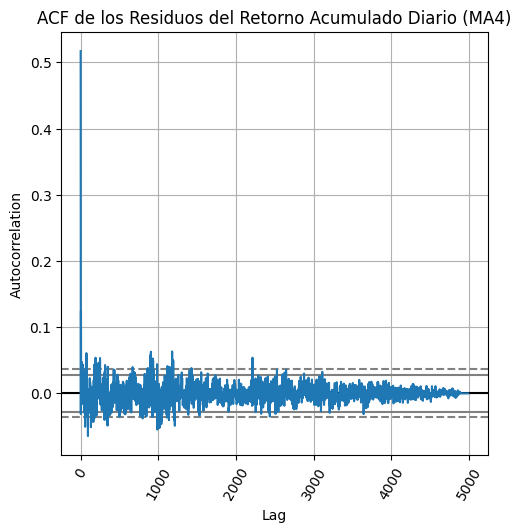

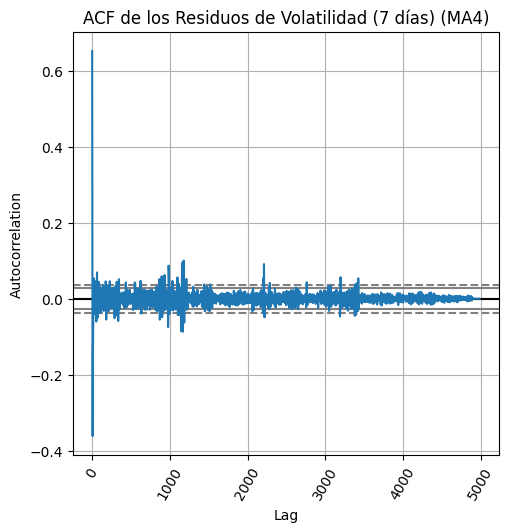

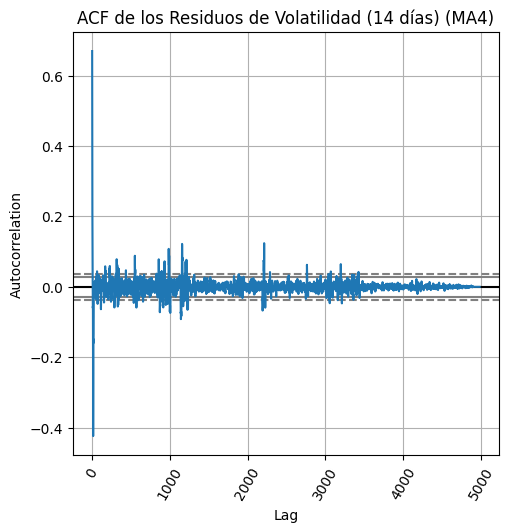

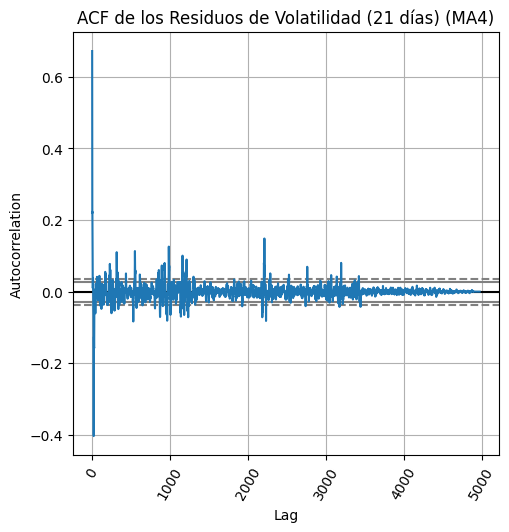

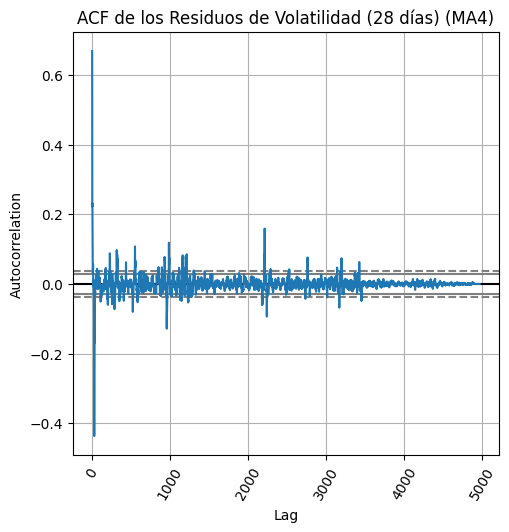

In [94]:
import matplotlib.pyplot as plt
from pandas.plotting import autocorrelation_plot

# Calcular la media móvil de 4 días para Retorno Acumulado Diario y Volatilidad en diferentes ventanas
MA4_ret_acum = data['Retorno Acumulado Diario'].rolling(window=4).mean().dropna()
MA4_vol_7d = data['Volatilidad_7_dias'].rolling(window=4).mean().dropna()
MA4_vol_14d = data['Volatilidad_14_dias'].rolling(window=4).mean().dropna()
MA4_vol_21d = data['Volatilidad_21_dias'].rolling(window=4).mean().dropna()
MA4_vol_28d = data['Volatilidad_28_dias'].rolling(window=4).mean().dropna()

# Usamos los residuos tras eliminar la tendencia con MA4 para Retorno Acumulado Diario
residuals_ret_acum = data['Retorno Acumulado Diario'] - MA4_ret_acum
residuals_ret_acum = residuals_ret_acum.dropna()  # Eliminar valores NaN

# Graficar la ACF de los residuos del Retorno Acumulado Diario
fig = plt.figure(figsize=(5.5, 5.5))
ax = fig.add_subplot(1, 1, 1)

# Generar el gráfico de autocorrelación para Retorno Acumulado Diario
autocorrelation_plot(residuals_ret_acum, ax=ax)

# Añadir título y ajustes
ax.set_title('ACF de los Residuos del Retorno Acumulado Diario (MA4)')
plt.xticks(rotation=60)
plt.show()

# Usamos los residuos tras eliminar la tendencia con MA4 para Volatilidad (7 días)
residuals_vol_7d = data['Volatilidad_7_dias'] - MA4_vol_7d
residuals_vol_7d = residuals_vol_7d.dropna()  # Eliminar valores NaN

# Graficar la ACF de los residuos de Volatilidad (7 días)
fig = plt.figure(figsize=(5.5, 5.5))
ax = fig.add_subplot(1, 1, 1)

# Generar el gráfico de autocorrelación para Volatilidad (7 días)
autocorrelation_plot(residuals_vol_7d, ax=ax)

# Añadir título y ajustes
ax.set_title('ACF de los Residuos de Volatilidad (7 días) (MA4)')
plt.xticks(rotation=60)
plt.show()

# Usamos los residuos tras eliminar la tendencia con MA4 para Volatilidad (14 días)
residuals_vol_14d = data['Volatilidad_14_dias'] - MA4_vol_14d
residuals_vol_14d = residuals_vol_14d.dropna()  # Eliminar valores NaN

# Graficar la ACF de los residuos de Volatilidad (14 días)
fig = plt.figure(figsize=(5.5, 5.5))
ax = fig.add_subplot(1, 1, 1)

# Generar el gráfico de autocorrelación para Volatilidad (14 días)
autocorrelation_plot(residuals_vol_14d, ax=ax)

# Añadir título y ajustes
ax.set_title('ACF de los Residuos de Volatilidad (14 días) (MA4)')
plt.xticks(rotation=60)
plt.show()

# Usamos los residuos tras eliminar la tendencia con MA4 para Volatilidad (21 días)
residuals_vol_21d = data['Volatilidad_21_dias'] - MA4_vol_21d
residuals_vol_21d = residuals_vol_21d.dropna()  # Eliminar valores NaN

# Graficar la ACF de los residuos de Volatilidad (21 días)
fig = plt.figure(figsize=(5.5, 5.5))
ax = fig.add_subplot(1, 1, 1)

# Generar el gráfico de autocorrelación para Volatilidad (21 días)
autocorrelation_plot(residuals_vol_21d, ax=ax)

# Añadir título y ajustes
ax.set_title('ACF de los Residuos de Volatilidad (21 días) (MA4)')
plt.xticks(rotation=60)
plt.show()

# Usamos los residuos tras eliminar la tendencia con MA4 para Volatilidad (28 días)
residuals_vol_28d = data['Volatilidad_28_dias'] - MA4_vol_28d
residuals_vol_28d = residuals_vol_28d.dropna()  # Eliminar valores NaN

# Graficar la ACF de los residuos de Volatilidad (28 días)
fig = plt.figure(figsize=(5.5, 5.5))
ax = fig.add_subplot(1, 1, 1)

# Generar el gráfico de autocorrelación para Volatilidad (28 días)
autocorrelation_plot(residuals_vol_28d, ax=ax)

# Añadir título y ajustes
ax.set_title('ACF de los Residuos de Volatilidad (28 días) (MA4)')
plt.xticks(rotation=60)
plt.show()


Tras eliminar la tendencia utilizando la media móvil de 4 días (MA4), la mayor parte de los residuos parecen ser independientes (sin correlación significativa), ya que los coeficientes de autocorrelación caen dentro de los intervalos de confianza después de los primeros rezagos.
La disminución de la autocorrelación a medida que aumenta el lag sugiere que los residuos no presentan patrones evidentes, lo que puede ser una buena señal de que el componente de tendencia ha sido eliminado adecuadamente.

In [95]:
import numpy as np
from statsmodels.tsa import stattools

# Aplicar la función ACF con el cálculo de la estadística Q y p-valores para Retorno Acumulado Diario
acf_values_ret_acum, confint_ret_acum, qstat_ret_acum, pval_residuals_ret_acum = stattools.acf(residuals_ret_acum, nlags=10, qstat=True, alpha=0.05)

# Verificando en qué rezagos se rechaza la hipótesis nula para Retorno Acumulado Diario
significant_lags_ret_acum = np.where(pval_residuals_ret_acum <= 0.05)
print('Para Retorno Acumulado Diario, se rechaza la hipótesis nula en los rezagos:', significant_lags_ret_acum)

# Aplicar la función ACF con el cálculo de la estadística Q y p-valores para Volatilidad (7 días)
acf_values_vol_7d, confint_vol_7d, qstat_vol_7d, pval_residuals_vol_7d = stattools.acf(residuals_vol_7d, nlags=10, qstat=True, alpha=0.05)

# Verificando en qué rezagos se rechaza la hipótesis nula para Volatilidad (7 días)
significant_lags_vol_7d = np.where(pval_residuals_vol_7d <= 0.05)
print('Para Volatilidad (7 días), se rechaza la hipótesis nula en los rezagos:', significant_lags_vol_7d)

# Aplicar la función ACF con el cálculo de la estadística Q y p-valores para Volatilidad (14 días)
acf_values_vol_14d, confint_vol_14d, qstat_vol_14d, pval_residuals_vol_14d = stattools.acf(residuals_vol_14d, nlags=10, qstat=True, alpha=0.05)

# Verificando en qué rezagos se rechaza la hipótesis nula para Volatilidad (14 días)
significant_lags_vol_14d = np.where(pval_residuals_vol_14d <= 0.05)
print('Para Volatilidad (14 días), se rechaza la hipótesis nula en los rezagos:', significant_lags_vol_14d)

# Aplicar la función ACF con el cálculo de la estadística Q y p-valores para Volatilidad (21 días)
acf_values_vol_21d, confint_vol_21d, qstat_vol_21d, pval_residuals_vol_21d = stattools.acf(residuals_vol_21d, nlags=10, qstat=True, alpha=0.05)

# Verificando en qué rezagos se rechaza la hipótesis nula para Volatilidad (21 días)
significant_lags_vol_21d = np.where(pval_residuals_vol_21d <= 0.05)
print('Para Volatilidad (21 días), se rechaza la hipótesis nula en los rezagos:', significant_lags_vol_21d)

# Aplicar la función ACF con el cálculo de la estadística Q y p-valores para Volatilidad (28 días)
acf_values_vol_28d, confint_vol_28d, qstat_vol_28d, pval_residuals_vol_28d = stattools.acf(residuals_vol_28d, nlags=10, qstat=True, alpha=0.05)

# Verificando en qué rezagos se rechaza la hipótesis nula para Volatilidad (28 días)
significant_lags_vol_28d = np.where(pval_residuals_vol_28d <= 0.05)
print('Para Volatilidad (28 días), se rechaza la hipótesis nula en los rezagos:', significant_lags_vol_28d)


Para Retorno Acumulado Diario, se rechaza la hipótesis nula en los rezagos: (array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=int64),)
Para Volatilidad (7 días), se rechaza la hipótesis nula en los rezagos: (array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=int64),)
Para Volatilidad (14 días), se rechaza la hipótesis nula en los rezagos: (array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=int64),)
Para Volatilidad (21 días), se rechaza la hipótesis nula en los rezagos: (array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=int64),)
Para Volatilidad (28 días), se rechaza la hipótesis nula en los rezagos: (array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=int64),)


El hecho de que haya autocorrelación en los residuos significa que los modelos simples basados en medias móviles o modelos lineales no son suficientes para capturar completamente las características de estas series de tiempo.

#### Prueba ADF - Ljung Box en residuos 

In [96]:
import pandas as pd
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.diagnostic import acorr_ljungbox

# Realiza las pruebas Dickey-Fuller y Ljung-Box para cada una de las series de residuos.

# Función para aplicar Dickey-Fuller y Ljung-Box
def apply_tests(series_name, residuals):
    print(f"\n--- Análisis de la serie: {series_name} ---")
    
    # Prueba de Dickey-Fuller sobre los residuos
    print("Prueba Dickey-Fuller sobre los residuos:")
    adf_test = adfuller(residuals.dropna(), autolag='AIC')
    print(f"ADF Statistic: {adf_test[0]}")
    print(f"p-value: {adf_test[1]}")
    print("Critical Values:")
    for key, value in adf_test[4].items():
        print(f"   {key}: {value}")
    
    # Prueba de Ljung-Box para autocorrelación en los residuos
    print("\nPrueba de Ljung-Box sobre los residuos:")
    lb_test = acorr_ljungbox(residuals.dropna(), lags=[10], return_df=True)
    print(lb_test)

# Residuales del Retorno Acumulado Diario
apply_tests('Retorno Acumulado Diario', residuals_ret_acum)

# Residuales de la Volatilidad (7 días)
apply_tests('Volatilidad (7 días)', residuals_vol_7d)

# Residuales de la Volatilidad (14 días)
apply_tests('Volatilidad (14 días)', residuals_vol_14d)

# Residuales de la Volatilidad (21 días)
apply_tests('Volatilidad (21 días)', residuals_vol_21d)

# Residuales de la Volatilidad (28 días)
apply_tests('Volatilidad (28 días)', residuals_vol_28d)



--- Análisis de la serie: Retorno Acumulado Diario ---
Prueba Dickey-Fuller sobre los residuos:
ADF Statistic: -10.251120892731853
p-value: 4.482971395521674e-18
Critical Values:
   1%: -3.431670688657576
   5%: -2.862123600382394
   10%: -2.567080651396155

Prueba de Ljung-Box sobre los residuos:
        lb_stat  lb_pvalue
10  1540.351708        0.0

--- Análisis de la serie: Volatilidad (7 días) ---
Prueba Dickey-Fuller sobre los residuos:
ADF Statistic: -18.807408844285025
p-value: 2.022571999574763e-30
Critical Values:
   1%: -3.431670421982744
   5%: -2.8621234825673536
   10%: -2.5670805886785306

Prueba de Ljung-Box sobre los residuos:
        lb_stat  lb_pvalue
10  4465.032701        0.0

--- Análisis de la serie: Volatilidad (14 días) ---
Prueba Dickey-Fuller sobre los residuos:
ADF Statistic: -17.580837689425657
p-value: 4.0080850416363874e-30
Critical Values:
   1%: -3.431671756434938
   5%: -2.862124072118718
   10%: -2.567080902520151

Prueba de Ljung-Box sobre los residu

En todas las series (Retorno Acumulado Diario y las Volatilidades de 7, 14, 21, y 28 días), el valor de la estadística ADF es muy negativo y el p-valor es extremadamente bajo, lo que indica que se rechaza la hipótesis nula de no estacionariedad.
Esto sugiere que los residuos de todas estas series son estacionarios, lo cual es un resultado positivo para el análisis, ya que los residuos deberían comportarse de manera estacionaria si la tendencia ha sido eliminada correctamente.

De la prueba de Ljung-box los p-valores son 0, lo que implica que se rechaza la hipótesis nula de independencia de los residuos en los primeros 10 rezagos.
Este resultado indica que existe autocorrelación significativa en los residuos, lo cual podría ser problemático ya que los residuos no deberían estar correlacionados entre sí si el modelo captura correctamente la estructura de la serie de tiempo.

#### Descomposición de las series temporales usando medias Moviles 

In [97]:
import pandas as pd

# Para Retorno Acumulado Diario

# Calcular la media móvil de 12 periodos para la tendencia
MA12_ret_acum = data['Retorno Acumulado Diario'].rolling(window=12).mean()

# Aplicar una segunda media móvil para suavizar más la tendencia
trendComp_ret_acum = MA12_ret_acum.rolling(window=2).mean()

# Eliminar los valores NaN
trendComp_ret_acum_clean = trendComp_ret_acum.dropna()

# Mostrar los valores no nulos de la tendencia
print("Tendencia suavizada (2x12) - Retorno Acumulado Diario:")
print(trendComp_ret_acum_clean.head(10))

# Para Volatilidad (7 días)

# Calcular la media móvil de 12 periodos para la tendencia
MA12_vol_7d = data['Volatilidad_7_dias'].rolling(window=12).mean()

# Aplicar una segunda media móvil para suavizar más la tendencia
trendComp_vol_7d = MA12_vol_7d.rolling(window=2).mean()

# Eliminar los valores NaN
trendComp_vol_7d_clean = trendComp_vol_7d.dropna()

# Mostrar los valores no nulos de la tendencia
print("\nTendencia suavizada (2x12) - Volatilidad (7 días):")
print(trendComp_vol_7d_clean.head(10))

# Para Volatilidad (14 días)

# Calcular la media móvil de 12 periodos para la tendencia
MA12_vol_14d = data['Volatilidad_14_dias'].rolling(window=12).mean()

# Aplicar una segunda media móvil para suavizar más la tendencia
trendComp_vol_14d = MA12_vol_14d.rolling(window=2).mean()

# Eliminar los valores NaN
trendComp_vol_14d_clean = trendComp_vol_14d.dropna()

# Mostrar los valores no nulos de la tendencia
print("\nTendencia suavizada (2x12) - Volatilidad (14 días):")
print(trendComp_vol_14d_clean.head(10))

# Para Volatilidad (21 días)

# Calcular la media móvil de 12 periodos para la tendencia
MA12_vol_21d = data['Volatilidad_21_dias'].rolling(window=12).mean()

# Aplicar una segunda media móvil para suavizar más la tendencia
trendComp_vol_21d = MA12_vol_21d.rolling(window=2).mean()

# Eliminar los valores NaN
trendComp_vol_21d_clean = trendComp_vol_21d.dropna()

# Mostrar los valores no nulos de la tendencia
print("\nTendencia suavizada (2x12) - Volatilidad (21 días):")
print(trendComp_vol_21d_clean.head(10))

# Para Volatilidad (28 días)

# Calcular la media móvil de 12 periodos para la tendencia
MA12_vol_28d = data['Volatilidad_28_dias'].rolling(window=12).mean()

# Aplicar una segunda media móvil para suavizar más la tendencia
trendComp_vol_28d = MA12_vol_28d.rolling(window=2).mean()

# Eliminar los valores NaN
trendComp_vol_28d_clean = trendComp_vol_28d.dropna()

# Mostrar los valores no nulos de la tendencia
print("\nTendencia suavizada (2x12) - Volatilidad (28 días):")
print(trendComp_vol_28d_clean.head(10))


Tendencia suavizada (2x12) - Retorno Acumulado Diario:
Date
2024-03-03    0.036485
2024-03-02    0.027297
2024-03-01    0.015493
2024-02-29    0.003070
2024-02-28   -0.008745
2024-02-27   -0.021841
2024-02-26   -0.038243
2024-02-25   -0.058156
2024-02-24   -0.079387
2024-02-23   -0.100123
Name: Retorno Acumulado Diario, dtype: float64

Tendencia suavizada (2x12) - Volatilidad (7 días):
Date
2024-03-03    0.037433
2024-03-02    0.036002
2024-03-01    0.034616
2024-02-29    0.033860
2024-02-28    0.034224
2024-02-27    0.035259
2024-02-26    0.036042
2024-02-25    0.036714
2024-02-24    0.037845
2024-02-23    0.039288
Name: Volatilidad_7_dias, dtype: float64

Tendencia suavizada (2x12) - Volatilidad (14 días):
Date
2024-02-27    0.040112
2024-02-26    0.039491
2024-02-25    0.038976
2024-02-24    0.038484
2024-02-23    0.038025
2024-02-22    0.037869
2024-02-21    0.038146
2024-02-20    0.038367
2024-02-19    0.038117
2024-02-18    0.037653
Name: Volatilidad_14_dias, dtype: float64

Tend

En conjunto, estos cálculos de medias móviles proporcionan una tendencia subyacente de cada serie, ayudando a entender su comportamiento más estable al eliminar el ruido causado por variaciones a corto plazo

##### Estimar el componente estacional de las series 

In [98]:
import pandas as pd

# Calcular los residuos restando la tendencia de la serie de Retorno Acumulado Diario
residuals_ret_acum = data['Retorno Acumulado Diario'] - trendComp_ret_acum

# Agrupar los residuos por mes para calcular la estacionalidad del Retorno Acumulado Diario
data['Month'] = data.index.month.astype(str).str.zfill(2)
monthwise_avg_ret_acum = residuals_ret_acum.groupby(data['Month']).mean()

# Expandir el componente estacional a todo el conjunto de datos del Retorno Acumulado Diario
nb_years_ret_acum = len(data) // 12
seasonalComp_ret_acum = pd.Series([monthwise_avg_ret_acum.values] * nb_years_ret_acum).explode().reset_index(drop=True)

# Mostrar el componente estacional del Retorno Acumulado Diario
print("Componente estacional - Retorno Acumulado Diario:")
print(seasonalComp_ret_acum.head(10))

# Repetir el proceso para la Volatilidad (7 días)
residuals_vol_7d = data['Volatilidad_7_dias'] - trendComp_vol_7d
monthwise_avg_vol_7d = residuals_vol_7d.groupby(data['Month']).mean()
nb_years_vol_7d = len(data) // 12
seasonalComp_vol_7d = pd.Series([monthwise_avg_vol_7d.values] * nb_years_vol_7d).explode().reset_index(drop=True)

print("\nComponente estacional - Volatilidad (7 días):")
print(seasonalComp_vol_7d.head(10))

# Repetir el proceso para la Volatilidad (14 días)
residuals_vol_14d = data['Volatilidad_14_dias'] - trendComp_vol_14d
monthwise_avg_vol_14d = residuals_vol_14d.groupby(data['Month']).mean()
nb_years_vol_14d = len(data) // 12
seasonalComp_vol_14d = pd.Series([monthwise_avg_vol_14d.values] * nb_years_vol_14d).explode().reset_index(drop=True)

print("\nComponente estacional - Volatilidad (14 días):")
print(seasonalComp_vol_14d.head(10))

# Repetir el proceso para la Volatilidad (21 días)
residuals_vol_21d = data['Volatilidad_21_dias'] - trendComp_vol_21d
monthwise_avg_vol_21d = residuals_vol_21d.groupby(data['Month']).mean()
nb_years_vol_21d = len(data) // 12
seasonalComp_vol_21d = pd.Series([monthwise_avg_vol_21d.values] * nb_years_vol_21d).explode().reset_index(drop=True)

print("\nComponente estacional - Volatilidad (21 días):")
print(seasonalComp_vol_21d.head(10))

# Repetir el proceso para la Volatilidad (28 días)
residuals_vol_28d = data['Volatilidad_28_dias'] - trendComp_vol_28d
monthwise_avg_vol_28d = residuals_vol_28d.groupby(data['Month']).mean()
nb_years_vol_28d = len(data) // 12
seasonalComp_vol_28d = pd.Series([monthwise_avg_vol_28d.values] * nb_years_vol_28d).explode().reset_index(drop=True)

print("\nComponente estacional - Volatilidad (28 días):")
print(seasonalComp_vol_28d.head(10))


Componente estacional - Retorno Acumulado Diario:
0   -0.002605
1    0.008949
2   -0.002854
3    -0.02356
4   -0.025852
5    0.011962
6    -0.00849
7     0.00948
8    0.014936
9   -0.029746
dtype: object

Componente estacional - Volatilidad (7 días):
0    0.000714
1    0.000606
2   -0.000974
3    0.001299
4   -0.001984
5    0.002996
6   -0.000967
7    0.000559
8     0.00227
9   -0.006755
dtype: object

Componente estacional - Volatilidad (14 días):
0    0.000813
1    0.001016
2    0.000165
3    0.001131
4   -0.002098
5     0.00312
6   -0.001099
7    0.001145
8    0.001423
9   -0.007032
dtype: object

Componente estacional - Volatilidad (21 días):
0   -0.002268
1    0.003782
2    0.000638
3    0.000878
4   -0.001691
5    0.002748
6   -0.001561
7    0.001581
8   -0.000383
9   -0.004868
dtype: object

Componente estacional - Volatilidad (28 días):
0   -0.002517
1     0.00376
2    0.000504
3    0.000834
4   -0.001409
5    0.002163
6   -0.000974
7    0.001519
8   -0.001659
9   -0.003686
dty

Estos componentes estacionales muestran que, aunque los efectos estacionales en la volatilidad y el retorno acumulado diario existen, son generalmente pequeños en magnitud y reflejan las variaciones recurrentes en el comportamiento de estas series a lo largo del tiempo. Esto sugiere que hay ciertos meses en los que se espera una mayor volatilidad o retornos, lo que puede ser clave para hacer predicciones o tomar decisiones.

##### Variaciones irregulares de los residuos 

In [99]:
import numpy as np
import pandas as pd

# Para Retorno Acumulado Diario
# Suponiendo que ya has restado la tendencia
residuals_ret_acum = data['Retorno Acumulado Diario'] - trendComp_ret_acum_clean  # Restar la tendencia para obtener los residuos

# Extraer el mes de la serie original
data['Month'] = data.index.month

# Calcular las medias mensuales de los residuos
monthwise_avg_ret_acum = residuals_ret_acum.groupby(data['Month']).mean()

# Ajustar la longitud del componente estacional
nb_months = len(data)  # Número total de meses en los datos
seasonalComp_ret_acum = np.tile(monthwise_avg_ret_acum.values, nb_months // 12 + 1)[:nb_months]  # Ajustar la longitud

# Alinear el componente estacional con el índice de la serie original
seasonalComp_ret_acum_aligned = pd.Series(seasonalComp_ret_acum, index=data.index)

# Calcular las variaciones irregulares
irr_var_ret_acum = data['Retorno Acumulado Diario'] - trendComp_ret_acum_clean - seasonalComp_ret_acum_aligned

# Eliminar los NaN que puedan quedar
irr_var_ret_acum_clean = irr_var_ret_acum.dropna()

# Verificar los primeros valores
print("Variaciones Irregulares - Retorno Acumulado Diario:")
print(irr_var_ret_acum_clean.head())

# Para Volatilidad (7 días)
# Suponiendo que ya has restado la tendencia
residuals_vol_7d = data['Volatilidad_7_dias'] - trendComp_vol_7d_clean  # Restar la tendencia para obtener los residuos

# Calcular las medias mensuales de los residuos
monthwise_avg_vol_7d = residuals_vol_7d.groupby(data['Month']).mean()

# Ajustar la longitud del componente estacional
seasonalComp_vol_7d = np.tile(monthwise_avg_vol_7d.values, nb_months // 12 + 1)[:nb_months]  # Ajustar la longitud

# Alinear el componente estacional con el índice de la serie original
seasonalComp_vol_7d_aligned = pd.Series(seasonalComp_vol_7d, index=data.index)

# Calcular las variaciones irregulares
irr_var_vol_7d = data['Volatilidad_7_dias'] - trendComp_vol_7d_clean - seasonalComp_vol_7d_aligned

# Eliminar los NaN que puedan quedar
irr_var_vol_7d_clean = irr_var_vol_7d.dropna()

# Verificar los primeros valores
print("Variaciones Irregulares - Volatilidad (7 días):")
print(irr_var_vol_7d_clean.head())

# Puedes repetir el mismo proceso para las demás series de volatilidad.


Variaciones Irregulares - Retorno Acumulado Diario:
Date
2010-07-18    0.029746
2010-07-19   -0.014936
2010-07-20   -0.009480
2010-07-21    0.008490
2010-07-22   -0.011962
Freq: D, dtype: float64
Variaciones Irregulares - Volatilidad (7 días):
Date
2010-07-18    0.006755
2010-07-19   -0.002270
2010-07-20   -0.000559
2010-07-21    0.000967
2010-07-22   -0.002996
Freq: D, dtype: float64


In [101]:
import plotly.graph_objs as go
from plotly.subplots import make_subplots

# Crear la figura con subplots
fig = make_subplots(
    rows=5, cols=1, shared_xaxes=True, 
    subplot_titles=(
        'Retorno Acumulado Diario', 
        'Volatilidad (7 días)', 
        'Volatilidad (14 días)', 
        'Volatilidad (21 días)', 
        'Volatilidad (28 días)'
    )
)

# Graficar el Retorno Acumulado Diario
fig.add_trace(go.Scatter(
    x=data.index, 
    y=data['Retorno Acumulado Diario'], 
    mode='lines', 
    name='Retorno Acumulado Diario', 
    line=dict(color='blue')
), row=1, col=1)

# Graficar la Volatilidad (7 días)
fig.add_trace(go.Scatter(
    x=data.index, 
    y=data['Volatilidad_7_dias'], 
    mode='lines', 
    name='Volatilidad (7 días)', 
    line=dict(color='red')
), row=2, col=1)

# Graficar la Volatilidad (14 días)
fig.add_trace(go.Scatter(
    x=data.index, 
    y=data['Volatilidad_14_dias'], 
    mode='lines', 
    name='Volatilidad (14 días)', 
    line=dict(color='green')
), row=3, col=1)

# Graficar la Volatilidad (21 días)
fig.add_trace(go.Scatter(
    x=data.index, 
    y=data['Volatilidad_21_dias'], 
    mode='lines', 
    name='Volatilidad (21 días)', 
    line=dict(color='orange')
), row=4, col=1)

# Graficar la Volatilidad (28 días)
fig.add_trace(go.Scatter(
    x=data.index, 
    y=data['Volatilidad_28_dias'], 
    mode='lines', 
    name='Volatilidad (28 días)', 
    line=dict(color='purple')
), row=5, col=1)

# Actualizar layout del gráfico
fig.update_layout(
    title='Series de Retorno Acumulado Diario y Volatilidad (7, 14, 21, 28 días)',
    height=1000,
    width=900,
    template="plotly_white"
)

# Etiquetas para los ejes
fig.update_yaxes(title_text="Retorno", row=1, col=1)
fig.update_yaxes(title_text="Volatilidad", row=2, col=1)
fig.update_yaxes(title_text="Volatilidad", row=3, col=1)
fig.update_yaxes(title_text="Volatilidad", row=4, col=1)
fig.update_yaxes(title_text="Volatilidad", row=5, col=1)

# Etiqueta del eje X solo en la última gráfica
fig.update_xaxes(title_text="Fecha", row=5, col=1)

# Mostrar el gráfico
fig.show()


In [103]:
import plotly.graph_objs as go

# Graficar el componente de tendencia para Retorno Acumulado Diario
fig_trend_ret_acum = go.Figure()
fig_trend_ret_acum.add_trace(go.Scatter(
    x=data.index, 
    y=trendComp_ret_acum_clean, 
    mode='lines', 
    name='Tendencia Retorno Acumulado Diario', 
    line=dict(color='red')
))
fig_trend_ret_acum.update_layout(
    title='Componente de Tendencia - Retorno Acumulado Diario', 
    xaxis_title='Fecha', 
    yaxis_title='Retorno', 
    template="plotly_white"
)
fig_trend_ret_acum.show()

# Graficar el componente de tendencia para Volatilidad (7 días)
fig_trend_vol_7d = go.Figure()
fig_trend_vol_7d.add_trace(go.Scatter(
    x=data.index, 
    y=trendComp_vol_7d_clean, 
    mode='lines', 
    name='Tendencia Volatilidad (7 días)', 
    line=dict(color='green')
))
fig_trend_vol_7d.update_layout(
    title='Componente de Tendencia - Volatilidad (7 días)', 
    xaxis_title='Fecha', 
    yaxis_title='Volatilidad', 
    template="plotly_white"
)
fig_trend_vol_7d.show()

# Graficar el componente de tendencia para Volatilidad (14 días)
fig_trend_vol_14d = go.Figure()
fig_trend_vol_14d.add_trace(go.Scatter(
    x=data.index, 
    y=trendComp_vol_14d_clean, 
    mode='lines', 
    name='Tendencia Volatilidad (14 días)', 
    line=dict(color='blue')
))
fig_trend_vol_14d.update_layout(
    title='Componente de Tendencia - Volatilidad (14 días)', 
    xaxis_title='Fecha', 
    yaxis_title='Volatilidad', 
    template="plotly_white"
)
fig_trend_vol_14d.show()

# Graficar el componente de tendencia para Volatilidad (21 días)
fig_trend_vol_21d = go.Figure()
fig_trend_vol_21d.add_trace(go.Scatter(
    x=data.index, 
    y=trendComp_vol_21d_clean, 
    mode='lines', 
    name='Tendencia Volatilidad (21 días)', 
    line=dict(color='orange')
))
fig_trend_vol_21d.update_layout(
    title='Componente de Tendencia - Volatilidad (21 días)', 
    xaxis_title='Fecha', 
    yaxis_title='Volatilidad', 
    template="plotly_white"
)
fig_trend_vol_21d.show()

# Graficar el componente de tendencia para Volatilidad (28 días)
fig_trend_vol_28d = go.Figure()
fig_trend_vol_28d.add_trace(go.Scatter(
    x=data.index, 
    y=trendComp_vol_28d_clean, 
    mode='lines', 
    name='Tendencia Volatilidad (28 días)', 
    line=dict(color='purple')
))
fig_trend_vol_28d.update_layout(
    title='Componente de Tendencia - Volatilidad (28 días)', 
    xaxis_title='Fecha', 
    yaxis_title='Volatilidad', 
    template="plotly_white"
)
fig_trend_vol_28d.show()


In [110]:
import numpy as np
import pandas as pd

# Calcular el componente estacional para cada ventana de volatilidad y retorno acumulado

# Para Volatilidad (7 días)
seasonalComp_vol_7d = residuals_vol_7d.groupby(data['Month']).mean()
seasonalComp_vol_7d_aligned = np.tile(seasonalComp_vol_7d.values, len(data) // 12 + 1)[:len(data)]
seasonalComp_vol_7d_aligned = pd.Series(seasonalComp_vol_7d_aligned, index=data.index)

# Para Volatilidad (14 días)
seasonalComp_vol_14d = residuals_vol_14d.groupby(data['Month']).mean()
seasonalComp_vol_14d_aligned = np.tile(seasonalComp_vol_14d.values, len(data) // 12 + 1)[:len(data)]
seasonalComp_vol_14d_aligned = pd.Series(seasonalComp_vol_14d_aligned, index=data.index)

# Para Volatilidad (21 días)
seasonalComp_vol_21d = residuals_vol_21d.groupby(data['Month']).mean()
seasonalComp_vol_21d_aligned = np.tile(seasonalComp_vol_21d.values, len(data) // 12 + 1)[:len(data)]
seasonalComp_vol_21d_aligned = pd.Series(seasonalComp_vol_21d_aligned, index=data.index)

# Para Volatilidad (28 días)
seasonalComp_vol_28d = residuals_vol_28d.groupby(data['Month']).mean()
seasonalComp_vol_28d_aligned = np.tile(seasonalComp_vol_28d.values, len(data) // 12 + 1)[:len(data)]
seasonalComp_vol_28d_aligned = pd.Series(seasonalComp_vol_28d_aligned, index=data.index)

# Para Retorno Acumulado Diario
seasonalComp_ret_acum = residuals_ret_acum.groupby(data['Month']).mean()
seasonalComp_ret_acum_aligned = np.tile(seasonalComp_ret_acum.values, len(data) // 12 + 1)[:len(data)]
seasonalComp_ret_acum_aligned = pd.Series(seasonalComp_ret_acum_aligned, index=data.index)

# Calcular las variaciones irregulares para Retorno Acumulado Diario
irr_var_ret_acum = data['Retorno Acumulado Diario'] - trendComp_ret_acum_clean - seasonalComp_ret_acum_aligned
irr_var_ret_acum = irr_var_ret_acum.dropna()

# Calcular las variaciones irregulares para Volatilidad (7 días)
irr_var_vol_7d = data['Volatilidad_7_dias'] - trendComp_vol_7d_clean - seasonalComp_vol_7d_aligned
irr_var_vol_7d = irr_var_vol_7d.dropna()

# Calcular las variaciones irregulares para Volatilidad (14 días)
irr_var_vol_14d = data['Volatilidad_14_dias'] - trendComp_vol_14d_clean - seasonalComp_vol_14d_aligned
irr_var_vol_14d = irr_var_vol_14d.dropna()

# Calcular las variaciones irregulares para Volatilidad (21 días)
irr_var_vol_21d = data['Volatilidad_21_dias'] - trendComp_vol_21d_clean - seasonalComp_vol_21d_aligned
irr_var_vol_21d = irr_var_vol_21d.dropna()

# Calcular las variaciones irregulares para Volatilidad (28 días)
irr_var_vol_28d = data['Volatilidad_28_dias'] - trendComp_vol_28d_clean - seasonalComp_vol_28d_aligned
irr_var_vol_28d = irr_var_vol_28d.dropna()


In [108]:
import plotly.graph_objs as go

# Crear un gráfico para visualizar las variaciones irregulares para Retorno Acumulado Diario
fig_irr_ret_acum = go.Figure()
fig_irr_ret_acum.add_trace(go.Scatter(
    x=irr_var_ret_acum.index, 
    y=irr_var_ret_acum, 
    mode='lines', 
    name='Variaciones Irregulares Retorno Acumulado Diario', 
    line=dict(color='black')
))
fig_irr_ret_acum.update_layout(
    title="Variaciones Irregulares - Retorno Acumulado Diario", 
    xaxis_title="Fecha", 
    yaxis_title="Variaciones Irregulares"
)
fig_irr_ret_acum.show()

# Crear un gráfico para visualizar las variaciones irregulares para Volatilidad (7 días)
fig_irr_vol_7d = go.Figure()
fig_irr_vol_7d.add_trace(go.Scatter(
    x=irr_var_vol_7d.index, 
    y=irr_var_vol_7d, 
    mode='lines', 
    name='Variaciones Irregulares Volatilidad (7 días)', 
    line=dict(color='black')
))
fig_irr_vol_7d.update_layout(
    title="Variaciones Irregulares - Volatilidad (7 días)", 
    xaxis_title="Fecha", 
    yaxis_title="Variaciones Irregulares"
)
fig_irr_vol_7d.show()

# Crear un gráfico para visualizar las variaciones irregulares para Volatilidad (14 días)
fig_irr_vol_14d = go.Figure()
fig_irr_vol_14d.add_trace(go.Scatter(
    x=irr_var_vol_14d.index, 
    y=irr_var_vol_14d, 
    mode='lines', 
    name='Variaciones Irregulares Volatilidad (14 días)', 
    line=dict(color='black')
))
fig_irr_vol_14d.update_layout(
    title="Variaciones Irregulares - Volatilidad (14 días)", 
    xaxis_title="Fecha", 
    yaxis_title="Variaciones Irregulares"
)
fig_irr_vol_14d.show()

# Crear un gráfico para visualizar las variaciones irregulares para Volatilidad (21 días)
fig_irr_vol_21d = go.Figure()
fig_irr_vol_21d.add_trace(go.Scatter(
    x=irr_var_vol_21d.index, 
    y=irr_var_vol_21d, 
    mode='lines', 
    name='Variaciones Irregulares Volatilidad (21 días)', 
    line=dict(color='black')
))
fig_irr_vol_21d.update_layout(
    title="Variaciones Irregulares - Volatilidad (21 días)", 
    xaxis_title="Fecha", 
    yaxis_title="Variaciones Irregulares"
)
fig_irr_vol_21d.show()

# Crear un gráfico para visualizar las variaciones irregulares para Volatilidad (28 días)
fig_irr_vol_28d = go.Figure()
fig_irr_vol_28d.add_trace(go.Scatter(
    x=irr_var_vol_28d.index, 
    y=irr_var_vol_28d, 
    mode='lines', 
    name='Variaciones Irregulares Volatilidad (28 días)', 
    line=dict(color='black')
))
fig_irr_vol_28d.update_layout(
    title="Variaciones Irregulares - Volatilidad (28 días)", 
    xaxis_title="Fecha", 
    yaxis_title="Variaciones Irregulares"
)
fig_irr_vol_28d.show()


##### Validacion estacionalidad con ADF

In [111]:
from statsmodels.tsa.stattools import adfuller

# Prueba ADF para las variaciones irregulares de Retorno Acumulado Diario
adf_result_ret_acum = adfuller(irr_var_ret_acum.dropna(), autolag='AIC')
print('--- ADF Test para Retorno Acumulado Diario ---')
print(f'ADF Statistic: {adf_result_ret_acum[0]}')
print(f'p-value: {adf_result_ret_acum[1]}')
print('Critical Values:')
for key, value in adf_result_ret_acum[4].items():
    print(f'   {key}: {value}')

# Prueba ADF para las variaciones irregulares de Volatilidad (7 días)
adf_result_vol_7d = adfuller(irr_var_vol_7d.dropna(), autolag='AIC')
print('--- ADF Test para Volatilidad (7 días) ---')
print(f'ADF Statistic: {adf_result_vol_7d[0]}')
print(f'p-value: {adf_result_vol_7d[1]}')
print('Critical Values:')
for key, value in adf_result_vol_7d[4].items():
    print(f'   {key}: {value}')

# Prueba ADF para las variaciones irregulares de Volatilidad (14 días)
adf_result_vol_14d = adfuller(irr_var_vol_14d.dropna(), autolag='AIC')
print('--- ADF Test para Volatilidad (14 días) ---')
print(f'ADF Statistic: {adf_result_vol_14d[0]}')
print(f'p-value: {adf_result_vol_14d[1]}')
print('Critical Values:')
for key, value in adf_result_vol_14d[4].items():
    print(f'   {key}: {value}')

# Prueba ADF para las variaciones irregulares de Volatilidad (21 días)
adf_result_vol_21d = adfuller(irr_var_vol_21d.dropna(), autolag='AIC')
print('--- ADF Test para Volatilidad (21 días) ---')
print(f'ADF Statistic: {adf_result_vol_21d[0]}')
print(f'p-value: {adf_result_vol_21d[1]}')
print('Critical Values:')
for key, value in adf_result_vol_21d[4].items():
    print(f'   {key}: {value}')

# Prueba ADF para las variaciones irregulares de Volatilidad (28 días)
adf_result_vol_28d = adfuller(irr_var_vol_28d.dropna(), autolag='AIC')
print('--- ADF Test para Volatilidad (28 días) ---')
print(f'ADF Statistic: {adf_result_vol_28d[0]}')
print(f'p-value: {adf_result_vol_28d[1]}')
print('Critical Values:')
for key, value in adf_result_vol_28d[4].items():
    print(f'   {key}: {value}')


--- ADF Test para Retorno Acumulado Diario ---
ADF Statistic: -9.29523531364188
p-value: 1.1508925345449838e-15
Critical Values:
   1%: -3.4316730935871242
   5%: -2.862124662862655
   10%: -2.5670812169966704
--- ADF Test para Volatilidad (7 días) ---
ADF Statistic: -16.34346231052509
p-value: 2.980205751116637e-29
Critical Values:
   1%: -3.4316730935871242
   5%: -2.862124662862655
   10%: -2.5670812169966704
--- ADF Test para Volatilidad (14 días) ---
ADF Statistic: -14.421512748623845
p-value: 7.897816133824406e-27
Critical Values:
   1%: -3.4316744334475056
   5%: -2.862125254802786
   10%: -2.5670815321100164
--- ADF Test para Volatilidad (21 días) ---
ADF Statistic: -12.736215898142992
p-value: 9.148877852508322e-24
Critical Values:
   1%: -3.4316763138174946
   5%: -2.8621260855355035
   10%: -2.5670819743422597
--- ADF Test para Volatilidad (28 días) ---
ADF Statistic: -14.583723317799256
p-value: 4.426221622974013e-27
Critical Values:
   1%: -3.431678199534402
   5%: -2.8621

En todas las series estudiadas (Retorno Acumulado Diario y Volatilidades en diferentes ventanas), los resultados del test ADF indican que las variaciones irregulares son estacionarias. Esto significa que las series no presentan tendencia a largo plazo ni efectos de estacionalidad en sus componentes residuales tras eliminar la tendencia y estacionalidad.

In [112]:
from statsmodels.stats.diagnostic import acorr_ljungbox

# Asegúrate de que las series de variaciones irregulares estén correctamente definidas
# Si no lo están, debes calcularlas previamente

# Realizar la prueba de Ljung-Box para Retorno Acumulado Diario
print("--- Ljung-Box Test para Retorno Acumulado Diario ---")
ljung_box_test_ret_acum = acorr_ljungbox(irr_var_ret_acum.dropna(), lags=[10, 20, 30], return_df=True)
print(ljung_box_test_ret_acum)

# Realizar la prueba de Ljung-Box para Volatilidad (7 días)
print("\n--- Ljung-Box Test para Volatilidad (7 días) ---")
ljung_box_test_vol_7d = acorr_ljungbox(irr_var_vol_7d.dropna(), lags=[10, 20, 30], return_df=True)
print(ljung_box_test_vol_7d)

# Realizar la prueba de Ljung-Box para Volatilidad (14 días)
print("\n--- Ljung-Box Test para Volatilidad (14 días) ---")
ljung_box_test_vol_14d = acorr_ljungbox(irr_var_vol_14d.dropna(), lags=[10, 20, 30], return_df=True)
print(ljung_box_test_vol_14d)

# Realizar la prueba de Ljung-Box para Volatilidad (21 días)
print("\n--- Ljung-Box Test para Volatilidad (21 días) ---")
ljung_box_test_vol_21d = acorr_ljungbox(irr_var_vol_21d.dropna(), lags=[10, 20, 30], return_df=True)
print(ljung_box_test_vol_21d)

# Realizar la prueba de Ljung-Box para Volatilidad (28 días)
print("\n--- Ljung-Box Test para Volatilidad (28 días) ---")
ljung_box_test_vol_28d = acorr_ljungbox(irr_var_vol_28d.dropna(), lags=[10, 20, 30], return_df=True)
print(ljung_box_test_vol_28d)


--- Ljung-Box Test para Retorno Acumulado Diario ---
         lb_stat  lb_pvalue
10  12897.540332        0.0
20  13467.232289        0.0
30  13671.341773        0.0

--- Ljung-Box Test para Volatilidad (7 días) ---
         lb_stat  lb_pvalue
10  11223.522096        0.0
20  14068.193111        0.0
30  14099.727781        0.0

--- Ljung-Box Test para Volatilidad (14 días) ---
         lb_stat  lb_pvalue
10  14571.234498        0.0
20  20686.793979        0.0
30  21160.212829        0.0

--- Ljung-Box Test para Volatilidad (21 días) ---
         lb_stat  lb_pvalue
10  16866.302665        0.0
20  19030.776457        0.0
30  24134.468118        0.0

--- Ljung-Box Test para Volatilidad (28 días) ---
         lb_stat  lb_pvalue
10  17309.628432        0.0
20  17573.990113        0.0
30  22700.709960        0.0


Los resultados de la prueba de Ljung-Box para las diferentes series muestran que en todas las ventanas de análisis (Retorno Acumulado Diario y Volatilidades de 7, 14, 21 y 28 días), el valor de p es 0.0, lo que indica que rechazamos la hipótesis nula de que las variaciones irregulares son independientes.

Esto implica que hay autocorrelaciones significativas en los residuos de las series, sugiriendo que estas no son completamente aleatorias o independientes. Estas autocorrelaciones deben tenerse en cuenta al ajustar modelos de series temporales, ya que la no aleatoriedad en los residuos puede indicar patrones que el modelo no está capturando adecuadamente. Esto también puede motivar una revisión adicional del ajuste del modelo o la necesidad de modelar la estructura de correlación residual.

##### Descomposición de las series temporales mediante statsmodels.tsa

In [117]:
import pandas as pd
import numpy as np
from statsmodels.tsa.seasonal import seasonal_decompose
import plotly.graph_objs as go
import plotly.subplots as sp

# Eliminar valores faltantes para Retorno Acumulado Diario
data_ret_acum_clean = data['Retorno Acumulado Diario'].dropna()

# Descomponer la serie temporal usando un modelo aditivo para Retorno Acumulado Diario
decompose_ret_acum = seasonal_decompose(data_ret_acum_clean, period=30, model='additive')

# Extraer los componentes de tendencia, estacionalidad y residuos
trend_ret_acum = decompose_ret_acum.trend
seasonal_ret_acum = decompose_ret_acum.seasonal
residual_ret_acum = decompose_ret_acum.resid

# Crear un subplot con cuatro gráficos para Retorno Acumulado Diario
fig_ret_acum = sp.make_subplots(rows=4, cols=1, shared_xaxes=True, vertical_spacing=0.05,
                                subplot_titles=("Retorno Acumulado Diario Original", "Componente de Tendencia", 
                                                "Componente Estacional", "Variaciones Irregulares"))

# Graficar la serie original
fig_ret_acum.add_trace(go.Scatter(x=data_ret_acum_clean.index, y=data_ret_acum_clean, mode='lines', name='Retorno Original', line=dict(color='blue')), row=1, col=1)

# Graficar el componente de tendencia
fig_ret_acum.add_trace(go.Scatter(x=data_ret_acum_clean.index, y=trend_ret_acum, mode='lines', name='Tendencia', line=dict(color='red')), row=2, col=1)

# Graficar el componente estacional
fig_ret_acum.add_trace(go.Scatter(x=data_ret_acum_clean.index, y=seasonal_ret_acum, mode='lines', name='Estacionalidad', line=dict(color='green')), row=3, col=1)

# Graficar las variaciones irregulares (residuos)
fig_ret_acum.add_trace(go.Scatter(x=data_ret_acum_clean.index, y=residual_ret_acum, mode='lines', name='Residuos', line=dict(color='black')), row=4, col=1)

# Personalizar el diseño de la gráfica
fig_ret_acum.update_layout(height=800, width=900, title_text="Descomposición de la Serie Temporal - Retorno Acumulado Diario", showlegend=False)

# Mostrar la gráfica
fig_ret_acum.show()

# Repetir el proceso para Volatilidad (7 días)
data_vol_7d_clean = data['Volatilidad_7_dias'].dropna()
decompose_vol_7d = seasonal_decompose(data_vol_7d_clean, period=30, model='additive')

# Extraer los componentes
trend_vol_7d = decompose_vol_7d.trend
seasonal_vol_7d = decompose_vol_7d.seasonal
residual_vol_7d = decompose_vol_7d.resid

# Crear un subplot con cuatro gráficos para Volatilidad (7 días)
fig_vol_7d = sp.make_subplots(rows=4, cols=1, shared_xaxes=True, vertical_spacing=0.05,
                              subplot_titles=("Volatilidad (7 días) Original", "Componente de Tendencia", 
                                              "Componente Estacional", "Variaciones Irregulares"))

# Graficar la serie original
fig_vol_7d.add_trace(go.Scatter(x=data_vol_7d_clean.index, y=data_vol_7d_clean, mode='lines', name='Volatilidad Original', line=dict(color='blue')), row=1, col=1)

# Graficar el componente de tendencia
fig_vol_7d.add_trace(go.Scatter(x=data_vol_7d_clean.index, y=trend_vol_7d, mode='lines', name='Tendencia', line=dict(color='red')), row=2, col=1)

# Graficar el componente estacional
fig_vol_7d.add_trace(go.Scatter(x=data_vol_7d_clean.index, y=seasonal_vol_7d, mode='lines', name='Estacionalidad', line=dict(color='green')), row=3, col=1)

# Graficar las variaciones irregulares (residuos)
fig_vol_7d.add_trace(go.Scatter(x=data_vol_7d_clean.index, y=residual_vol_7d, mode='lines', name='Residuos', line=dict(color='black')), row=4, col=1)

fig_vol_7d.update_layout(height=800, width=900, title_text="Descomposición de la Serie Temporal - Volatilidad (7 días)", showlegend=False)
fig_vol_7d.show()

# Repetir el proceso para Volatilidad (14 días)
data_vol_14d_clean = data['Volatilidad_14_dias'].dropna()
decompose_vol_14d = seasonal_decompose(data_vol_14d_clean, period=30, model='additive')

trend_vol_14d = decompose_vol_14d.trend
seasonal_vol_14d = decompose_vol_14d.seasonal
residual_vol_14d = decompose_vol_14d.resid

fig_vol_14d = sp.make_subplots(rows=4, cols=1, shared_xaxes=True, vertical_spacing=0.05,
                               subplot_titles=("Volatilidad (14 días) Original", "Componente de Tendencia", 
                                               "Componente Estacional", "Variaciones Irregulares"))

fig_vol_14d.add_trace(go.Scatter(x=data_vol_14d_clean.index, y=data_vol_14d_clean, mode='lines', name='Volatilidad Original', line=dict(color='blue')), row=1, col=1)
fig_vol_14d.add_trace(go.Scatter(x=data_vol_14d_clean.index, y=trend_vol_14d, mode='lines', name='Tendencia', line=dict(color='red')), row=2, col=1)
fig_vol_14d.add_trace(go.Scatter(x=data_vol_14d_clean.index, y=seasonal_vol_14d, mode='lines', name='Estacionalidad', line=dict(color='green')), row=3, col=1)
fig_vol_14d.add_trace(go.Scatter(x=data_vol_14d_clean.index, y=residual_vol_14d, mode='lines', name='Residuos', line=dict(color='black')), row=4, col=1)

fig_vol_14d.update_layout(height=800, width=900, title_text="Descomposición de la Serie Temporal - Volatilidad (14 días)", showlegend=False)
fig_vol_14d.show()

# Repetir el proceso para Volatilidad (21 días)
data_vol_21d_clean = data['Volatilidad_21_dias'].dropna()
decompose_vol_21d = seasonal_decompose(data_vol_21d_clean, period=30, model='additive')

trend_vol_21d = decompose_vol_21d.trend
seasonal_vol_21d = decompose_vol_21d.seasonal
residual_vol_21d = decompose_vol_21d.resid

fig_vol_21d = sp.make_subplots(rows=4, cols=1, shared_xaxes=True, vertical_spacing=0.05,
                               subplot_titles=("Volatilidad (21 días) Original", "Componente de Tendencia", 
                                               "Componente Estacional", "Variaciones Irregulares"))

fig_vol_21d.add_trace(go.Scatter(x=data_vol_21d_clean.index, y=data_vol_21d_clean, mode='lines', name='Volatilidad Original', line=dict(color='blue')), row=1, col=1)
fig_vol_21d.add_trace(go.Scatter(x=data_vol_21d_clean.index, y=trend_vol_21d, mode='lines', name='Tendencia', line=dict(color='red')), row=2, col=1)
fig_vol_21d.add_trace(go.Scatter(x=data_vol_21d_clean.index, y=seasonal_vol_21d, mode='lines', name='Estacionalidad', line=dict(color='green')), row=3, col=1)
fig_vol_21d.add_trace(go.Scatter(x=data_vol_21d_clean.index, y=residual_vol_21d, mode='lines', name='Residuos', line=dict(color='black')), row=4, col=1)

fig_vol_21d.update_layout(height=800, width=900, title_text="Descomposición de la Serie Temporal - Volatilidad (21 días)", showlegend=False)
fig_vol_21d.show()




##### Prueba ADF - Ljung-Box

In [118]:
import numpy as np
from statsmodels.tsa.stattools import adfuller
from statsmodels.stats.diagnostic import acorr_ljungbox

# Función para realizar las pruebas ADF y Ljung-Box
def run_adf_and_ljung(residuals, serie_name):
    # Remover los NaN en los residuos
    residuals_clean = residuals[~np.isnan(residuals)]

    # Aplicar la prueba ADF en los residuos limpios
    adf_result = adfuller(residuals_clean, autolag='AIC')

    # Mostrar los resultados de la prueba ADF
    print(f"\n--- Prueba ADF para {serie_name} ---")
    print(f"ADF Statistic: {adf_result[0]}")
    print(f"p-value: {adf_result[1]}")
    print("Critical Values:")
    for key, value in adf_result[4].items():
        print(f'   {key}: {value}')

    # Realizar la prueba de Ljung-Box con rezagos de 10, 20, y 30
    ljung_box_test = acorr_ljungbox(residuals_clean, lags=[10, 20, 30], return_df=True)

    # Mostrar los resultados de la prueba Ljung-Box
    print(f"\n--- Prueba Ljung-Box para {serie_name} ---")
    print(ljung_box_test)

# Extraer y limpiar los residuos para cada serie descompuesta

# Residuos de Retorno Acumulado Diario
run_adf_and_ljung(decompose_ret_acum.resid, "Retorno Acumulado Diario")

# Residuos de Volatilidad (7 días)
run_adf_and_ljung(decompose_vol_7d.resid, "Volatilidad (7 días)")

# Residuos de Volatilidad (14 días)
run_adf_and_ljung(decompose_vol_14d.resid, "Volatilidad (14 días)")

# Residuos de Volatilidad (21 días)
run_adf_and_ljung(decompose_vol_21d.resid, "Volatilidad (21 días)")

# Residuos de Volatilidad (28 días)
run_adf_and_ljung(decompose_vol_28d.resid, "Volatilidad (28 días)")



--- Prueba ADF para Retorno Acumulado Diario ---
ADF Statistic: -15.792686674973268
p-value: 1.097432474723677e-28
Critical Values:
   1%: -3.4316779298180458
   5%: -2.8621267994714574
   10%: -2.5670823543989867

--- Prueba Ljung-Box para Retorno Acumulado Diario ---
        lb_stat  lb_pvalue
10  6684.640050        0.0
20  8756.122894        0.0
30  8821.766958        0.0

--- Prueba ADF para Volatilidad (7 días) ---
ADF Statistic: -21.77837166862848
p-value: 0.0
Critical Values:
   1%: -3.43167766021121
   5%: -2.8621266803613676
   10%: -2.5670822909919067

--- Prueba Ljung-Box para Volatilidad (7 días) ---
         lb_stat  lb_pvalue
10  11529.955999        0.0
20  16154.293329        0.0
30  16530.079740        0.0

--- Prueba ADF para Volatilidad (14 días) ---
ADF Statistic: -19.01157549025184
p-value: 0.0
Critical Values:
   1%: -3.4316790093412584
   5%: -2.8621272763958525
   10%: -2.567082608284997

--- Prueba Ljung-Box para Volatilidad (14 días) ---
         lb_stat  lb_p

En ambas series, los residuos son estacionarios, lo cual es esperado en un proceso bien descompuesto. Sin embargo, la alta autocorrelación detectada en el test de Ljung-Box sugiere que podría haber patrones ocultos o que la independencia no está completamente lograda en los residuos.
Podriamos seguir descomponiendo a traves de un modelo multiplativo.
La sugerencia es implementar modelos que sean capaces de manejar esta autocorrelacion.